# NeurIPS data analysis - GEX of CITE-seq data sets

In [1]:
import scanpy as sc
import anndata as ad
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import scipy as sp

import os

In [2]:
sc.set_figure_params(scanpy=True, dpi=60, dpi_save=250,
                     frameon=False,
                     color_map="YlGnBu", format='pdf', transparent=False,
                     ipython_format='png2x', figsize=(7,7))

In [3]:
sc.logging.print_header()

scanpy==1.7.2 anndata==0.7.6 umap==0.5.1 numpy==1.20.3 scipy==1.7.1 pandas==1.2.5 scikit-learn==0.24.2 statsmodels==0.12.2 python-igraph==0.9.6 louvain==0.7.0


# Load raw data

In [4]:
os.getcwd()

'/home/jovyan/project/neurips2021-notebooks/notebooks/analysis/cite/s1d2'

In [5]:
os.chdir('/home/jovyan/project')

In [6]:
adata = sc.read_10x_h5('data/cite/raw_data/s1d2/filtered_feature_bc_matrix.h5', gex_only=False)

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [7]:
adata.var['feature_types'].value_counts()

Gene Expression     36601
Antibody Capture      140
Name: feature_types, dtype: int64

In [8]:
adata_adt = adata[:,adata.var['feature_types'].isin(['Antibody Capture'])].copy()
adata_gex = adata[:,adata.var['feature_types'].isin(['Gene Expression'])].copy()

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [9]:
adata_adt

AnnData object with n_obs × n_vars = 7522 × 140
    var: 'gene_ids', 'feature_types', 'genome'

In [10]:
adata_gex

AnnData object with n_obs × n_vars = 7522 × 36601
    var: 'gene_ids', 'feature_types', 'genome'

In [11]:
adata_gex.var_names_make_unique()

# Test R methods

Note: you might have to set your `.libPaths()` variable to only track the libraries from your conda environment. This can be done by writing something like the following into a jupyter cell:

```
%R .libPaths(.libPaths()c[3,2])
```

The `c[3,2]` should be altered here to give priority to the relevant libraries. Note that the first library is given priority (in this example, the library originally in 3rd position in the `.libPaths()` output.

In [12]:
import rpy2.rinterface_lib.callbacks
import logging
from rpy2.robjects import pandas2ri
import anndata2ri

# Ignore R warning messages
#Note: this can be commented out to get more verbose R output
rpy2.rinterface_lib.callbacks.logger.setLevel(logging.ERROR)

# Automatically convert rpy2 outputs to pandas dataframes
pandas2ri.activate()
anndata2ri.activate()
%load_ext rpy2.ipython

In [13]:
%R library(scran)

'scran','scuttle','SingleCe...,...,'datasets','methods','base'


# QC

QC is done mainly by filtering jointly on the number of counts, the number of genes, and considering the fraction of mitochondrial reads

In [14]:
# Compute QC metrics
adata_gex.var["mt"] = adata_gex.var_names.str.startswith("MT-")
sc.pp.calculate_qc_metrics(adata_gex, qc_vars=["mt"], inplace=True)

... storing 'feature_types' as categorical
... storing 'genome' as categorical


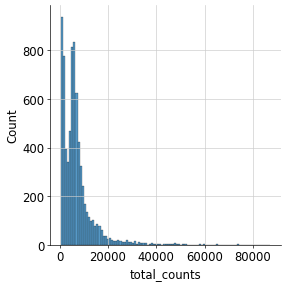

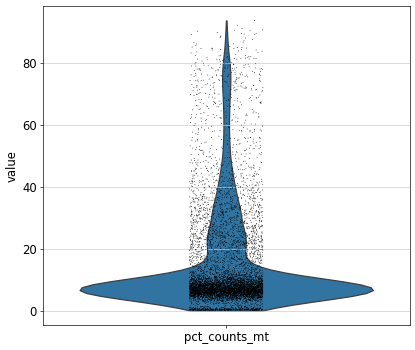

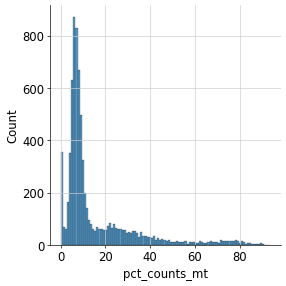

In [15]:
t1 = sns.displot(adata_gex.obs['total_counts'], bins=100, kde=False)
t2 = sc.pl.violin(adata_gex, 'pct_counts_mt')
t3 = sns.displot(adata_gex.obs['pct_counts_mt'], bins=100, kde=False)
plt.show()

There is a considerable fraction of cells with 20% and mroe MT-read fraction. Permissive filtering around 38 %, more strict filtering around 20%

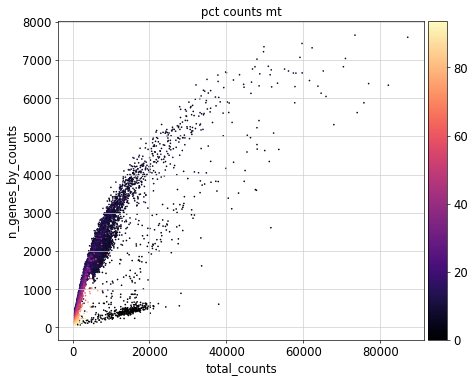

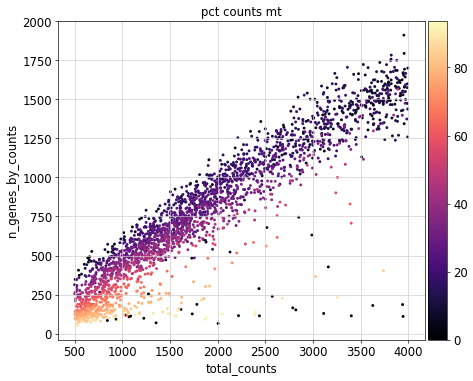

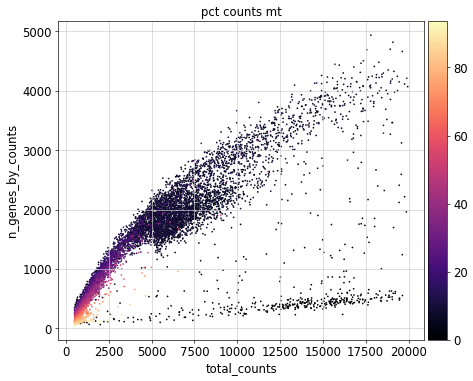

In [16]:
#Data quality summary plots
p1 = sc.pl.scatter(adata_gex, 'total_counts', 'n_genes_by_counts',
                   color='pct_counts_mt',color_map='magma')
p2 = sc.pl.scatter(adata_gex[adata_gex.obs['total_counts']<4000], 'total_counts', 'n_genes_by_counts',
                   color='pct_counts_mt', color_map='magma')
p3 = sc.pl.scatter(adata_gex[adata_gex.obs['total_counts']<20000], 'total_counts', 'n_genes_by_counts',
                   color='pct_counts_mt', color_map='magma')

Bad quality cells show very high mito fraction.

Tried out permissive mt threshold of 38% first, but that resulted in low quality clusters, so threshold of 20% should be chosen in this case.

/srv/conda/envs/saturn/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


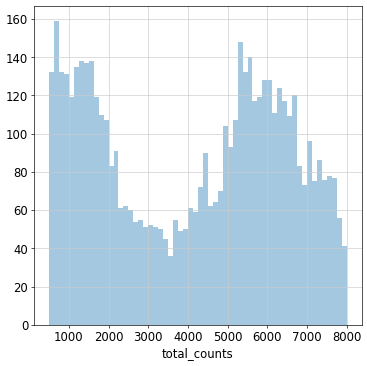

/srv/conda/envs/saturn/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


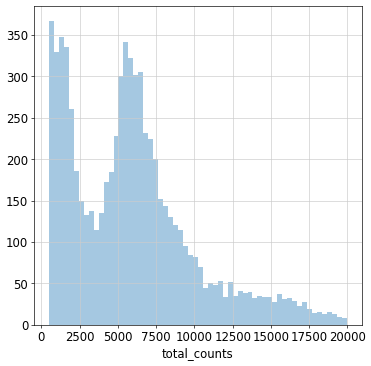

/srv/conda/envs/saturn/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


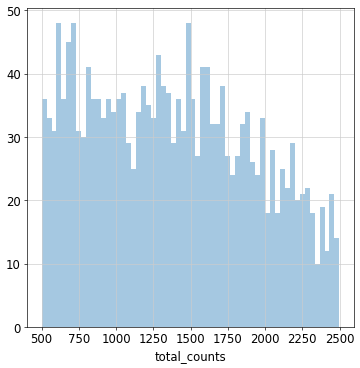

/srv/conda/envs/saturn/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


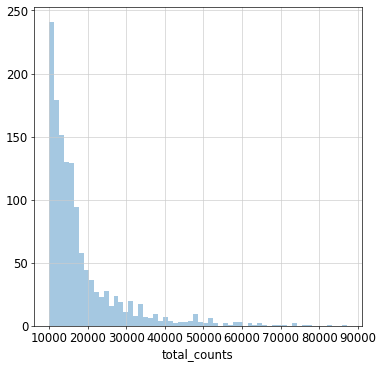

/srv/conda/envs/saturn/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


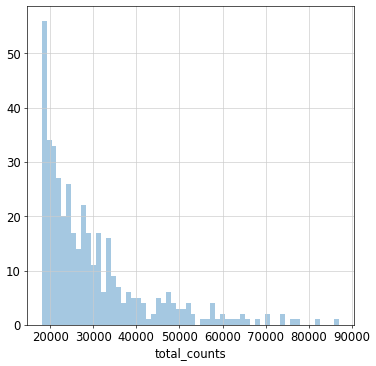

In [17]:
#Thresholding decision: counts
# Here we check the univariate distributions for low-quality outlier peaks. We especially zoom in on lower values
p3_1 = sns.distplot(adata_gex.obs['total_counts'][adata_gex.obs['total_counts']<8000], kde=False, bins=60)
plt.show()

p3_2 = sns.distplot(adata_gex.obs['total_counts'][adata_gex.obs['total_counts']<20000], kde=False, bins=60)
plt.show()

p4 = sns.distplot(adata_gex.obs['total_counts'][adata_gex.obs['total_counts']<2500], kde=False, bins=60)
plt.show()

p5 = sns.distplot(adata_gex.obs['total_counts'][adata_gex.obs['total_counts']>10000], kde=False, bins=60)
plt.show()

p6 = sns.distplot(adata_gex.obs['total_counts'][adata_gex.obs['total_counts']>18000], kde=False, bins=60)
plt.show()

Thresholding options:

Lower bound:
- 750 -> use this
- 1100 

Upper bound:
- 32000 -> go for this
- 35000 
- 43000
- 53000

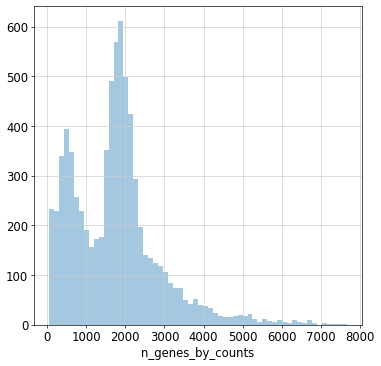

/srv/conda/envs/saturn/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


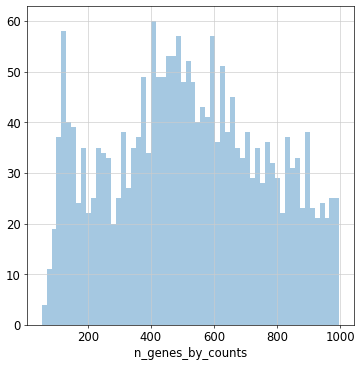

In [18]:
#Thresholding decision: genes
p7 = sns.distplot(adata_gex.obs['n_genes_by_counts'], kde=False, bins=60)
plt.show()

p8 = sns.distplot(adata_gex.obs['n_genes_by_counts'][adata_gex.obs['n_genes_by_counts']<1000], kde=False, bins=60)
plt.show()


Gene thresholding options:
- 200
- 270 -> try this first

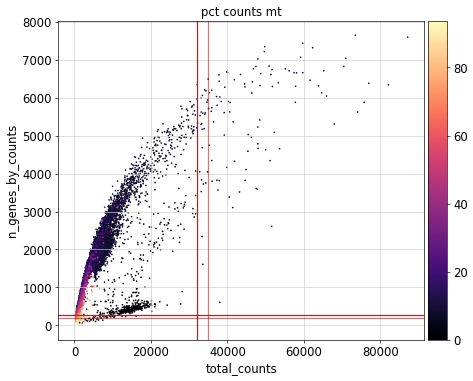

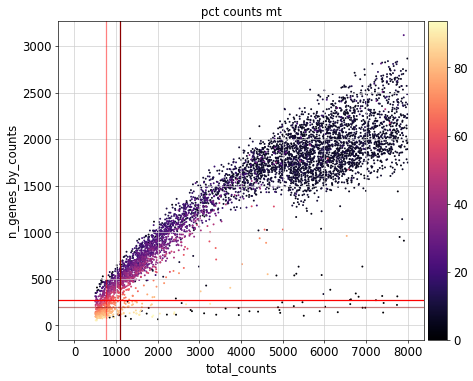

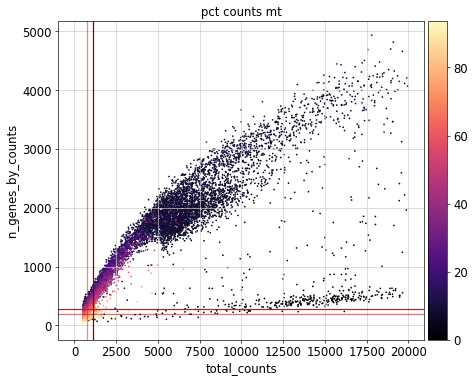

In [19]:
# Visualize the chosen thresholds jointly, before filtering out cells
counts_upper = 32000
counts_upper_alt = 35000
counts_lower = 750
counts_lower_alt = 1100
genes_lower = 270
genes_lower_alt = 200

# Upper count thresholds
p9 = sc.pl.scatter(adata_gex, 'total_counts', 'n_genes_by_counts', color='pct_counts_mt',
                   show=False, color_map='magma')
p9.axline((counts_upper,0),(counts_upper,1), color='red')
p9.axline((counts_upper_alt,0),(counts_upper_alt,1), color='darkred', alpha=0.5)
p9.axline((0,genes_lower),(1,genes_lower), color='red')
p9.axline((0,genes_lower_alt),(1,genes_lower_alt), color='darkred', alpha=0.5)
plt.show()

# lower count thresholds
count_lim = 8000
p10 = sc.pl.scatter(adata_gex[adata_gex.obs['total_counts']<count_lim], 'total_counts', 'n_genes_by_counts',
                    color='pct_counts_mt', show=False, color_map='magma')
p10.axline((counts_lower,0),(counts_lower,1), color='red', alpha=0.5)
p10.axline((counts_lower_alt,0),(counts_lower_alt,1), color='darkred')
p10.axline((0,genes_lower),(1,genes_lower), color='red')
p10.axline((0,genes_lower_alt),(1,genes_lower_alt), color='darkred', alpha=0.5)
plt.show()

count_lim = 20000
p10 = sc.pl.scatter(adata_gex[adata_gex.obs['total_counts']<count_lim], 'total_counts', 'n_genes_by_counts',
                    color='pct_counts_mt', show=False, color_map='magma')
p10.axline((counts_lower,0),(counts_lower,1), color='red', alpha=0.5)
p10.axline((counts_lower_alt,0),(counts_lower_alt,1), color='darkred')
p10.axline((0,genes_lower),(1,genes_lower), color='red')
p10.axline((0,genes_lower_alt),(1,genes_lower_alt), color='darkred', alpha=0.5)
plt.show()

Final thresholding decisions:
- Counts lower: 750 (1100 prob better, check low count clusters)
- Counts upper: 32000
- Genes: 270 (removes high mt frac cells, but keeps cell cluster with low mt frac)
- MT threshold: 20%

These thresholds were chosen to remove most higher MT fraction cells with low count and number of genes. Using a less permissive upper count threshold is fine, as these cells are often challenging to annotate and might be doublets. 

In [20]:
# Filter cells according to identified QC thresholds:
print('Total number of cells: {:d}'.format(adata_gex.n_obs))

sc.pp.filter_cells(adata_gex, min_counts = 750)
print('Number of cells after min count filter: {:d}'.format(adata_gex.n_obs))

sc.pp.filter_cells(adata_gex, max_counts = 32000)
print('Number of cells after max count filter: {:d}'.format(adata_gex.n_obs))

sc.pp.filter_cells(adata_gex, min_genes = 270)
print('Number of cells after gene filter: {:d}'.format(adata_gex.n_obs))

adata_gex = adata_gex[adata_gex.obs.pct_counts_mt < 20,:]
print('Number of cells after MT frac filter: {:d}'.format(adata_gex.n_obs))

Total number of cells: 7522
Number of cells after min count filter: 7231
Number of cells after max count filter: 7113
Number of cells after gene filter: 6925
Number of cells after MT frac filter: 5519


In [21]:
#Filter genes:
print('Total number of genes: {:d}'.format(adata_gex.n_vars))

# Min 20 cells - filters out 0 count genes
sc.pp.filter_genes(adata_gex, min_cells=20)
print('Number of genes after cell filter: {:d}'.format(adata_gex.n_vars))

Total number of genes: 36601


Trying to set attribute `.var` of view, copying.


Number of genes after cell filter: 15508


# Normalization

In [22]:
#Perform a clustering for scran normalization in clusters
adata_pp = adata_gex.copy()
sc.pp.normalize_per_cell(adata_pp, counts_per_cell_after=1e6)
sc.pp.log1p(adata_pp)
sc.pp.pca(adata_pp, n_comps=15)
sc.pp.neighbors(adata_pp)
sc.tl.leiden(adata_pp, key_added='groups', resolution=0.5)

In [23]:
#Preprocess variables for scran normalization
input_groups = adata_pp.obs['groups']
data_mat = adata_gex.X.T.A

In [24]:
%%R -i data_mat -i input_groups -o size_factors

size_factors = sizeFactors(computeSumFactors(SingleCellExperiment(list(counts=data_mat)), clusters=input_groups, min.mean=0.1))

In [25]:
#Delete adata_pp
del adata_pp

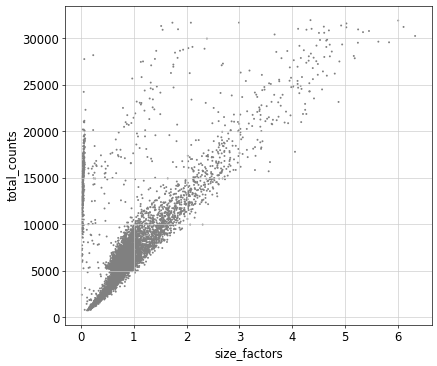

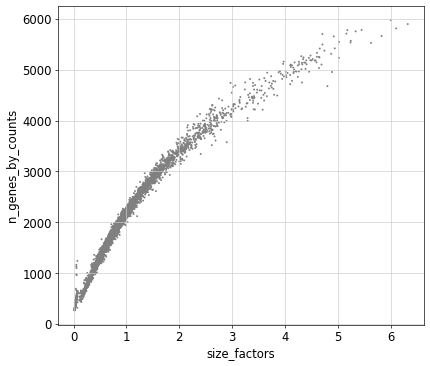

/srv/conda/envs/saturn/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


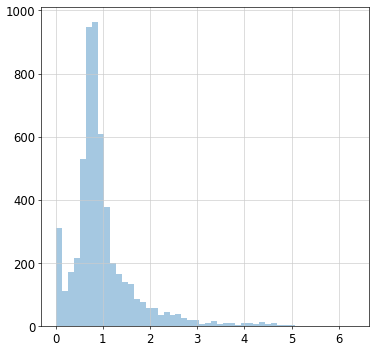

In [26]:
# Visualize the estimated size factors
adata_gex.obs['size_factors'] = size_factors

sc.pl.scatter(adata_gex, 'size_factors', 'total_counts')
sc.pl.scatter(adata_gex, 'size_factors', 'n_genes_by_counts')

sns.distplot(size_factors, bins=50, kde=False)
plt.show()

No size factors are below 0, and the range of size factors is manageable (not >10, and mostly <4)

In [27]:
#Keep the count data in a counts layer
adata_gex.layers["counts"] = adata_gex.X.copy()

#Normalize adata 
adata_gex.X /= adata_gex.obs['size_factors'].values[:,None]
sc.pp.log1p(adata_gex)

#Transform back into a sparse matrix
adata_gex.X = sp.sparse.csr_matrix(adata_gex.X)

#Store the full data set in 'raw' as log-normalised data for statistical testing
adata_gex.raw = adata_gex

# HVGs

In [28]:
sc.pp.highly_variable_genes(adata_gex, flavor='cell_ranger', n_top_genes=4000)
print('\n','Number of highly variable genes: {:d}'.format(np.sum(adata_gex.var['highly_variable'])))


 Number of highly variable genes: 4000


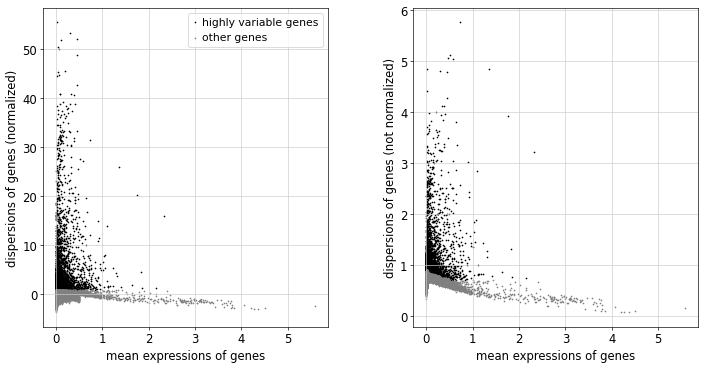

In [29]:
sc.pl.highly_variable_genes(adata_gex)

# Visualization

In [30]:
# Calculate the visualizations
sc.pp.pca(adata_gex, n_comps=50, use_highly_variable=True, svd_solver='arpack')
sc.pp.neighbors(adata_gex)
sc.tl.umap(adata_gex)

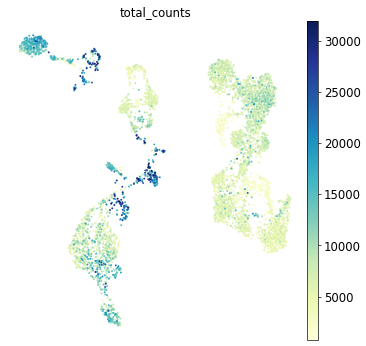

In [31]:
sc.pl.umap(adata_gex, color='total_counts')

We see a high count area aggregated in the middle and a low count cluster on the left of the UMAP... this can be problematic (doublets or low quality cells), that we will consider during the cluster annotation.

# CC scoring

In [32]:
# get file here: https://raw.githubusercontent.com/theislab/single-cell-tutorial/master/Macosko_cell_cycle_genes.txt
cc_genes_file = 'neurips2021-notebooks/notebooks/gene_lists/Macosko_cell_cycle_genes.txt'


In [33]:
#Score cell cycle and visualize the effect:
cc_genes = pd.read_table(cc_genes_file, delimiter='\t')
s_genes = cc_genes['S'].dropna()
g2m_genes = cc_genes['G2.M'].dropna()

s_genes_ens = adata_gex.var_names[np.in1d(adata_gex.var_names, s_genes)]
g2m_genes_ens = adata_gex.var_names[np.in1d(adata_gex.var_names, g2m_genes)]

sc.tl.score_genes_cell_cycle(adata_gex, s_genes=s_genes_ens, g2m_genes=g2m_genes_ens)

... storing 'phase' as categorical


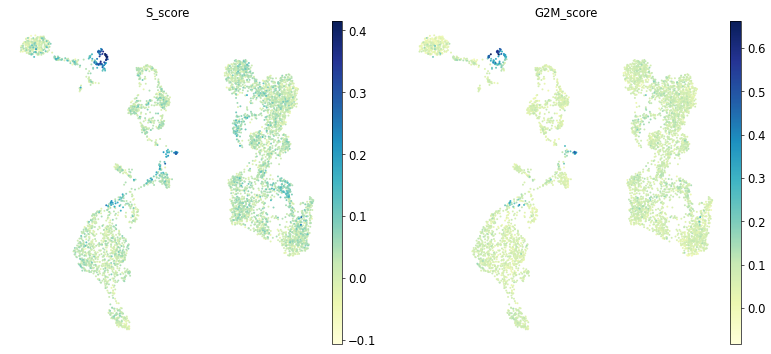

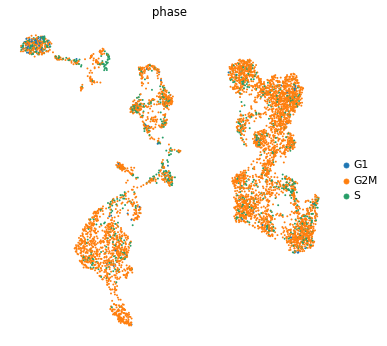

In [34]:
sc.pl.umap(adata_gex, color=['S_score', 'G2M_score'], use_raw=False)
sc.pl.umap(adata_gex, color='phase', use_raw=False)

There is 1 cluster with a clear cell cycle separation, this is likely cycling erythroblasts. This gives the first hint at where the erythrocyte differentiation trajectory is. Also interesting: Cycling cells have high counts (-> choosing hight max count threshold)

# Clustering

Let the fun begin! First step, cluster at several resolutions and select the resolution that broadly captures the structure you see in the UMAP. Try to avoid getting into detailed substructure already at this early stage.

In [35]:
sc.tl.leiden(adata_gex, resolution=0.3, key_added='leiden_res0.3')
sc.tl.leiden(adata_gex, resolution=0.5, key_added='leiden_res0.5')
sc.tl.leiden(adata_gex, resolution=0.8, key_added='leiden_res0.8')
sc.tl.leiden(adata_gex, resolution=1, key_added='leiden_res1')

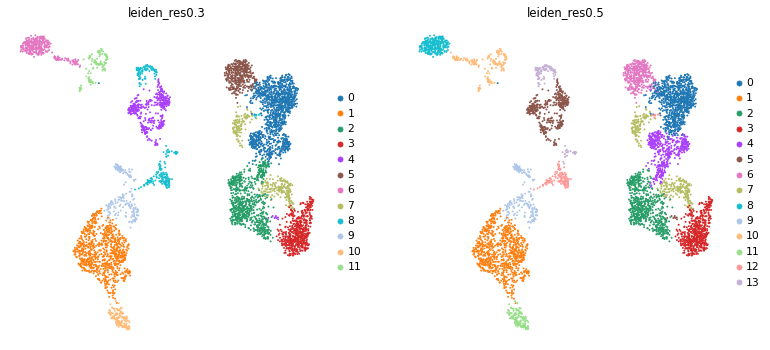

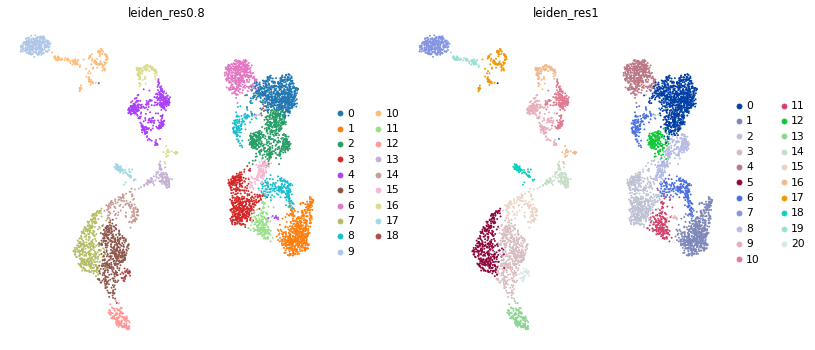

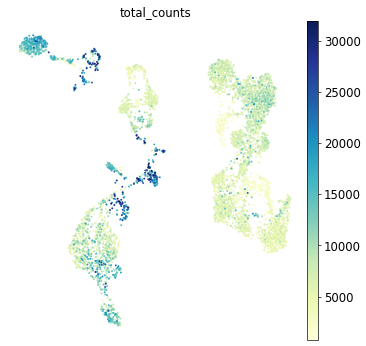

In [36]:
sc.pl.umap(adata_gex, color=['leiden_res0.3', 'leiden_res0.5'])
sc.pl.umap(adata_gex, color=['leiden_res0.8', 'leiden_res1'])
sc.pl.umap(adata_gex, color='total_counts')

Check which clusters have the problematic aggregation of high/low-count cells... these might be difficult to annotate and could be doublets low count cells.

# Doublet detection

Doublet detection to gain extra evidence for which cells are actually two separate cells that happen to be assigned to the same barcode (doublets).

In [37]:
test_dat = adata_gex.copy()
test_dat.X = adata_gex.raw.X

In [ ]:
sc.external.pp.scrublet(test_dat)

/srv/conda/envs/saturn/lib/python3.9/site-packages/scanpy/preprocessing/_normalization.py:138: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.29
Detected doublet rate = 1.6%
Estimated detectable doublet fraction = 57.6%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 2.8%


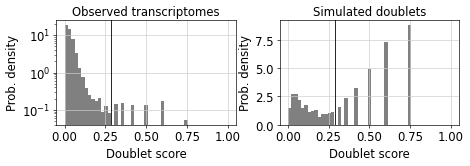

In [ ]:
sc.external.pl.scrublet_score_distribution(test_dat)
plt.show()

The distribution of simulated doublets show that potentially a score over 0.23 is already indicative of a doublet. Note that not all doublets will be detectable in this way and it will be more valuable to remove entire clusters based on these scores.

In [ ]:
adata_gex.obs['doublet_score'] = test_dat.obs['doublet_score']
adata_gex.obs['predicted_doublet'] = test_dat.obs['predicted_doublet'].astype(str)

In [ ]:
del test_dat

... storing 'predicted_doublet' as categorical


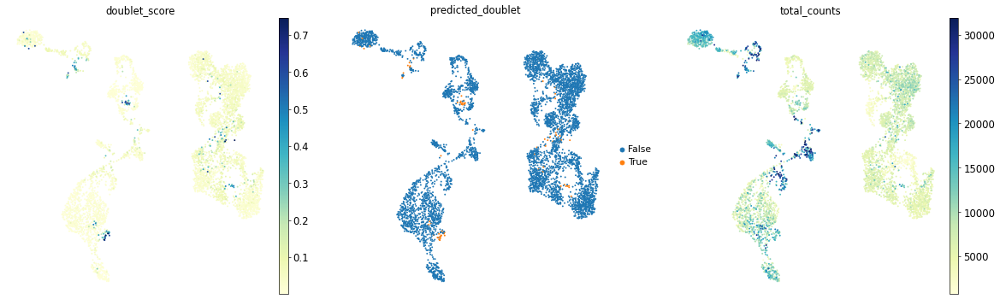

In [ ]:
sc.pl.umap(adata_gex, color=['doublet_score', 'predicted_doublet', 'total_counts'])

# Marker genes

In [211]:
marker_genes = {
    'CD14+ Mono': ['FCN1', 'CD14'],
    'CD16+ Mono': ['TCF7L2', 'FCGR3A', 'LYN'],
    'ID2-hi myeloid prog': ['CD14', 'ID2', 'VCAN', 'FOS', 'JUN', 'EGR1', 'KLF4', 'PLAUR'],
    'cDC1': ['CLEC9A', 'CADM1'],
    'cDC2': ['CLEC10A', 'FCER1A', 'CST3', 'COTL1', 'LYZ', 'DMXL2'], # Note: DMXL2 should be negative
    'Reticulocyte': ['SLC4A1', 'SLC25A37', 'HBB', 'HBA2', 'HBA1', 'TFRC'], # TFRC negative
    'Normoblast': ['SLC4A1', 'SLC25A37', 'HBB', 'HBA2', 'HBA1', 'TFRC'],  # TFRC positive
    'Erythroblast': ['MKI67', 'HBA1', 'HBB'],
    'Proerythroblast': ['CDK6', 'SYNGR1', 'HBM', 'GYPA'], # Note HBM and GYPA are negative markers   # CRACD as well, but not present in data
    'NK': ['GNLY', 'NKG7', 'CD247', 'FCER1G', 'TYROBP', 'KLRG1', 'FCGR3A'], # GRIK4 as well, but not present in data
    'ILC': ['ID2', 'PLCG2', 'GNLY', 'SYNE1'],
    'Lymph prog': ['IGLL1', 'VPREB1', 'MME', 'EBF1', 'SSBP2', 'BACH2', 'CD79B', 'IGHM', 'PAX5', 'PRKCE', 'DNTT'],  # new: STMN1
    'Naive CD20+ B - IGKC+':['MS4A1', 'IL4R', 'IGHD', 'FCRL1', 'IGHM', 'IGKC'],
    'Naive CD20+ B - IGKC-':['MS4A1', 'IL4R', 'IGHD', 'FCRL1', 'IGHM', 'IGKC'], # IGKC negative
    'B1 B - IGKC+':['MS4A1', 'SSPN', 'ITGB1','IGKC', 'EPHA4', 'COL4A4', 'PRDM1', 'IRF4', 'CD38', 'XBP1', 'PAX5', 'BCL11A', 'BLK', 'IGHD', 'IGHM'],# Note IGHD and IGHM are negative markers #ZNF215 not in data
    'B1 B - IGKC-':['MS4A1', 'SSPN', 'ITGB1', 'EPHA4', 'COL4A4', 'PRDM1', 'IRF4', 'CD38', 'XBP1', 'PAX5', 'BCL11A', 'BLK', 'IGHD', 'IGHM', 'IGKC'],# Note IGKC, IGHD and IGHM are negative markers #ZNF215 not in data
    'Transitional B': ['MME', 'CD38', 'CD24', 'ACSM3', 'MSI2'],
    'Plasma cell': ['MZB1', 'HSP90B1', 'FNDC3B', 'PRDM1', 'IGKC', 'JCHAIN'],
    'Plasmablast': ['XBP1', 'PRDM1', 'PAX5'],  # Note PAX5 is a negative marker   # RF4 as well, but not present in data
    'CD4+ T activated': ['CD4', 'IL7R', 'TRBC2', 'ITGB1'],
    'CD4+ T naive': ['CD4', 'IL7R', 'TRBC2', 'CCR7'],
    'CD8+ T': ['CD8A', 'CD8B', 'GZMB', 'GZMA', 'CCL5', 'GZMK', 'GZMH', 'GZMA'],
    'T activation': ['CD69', 'CD38'], # CD69 much better marker!
    'T naive': ['LEF1', 'CCR7', 'TCF7'],
    'T reg': ['FOXP3'],
    'Effector CD4+ T': ['KLRB1', 'CD4', 'PDCD1', 'TNF'],
    'Effector CD8+ T': ['KLRK1', 'GZMH', 'CD8A', 'CD8B'],
    'MAIT': ['KLRB1', 'CD8A', 'GZMK', 'IL7R'],
    'gdT': ['KLRC2', 'KLRF1', 'FCGR3A', 'GZMB', 'GZMH'],
    'pDC': ['GZMB', 'IL3RA', 'COBLL1', 'TCF4'],
    'G/M prog': ['MPO', 'BCL2', 'KCNQ5', 'CSF3R', 'PRTN3'], 
    'HSC': ['NRIP1', 'MECOM', 'PROM1', 'CD34', 'NKAIN2'], 
    'MK/E prog': ['ZNF385D', 'ITGA2B', 'PLCB1'], # 'RYR3' as well,  but not present in data
}


In [44]:
sc.tl.rank_genes_groups(adata_gex, groupby='leiden_res1', key_added='rank_genes_res1')

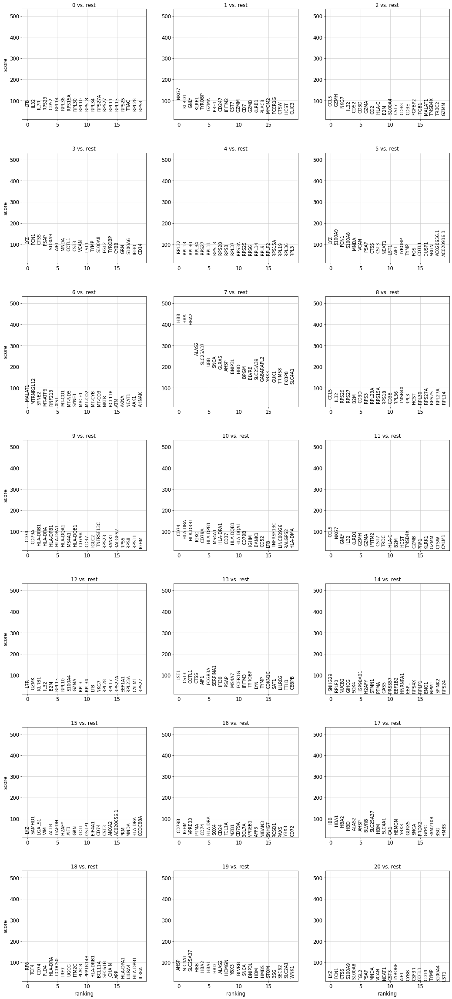

In [45]:
sc.pl.rank_genes_groups(adata_gex, key='rank_genes_res1', ncols=3, fontsize=12)

## Literature markers

In [46]:
from matplotlib import colors

#Define a nice colour map for gene expression
colors2 = plt.cm.Reds(np.linspace(0, 1, 128))
colors3 = plt.cm.Greys_r(np.linspace(0.7,0.8,3))
colorsComb = np.vstack([colors3, colors2])
mymap = colors.LinearSegmentedColormap.from_list('my_colormap', colorsComb)

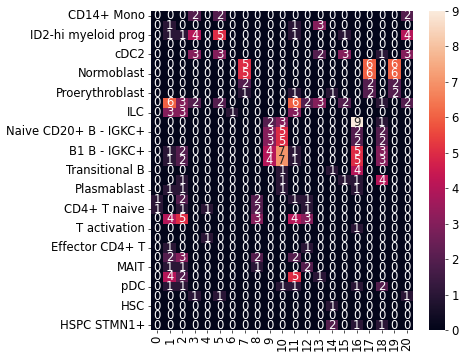

In [47]:
sns.heatmap(sc.tl.marker_gene_overlap(adata_gex, reference_markers=marker_genes, key='rank_genes_res1'), annot=True)
plt.show()

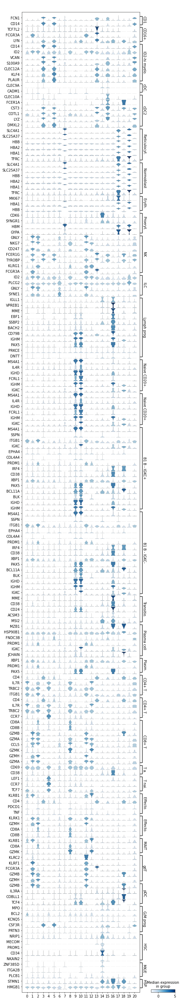

In [48]:
# Look at the marker genes in a concise manner
filt_marker_genes = dict()
for key,val in marker_genes.items():
    filt_vals = [i for i in val if i in adata_gex.var_names]
    filt_marker_genes[key] = filt_vals

adata_plot = adata_gex.copy()
sc.pp.scale(adata_plot, max_value=5)
    
sc.pl.stacked_violin(adata_plot, var_names = filt_marker_genes, groupby='leiden_res1', use_raw=False, swap_axes=True)

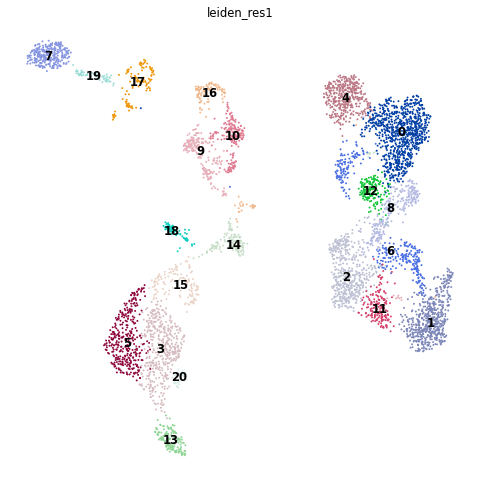

In [49]:
with plt.rc_context({'figure.figsize': (10, 10)}):
    sc.pl.umap(adata_gex, color='leiden_res1', legend_loc = 'on data')

Cluster: CD14+ Mono


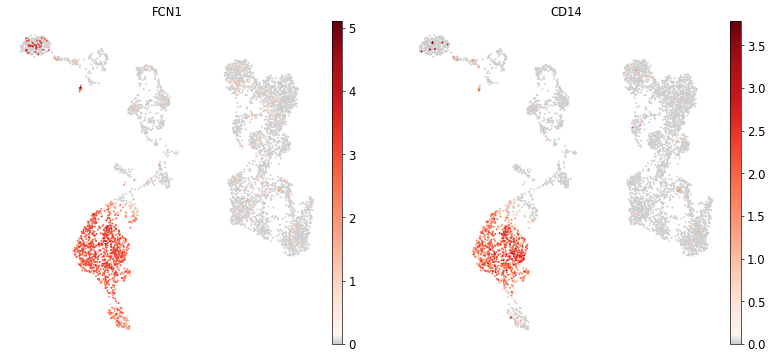

Cluster: CD16+ Mono


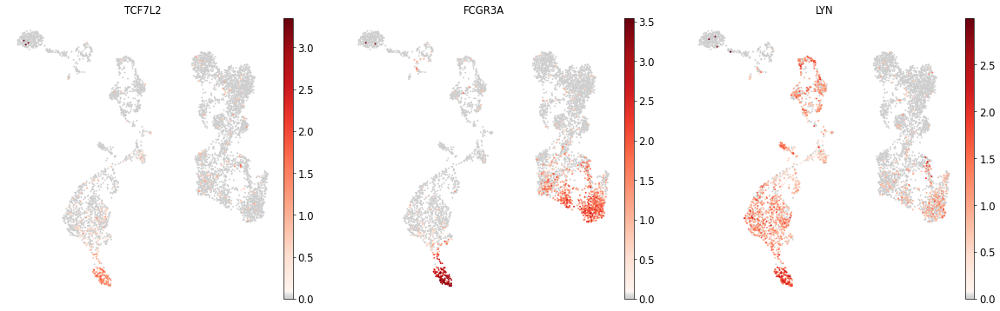

Cluster: ID2-hi myeloid prog


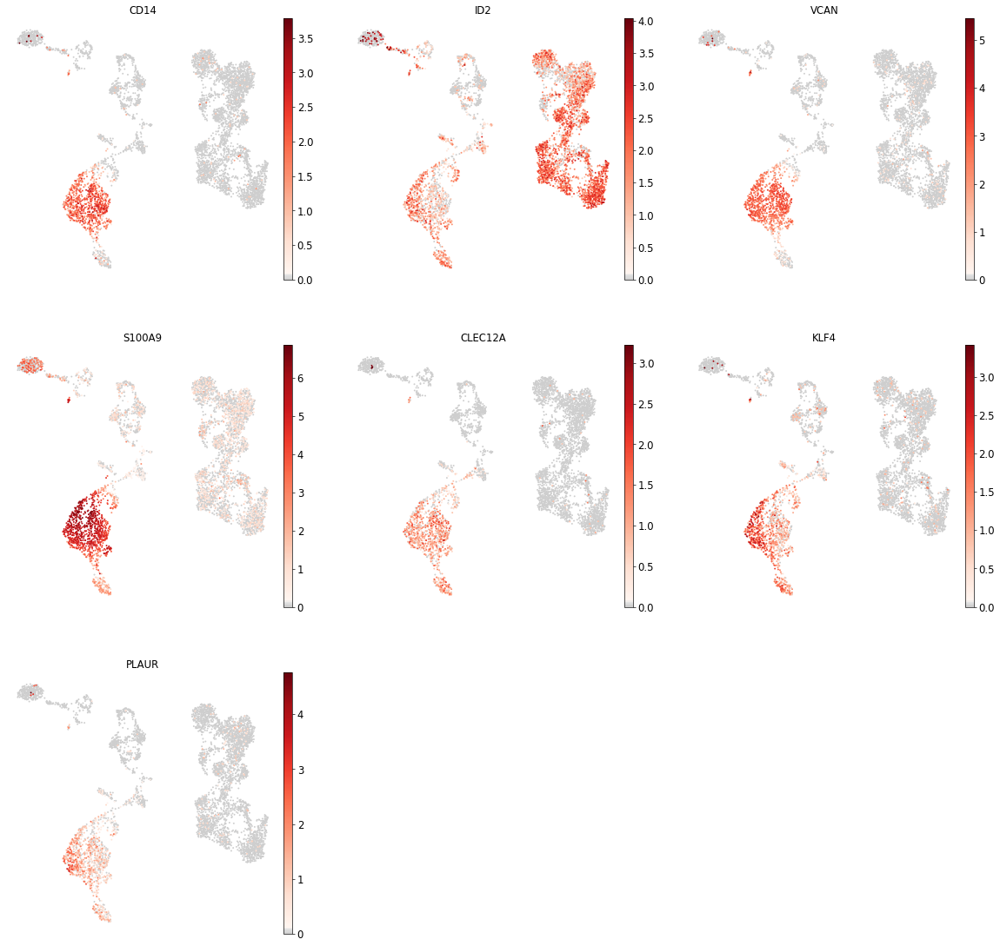

Cluster: cDC1


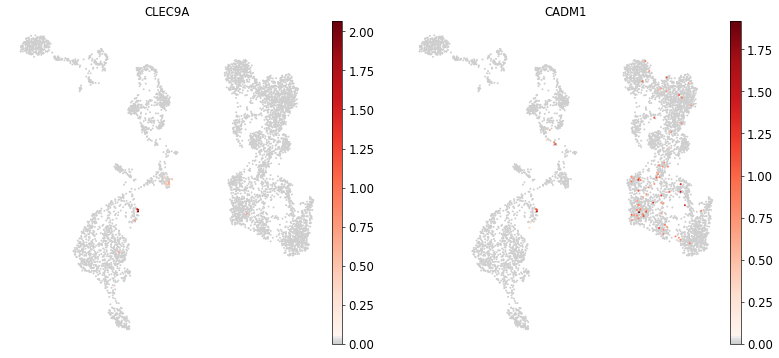

Cluster: cDC2


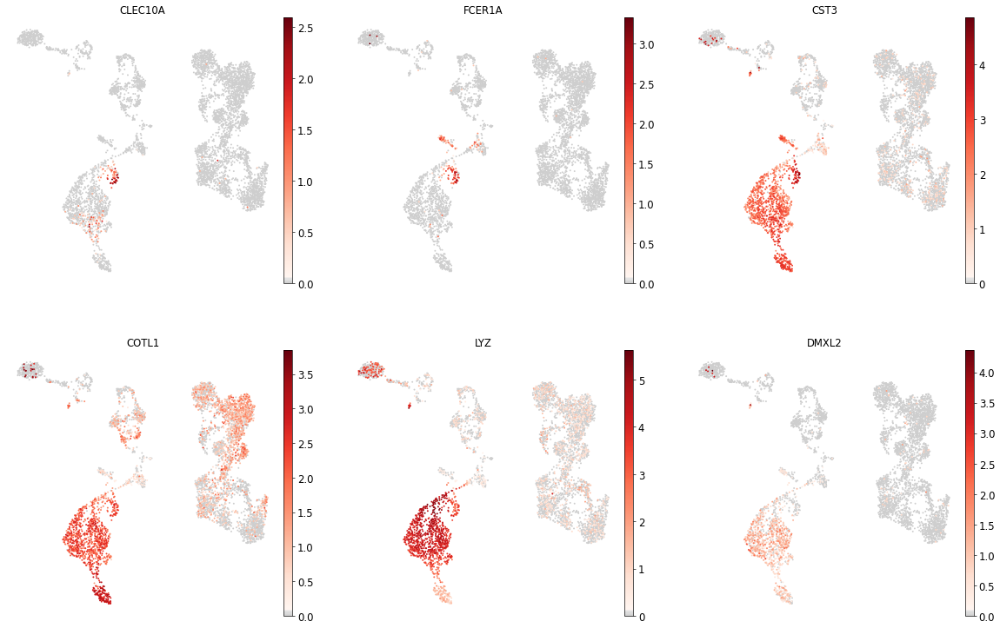

Cluster: Reticulocyte


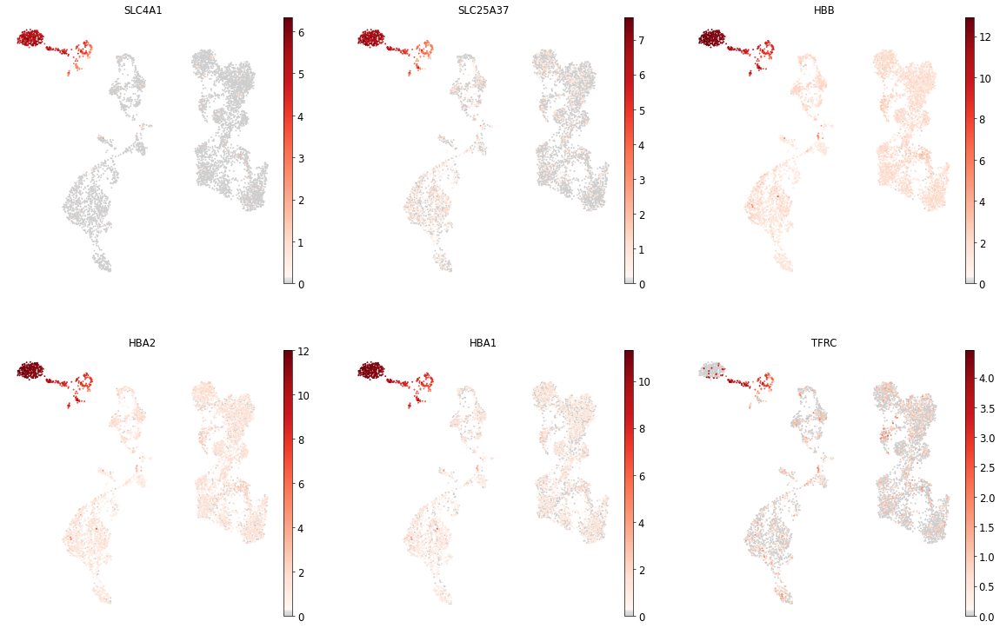

Cluster: Normoblast


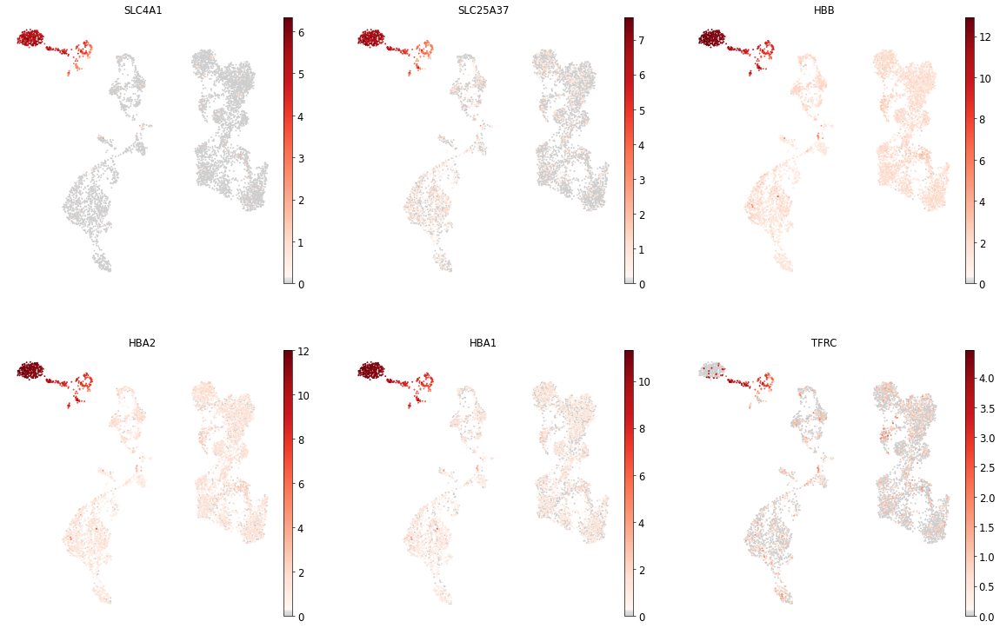

Cluster: Erythroblast


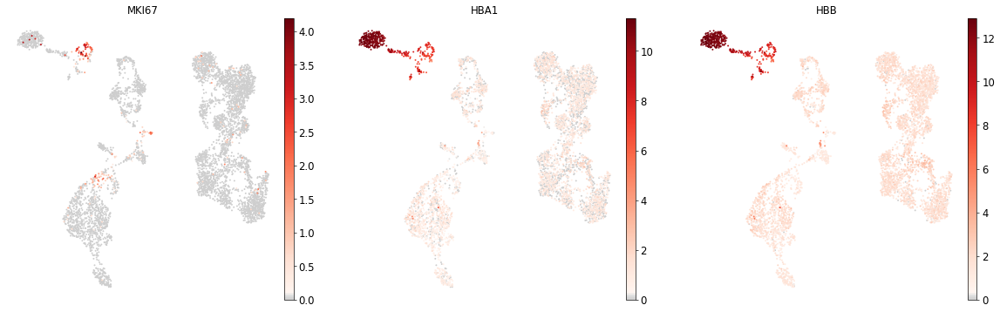

Cluster: Proerythroblast


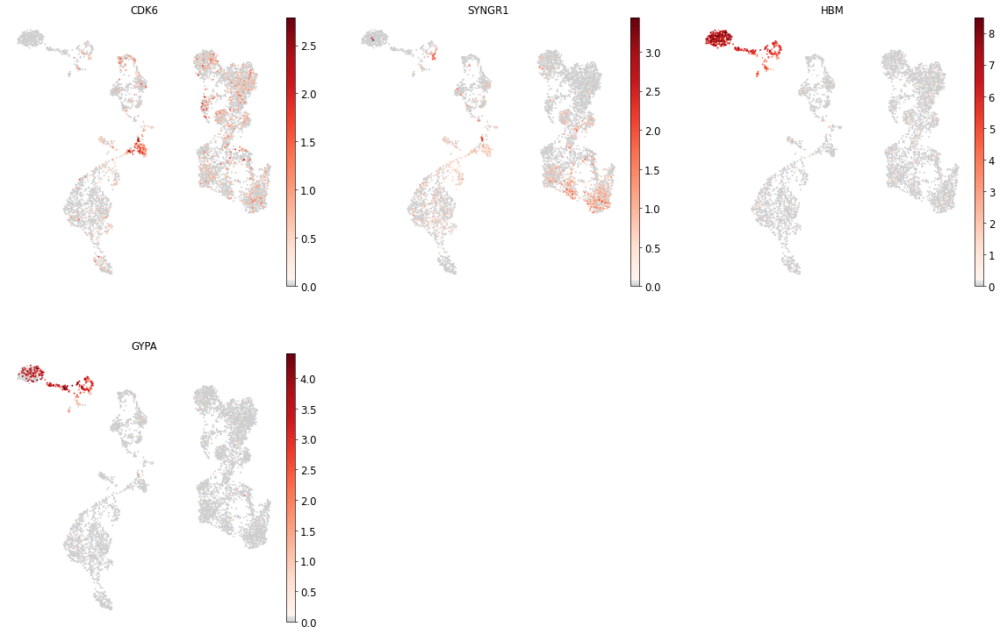

Cluster: NK


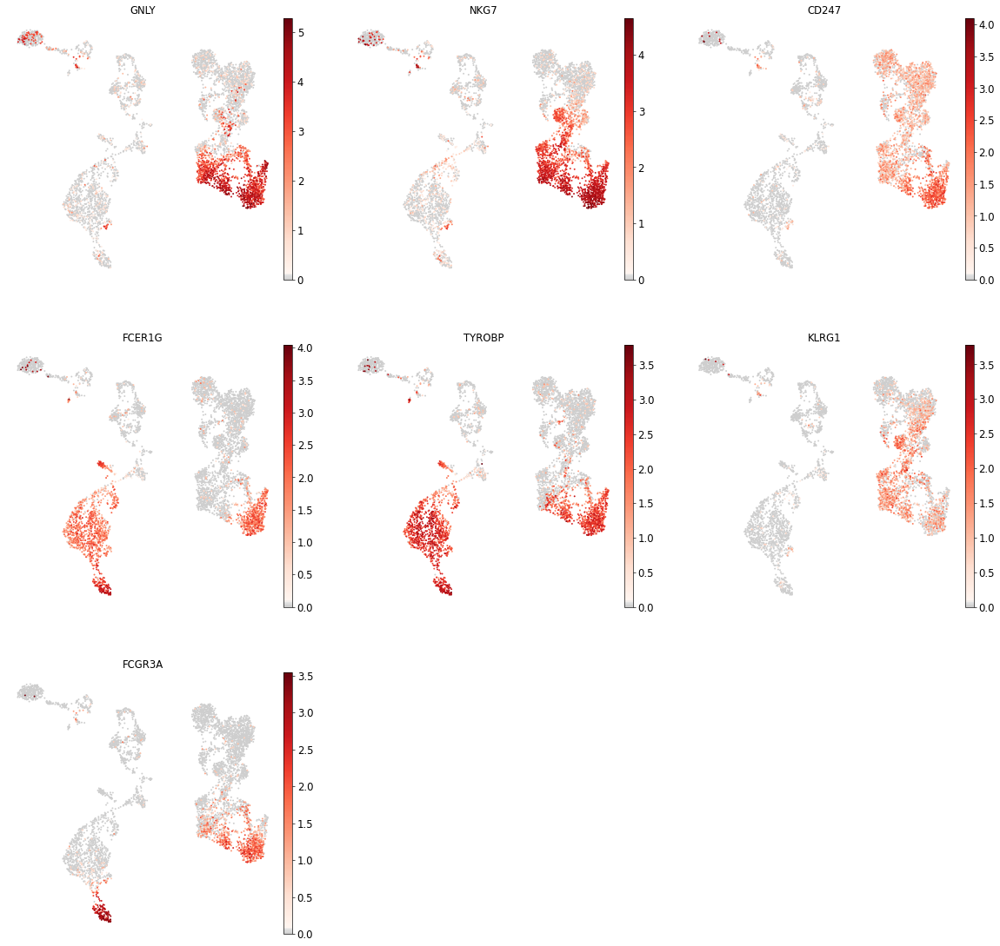

Cluster: ILC


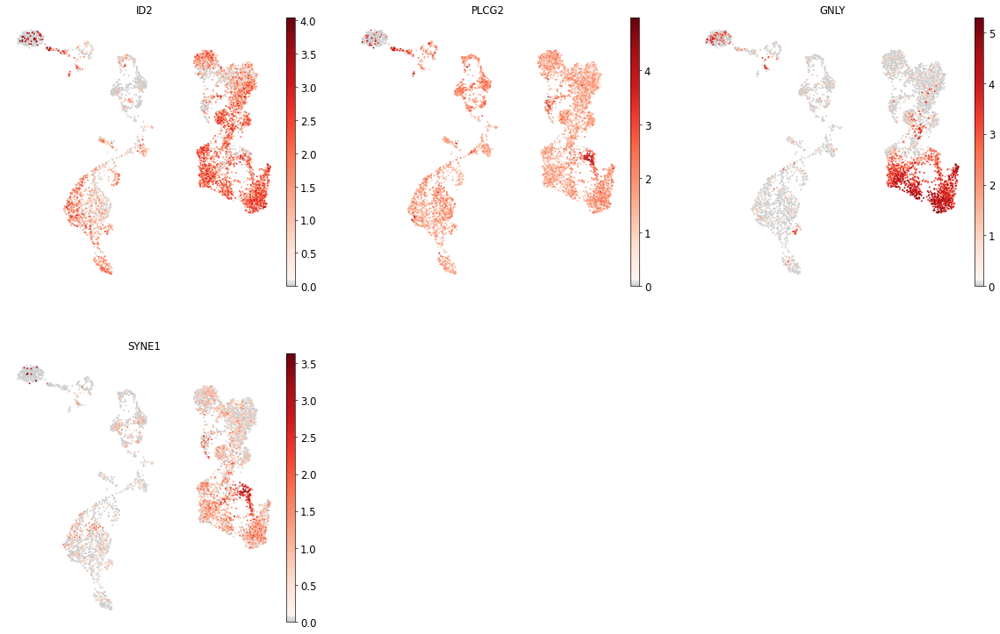

Cluster: Lymph prog


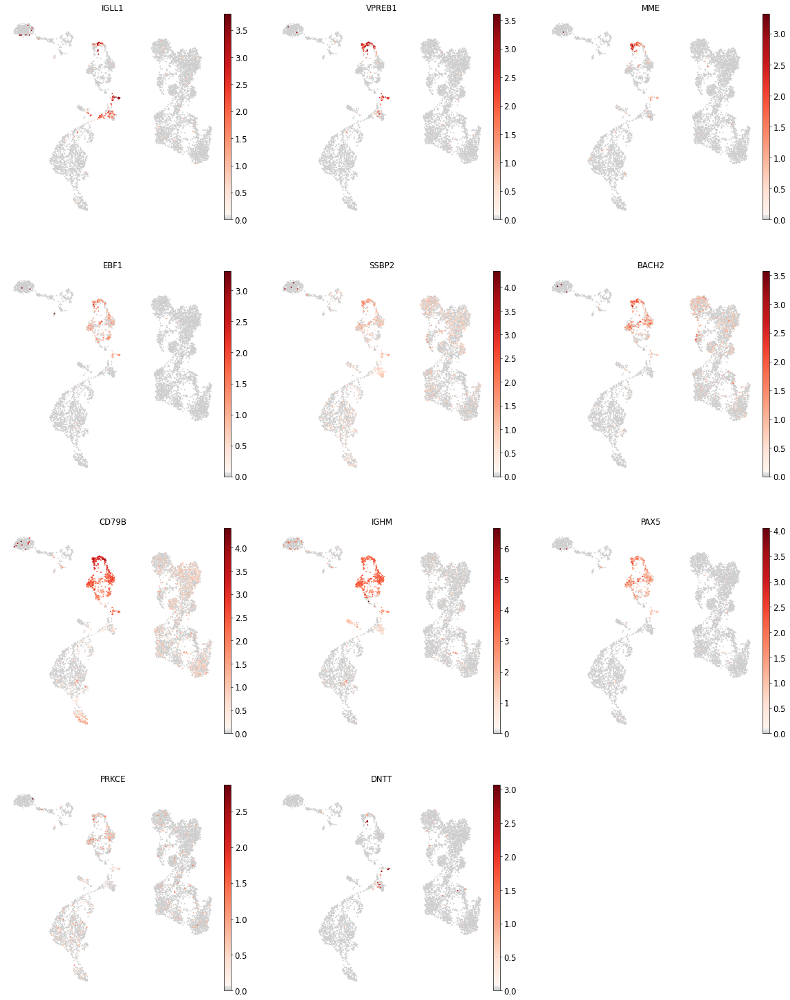

Cluster: Naive CD20+ B - IGKC+


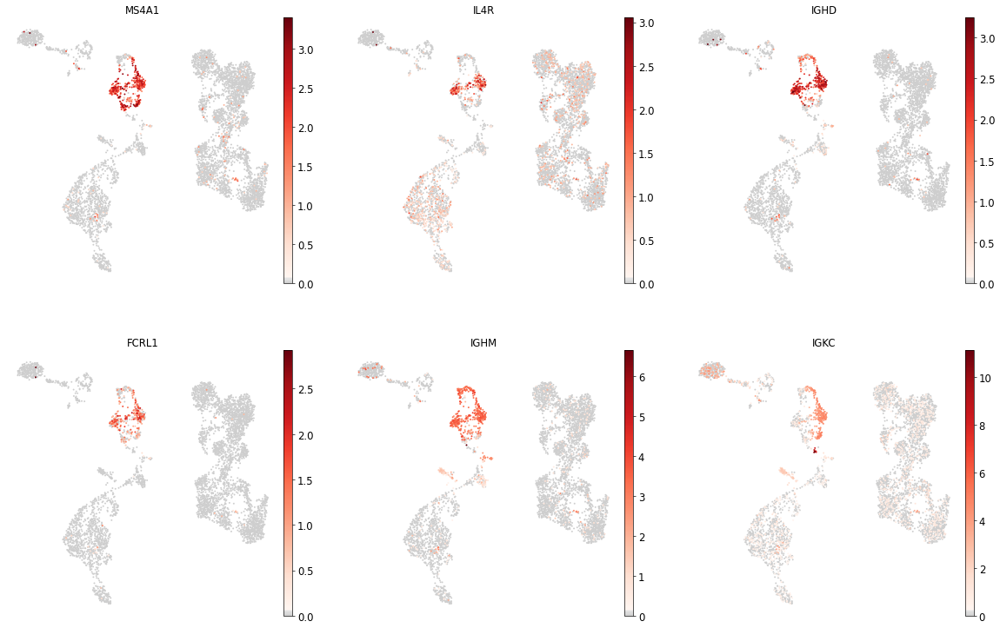

Cluster: Naive CD20+ B - IGKC-


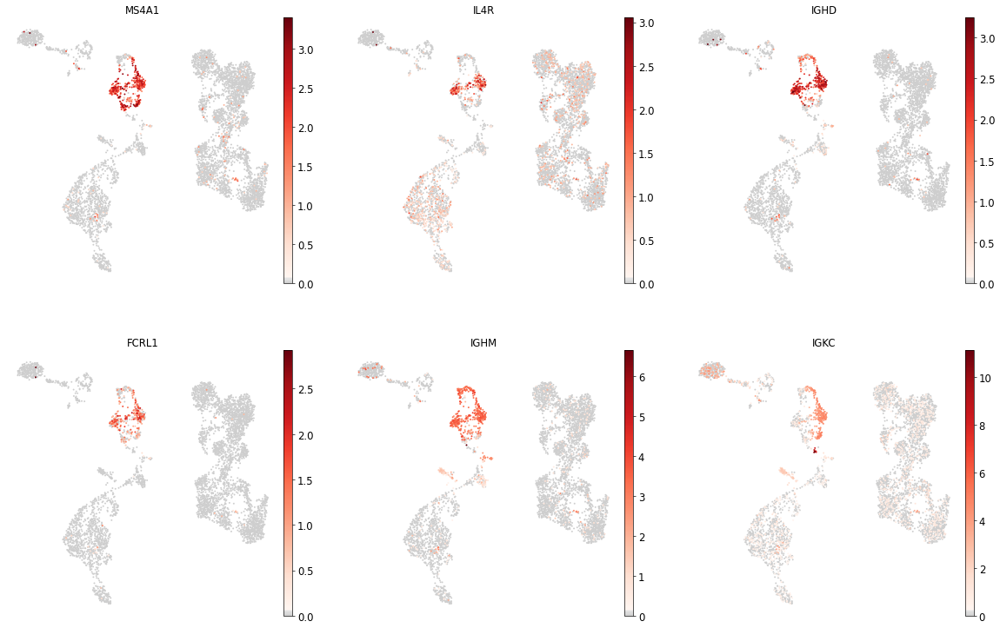

Cluster: B1 B - IGKC+


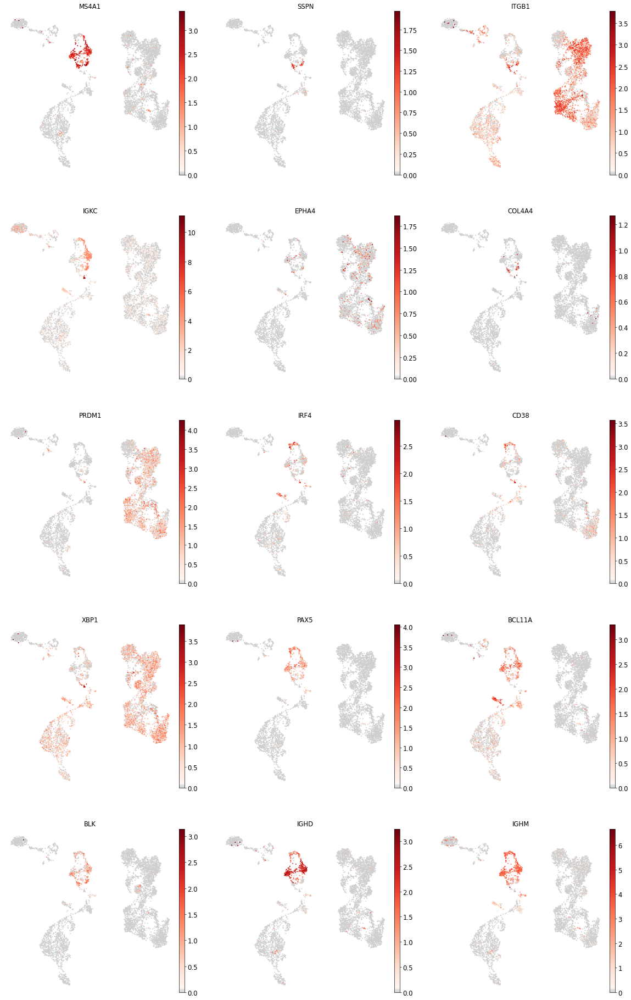

Cluster: B1 B - IGKC-


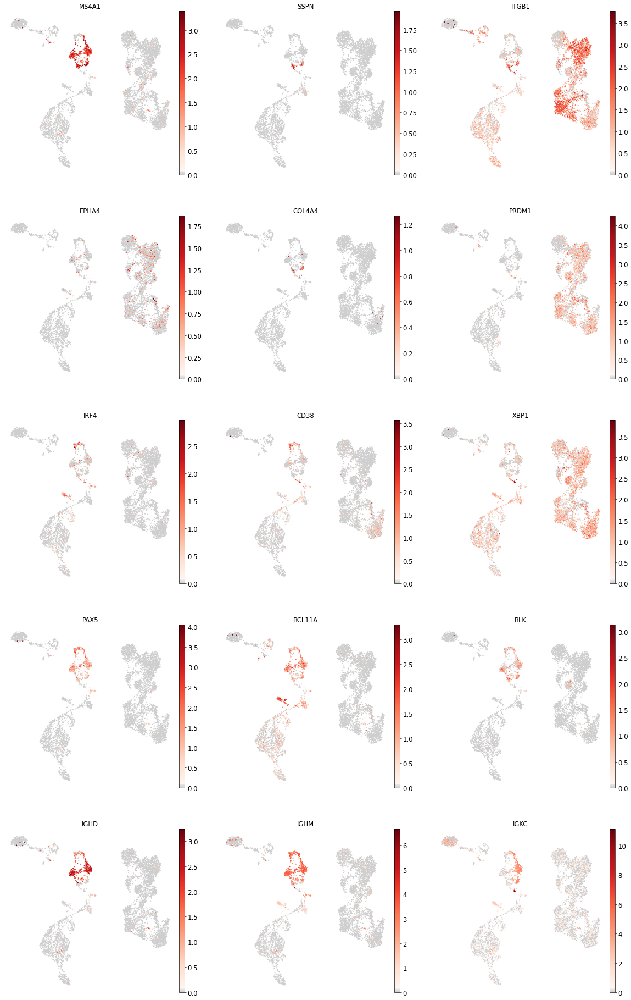

Cluster: Transitional B


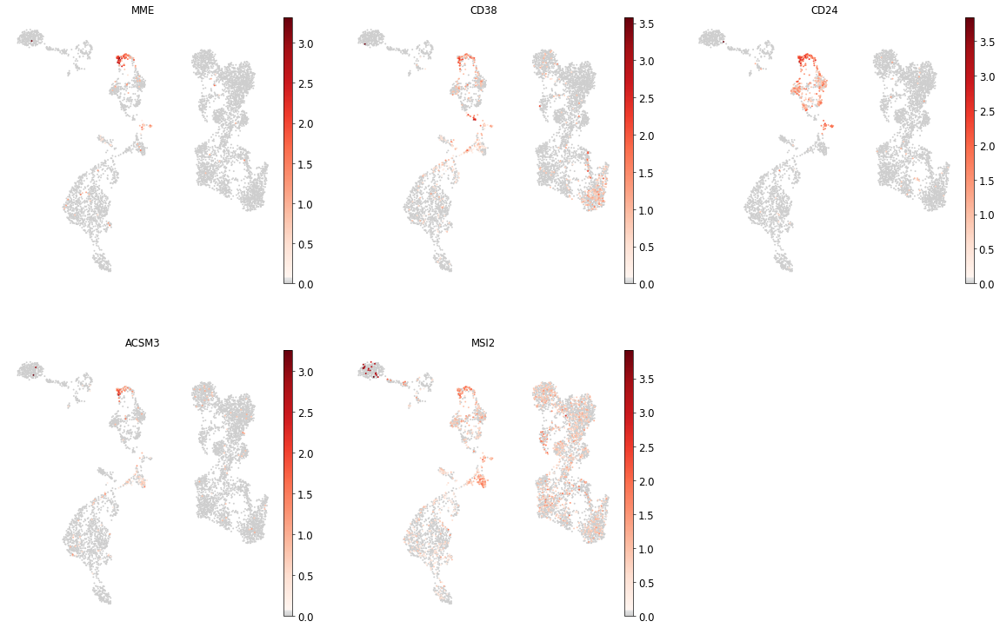

Cluster: Plasma cell


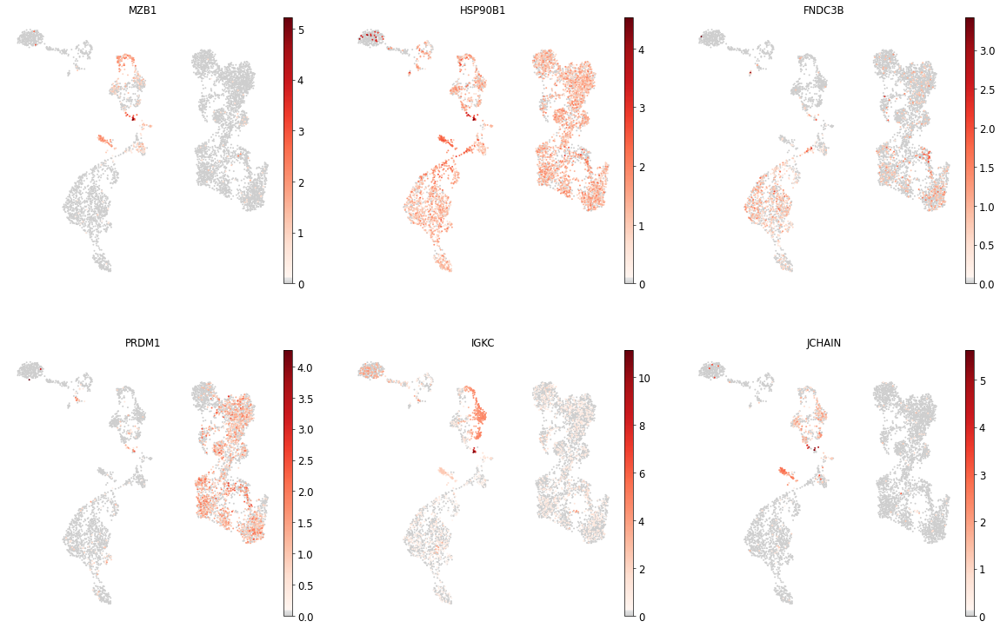

Cluster: Plasmablast


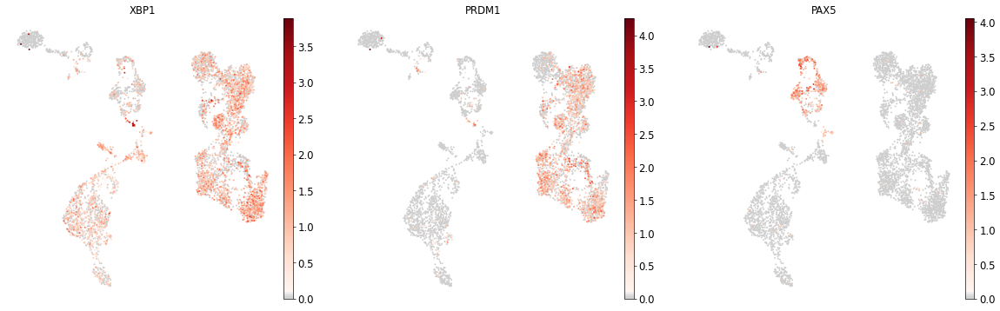

Cluster: CD4+ T activated


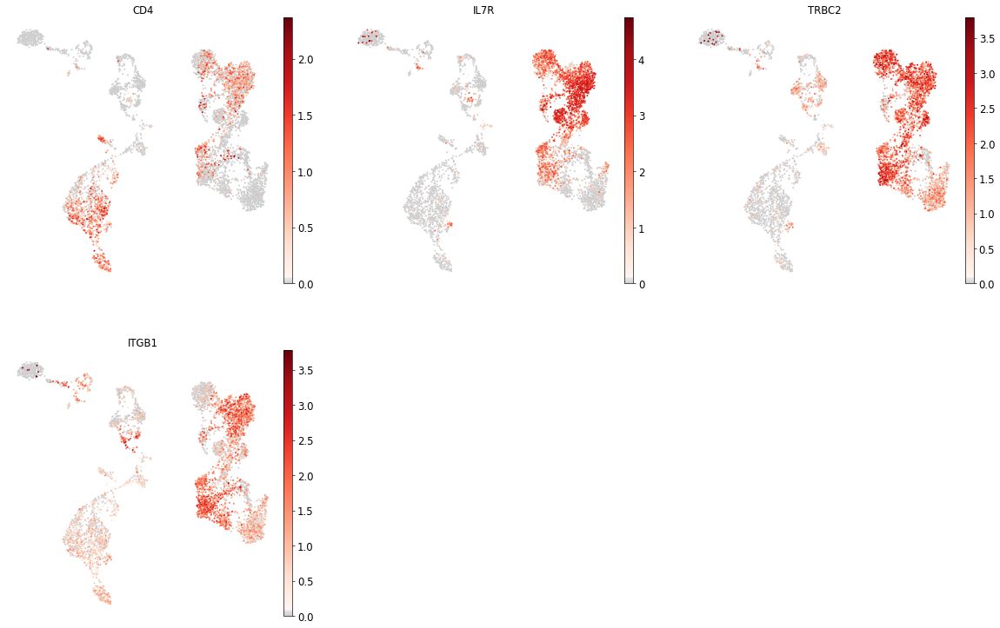

Cluster: CD4+ T naive


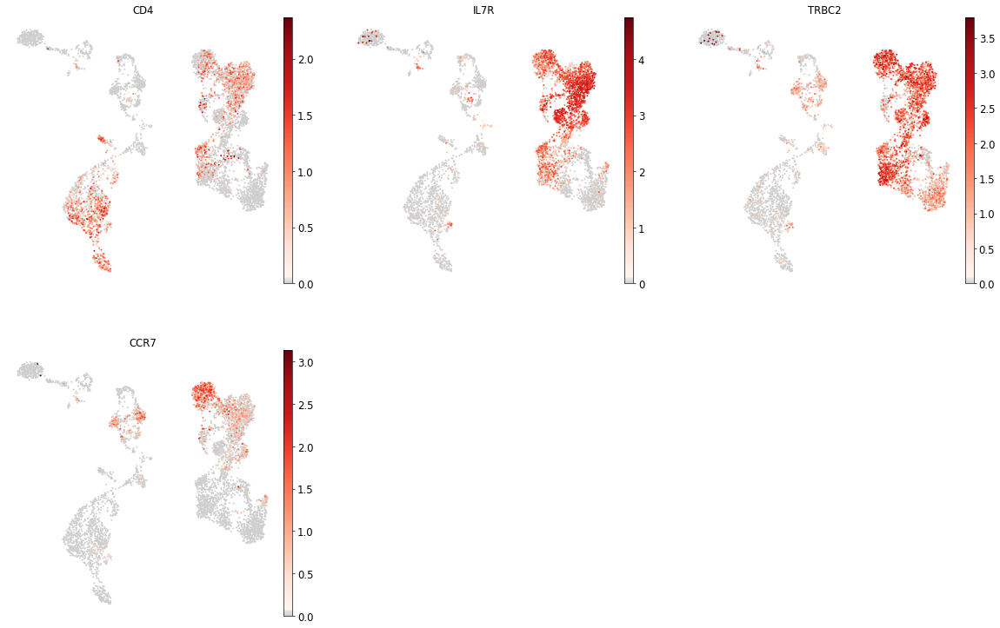

Cluster: CD8+ T


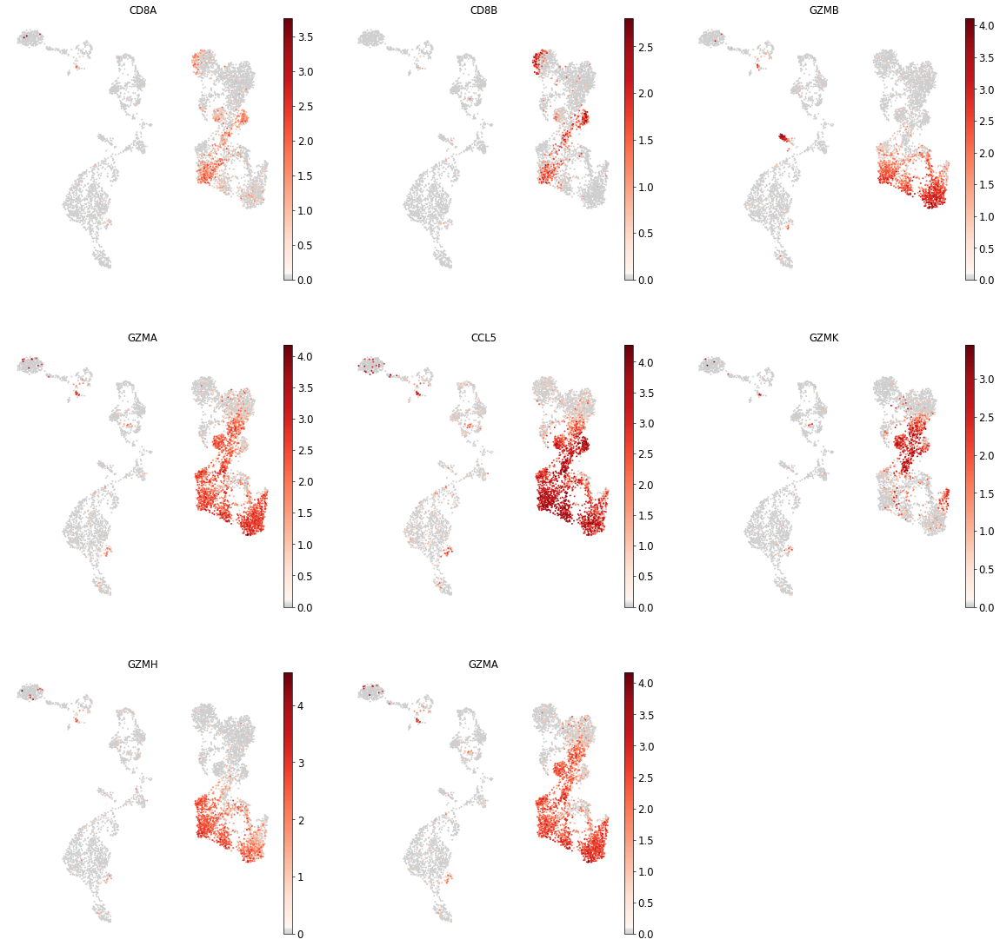

Cluster: T activation


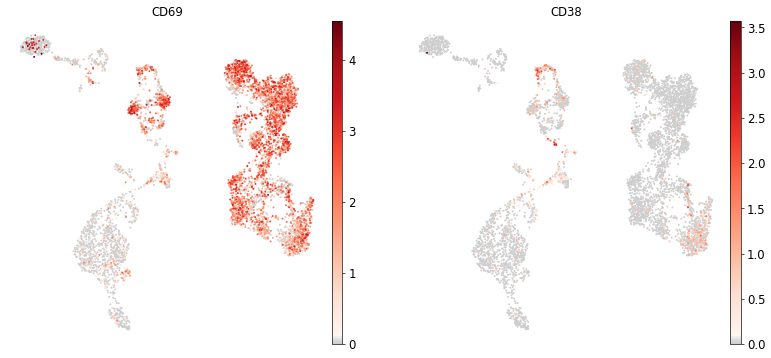

Cluster: T naive


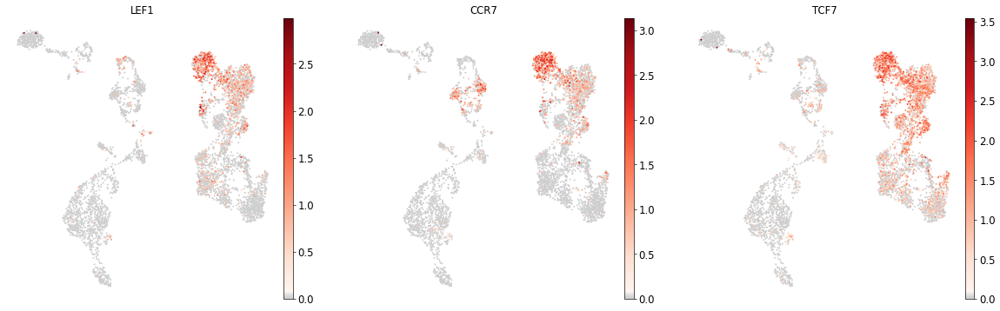

Cluster: Effector CD4+ T


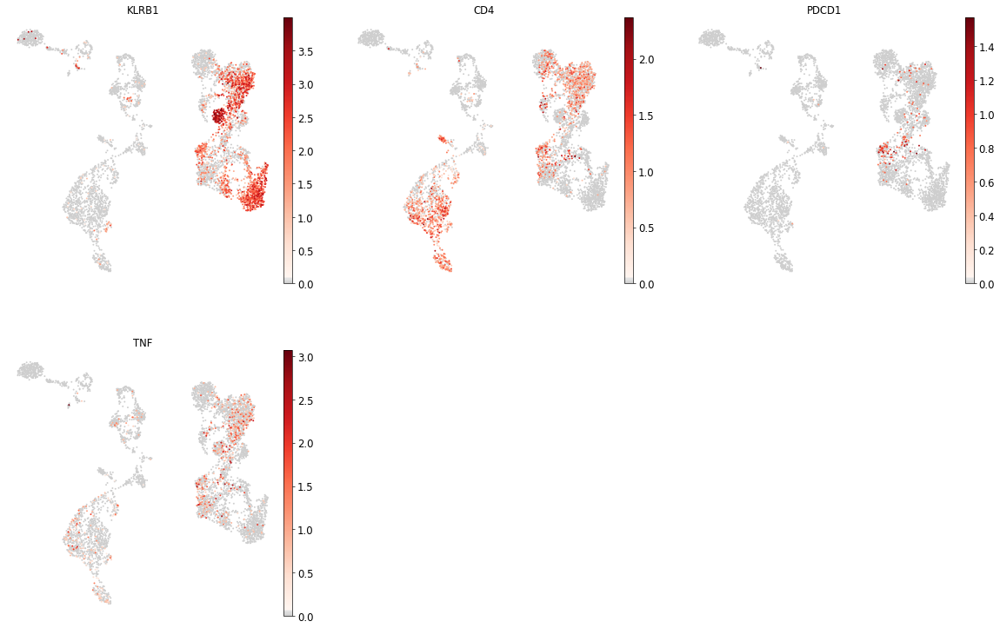

Cluster: Effector CD8+ T


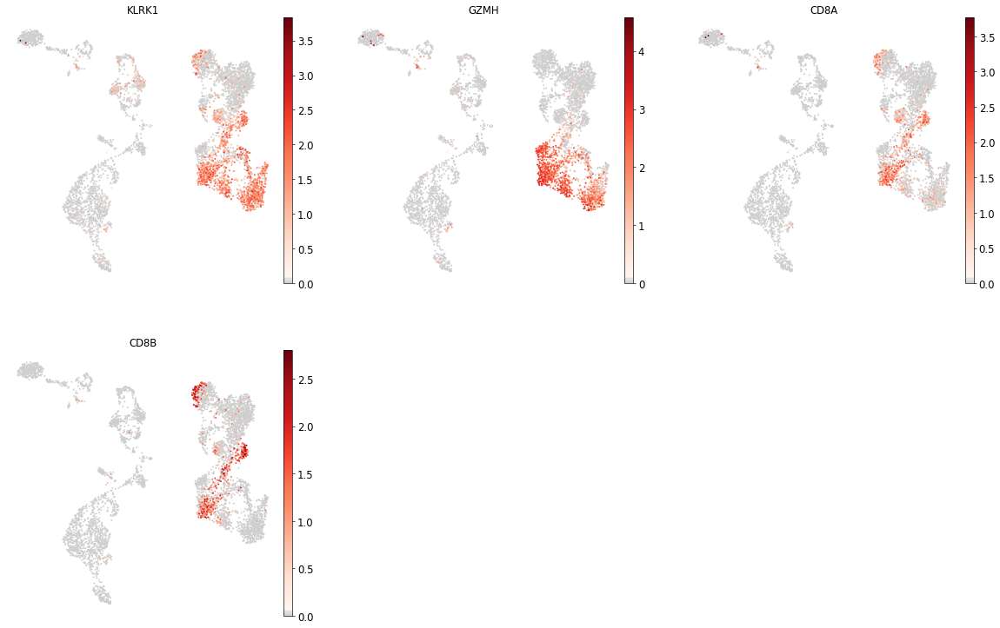

Cluster: MAIT


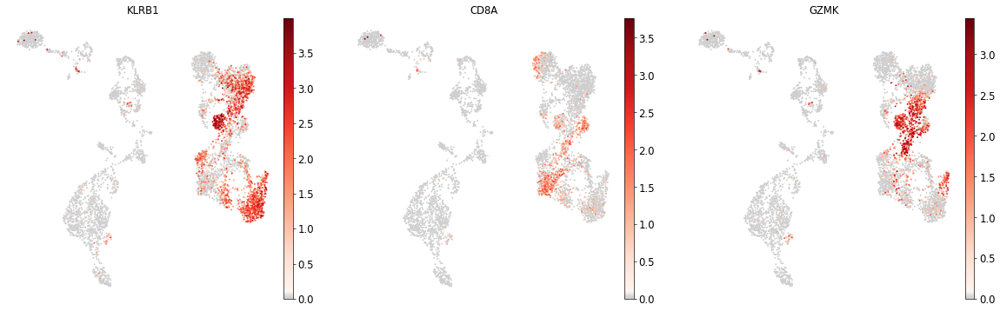

Cluster: gdT


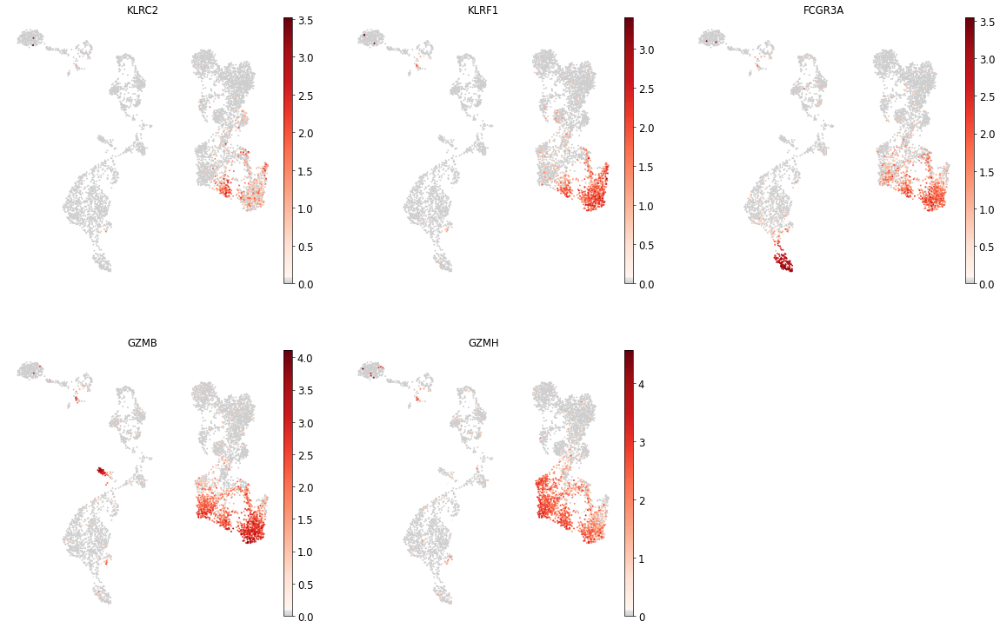

Cluster: pDC


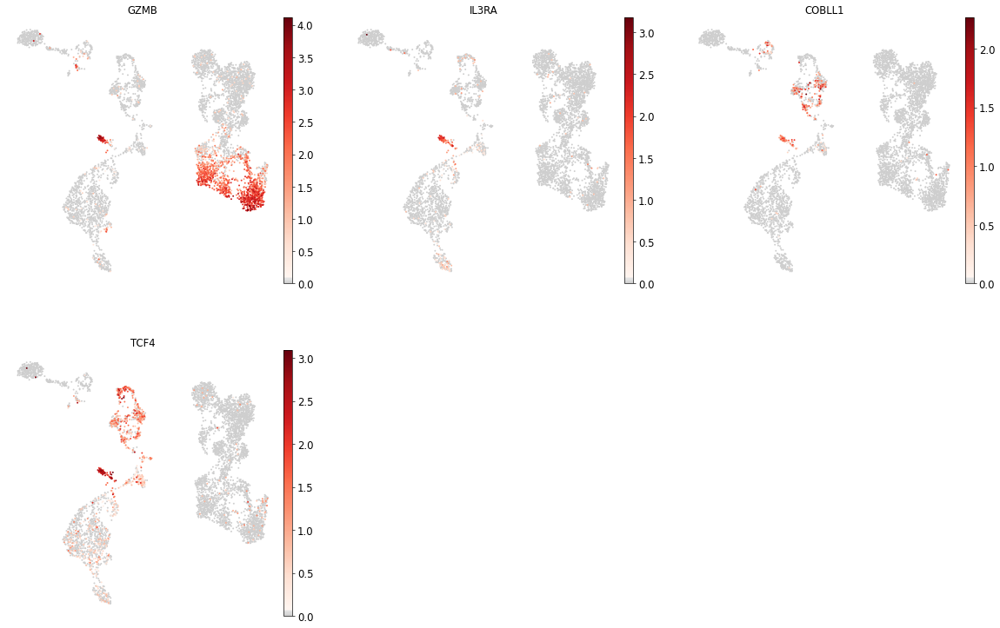

Cluster: G/M prog


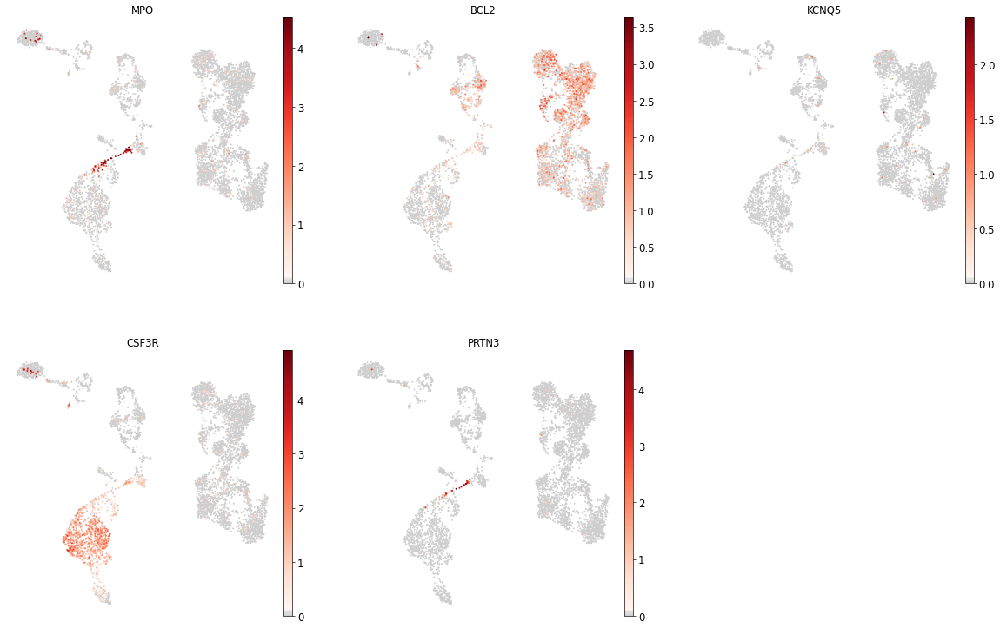

Cluster: HSC


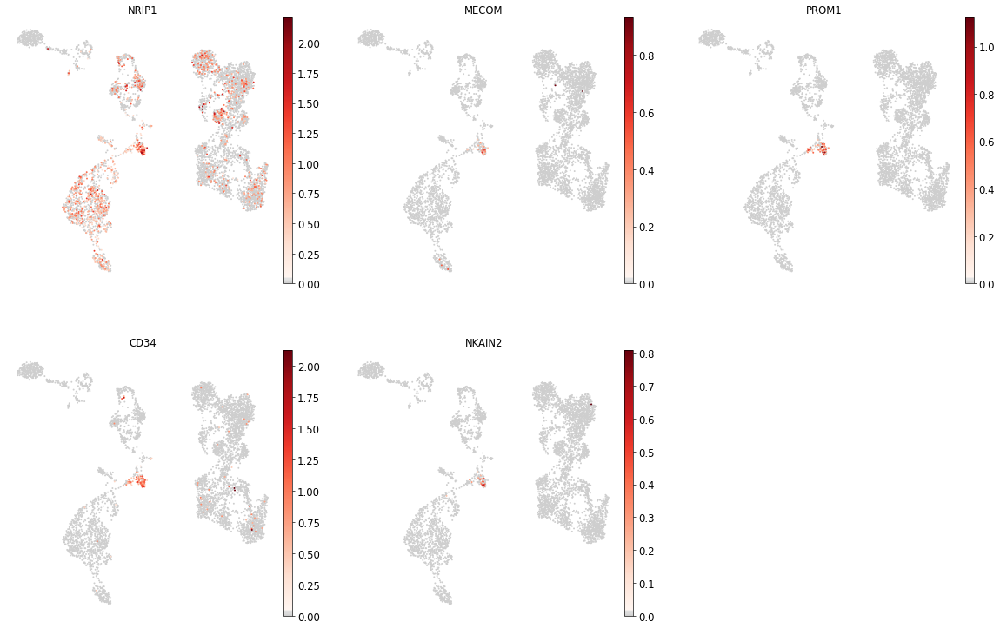

Cluster: MK/E prog


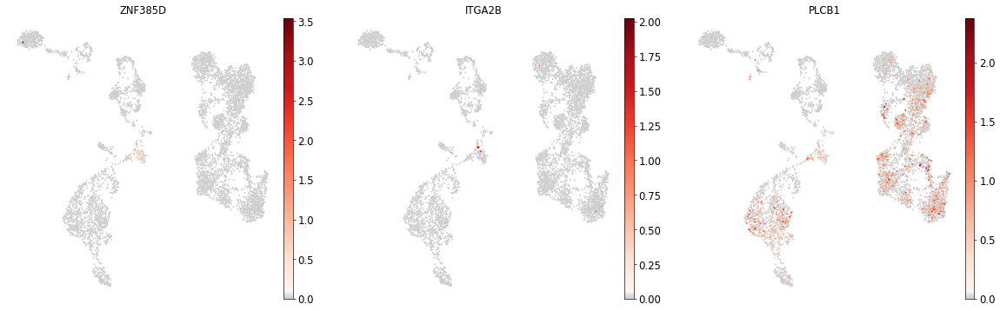

Cluster: HSPC STMN1+


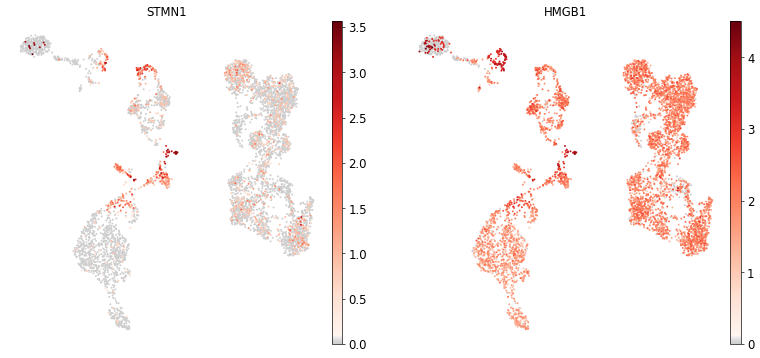

In [50]:
# Look at marker expression (commented out to decrease notebook size (Expression also plotted during clustering)
# Note that some markers are meant to be negative! (DMXL2, HBM, GYPA, IGHD, IGHM for some cell types)
for i in marker_genes.keys():
    print(f'Cluster: {i}')
    genes_to_plot = [i for i in marker_genes[i] if i in adata_gex.var_names]
    sc.pl.umap(adata_gex, color=genes_to_plot, ncols=3, use_raw=False, cmap=mymap)

In [51]:
marker_genes.keys()

dict_keys(['CD14+ Mono', 'CD16+ Mono', 'ID2-hi myeloid prog', 'cDC1', 'cDC2', 'Reticulocyte', 'Normoblast', 'Erythroblast', 'Proerythroblast', 'NK', 'ILC', 'Lymph prog', 'Naive CD20+ B - IGKC+', 'Naive CD20+ B - IGKC-', 'B1 B - IGKC+', 'B1 B - IGKC-', 'Transitional B', 'Plasma cell', 'Plasmablast', 'CD4+ T activated', 'CD4+ T naive', 'CD8+ T', 'T activation', 'T naive', 'Effector CD4+ T', 'Effector CD8+ T', 'MAIT', 'gdT', 'pDC', 'G/M prog', 'HSC', 'MK/E prog', 'HSPC STMN1+'])

Marker genes suggest:
- 0: CD4+ T activated -> yes!
- 1: NK -> yes!
- 2: CD8+ T GZMH+
  - check upper and lower part!
- 3: CD14+ Mono -> yes!
- 4: 
  - left part: CD8+ T naive
  - right part: CD4+ T naive
- 5: ID2-hi myeloid prog / CD14+ Mono -> yes
- 6: 
  - upper part: T naive, low quality?
  - lower part: ILC => very high MT score! -> yes!
- 7: Reticulocyte => super low MT (confirms enucleated cell!) -> yes
- 8: CD8+ T GZMK+
- 9: 
  - main upper blob: Naive CD20+ B IGKC-
  - nlower blob: B1 B IGKC-
  - bottom most clusters: plasma cell
- 10: 
  - main upper blob: Naive CD20+ B IGKC+
  - lower blob: B1 N IGKC+
- 11: CD8+ T GZMH+ / NK -> TYROBP+ FCGR3A+ => doublet?
- 12: CD8+ T GZMK+
- 13: CD16+ Mono -> yes!
- 14: 
  - left arm: G/M prog
  - main blob: HSC
- 15: 
  - left arm: G/M prog
  - right arm: cDC2
  - small bit of that arm: cDC1
- 16: 
  - lowest part: lymph prog & HSPC STMN1+
  - upper arm: transitional B
- 17: 
  - upper 2 arms: Erythroblast
  - upper part, lowest arm: proerythroblast
  - lower part: doublets!
- 18: pDC -> yes!
- 19: Normoblast -> yes!
- 20: Doublets

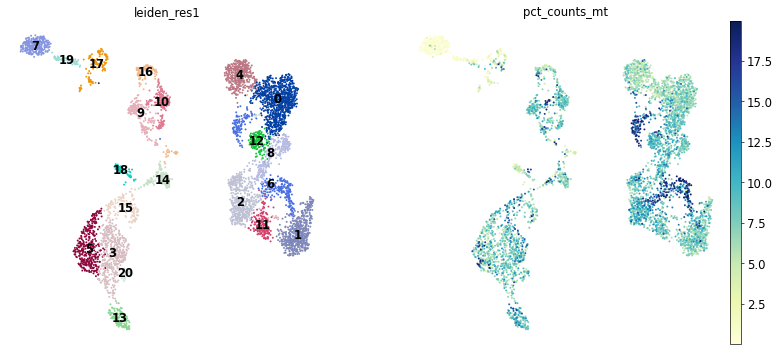

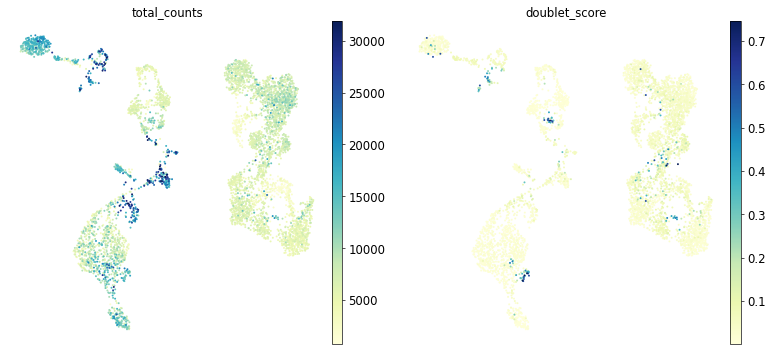

In [52]:
# Check some technical markers to assess potential doublet or low quality clusters
sc.pl.umap(adata_gex, color=['leiden_res1', 'pct_counts_mt'], legend_loc = 'on data')
sc.pl.umap(adata_gex, color=['total_counts', 'doublet_score'])

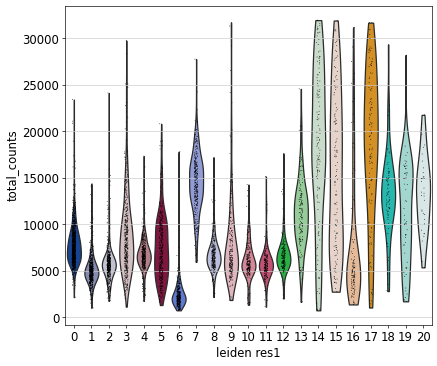

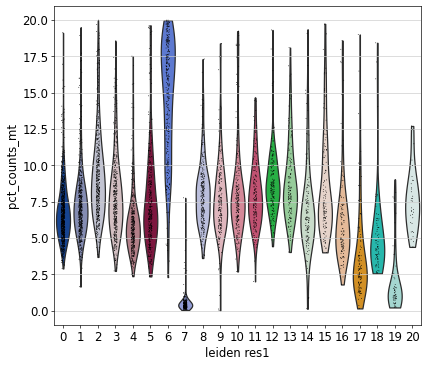

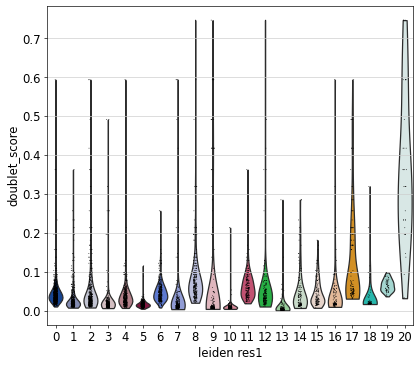

In [53]:
sc.pl.violin(adata_gex, keys='total_counts', groupby='leiden_res1')
sc.pl.violin(adata_gex, keys='pct_counts_mt', groupby='leiden_res1')
sc.pl.violin(adata_gex, keys='doublet_score', groupby='leiden_res1')

**LowQ and doublets**
- doublets: Cluster 20, parts of cluster 9, 17; mayb 8 and 12 as well (but minor)
- low quality: Cluster 6 -> ILC; part of 15

**Marker genes suggest**
- 0: CD4+ T activated -> yes!
- 1: NK -> yes!
- 2: CD8+ T GZMH+
  - check upper and lower part!
- 3: CD14+ Mono -> yes!
- 4: 
  - left part: CD8+ T naive
  - right part: CD4+ T naive
- 5: ID2-hi myeloid prog / CD14+ Mono -> yes
- 6: 
  - upper part: T naive, low quality?
  - lower part: ILC => very high MT score! -> yes!
- 7: Reticulocyte => super low MT (confirms enucleated cell!) -> yes
- 8: CD8+ T GZMK+
- 9: 
  - main upper blob: Naive CD20+ B IGKC-
  - nlower blob: B1 B IGKC-
  - bottom most clusters: plasma cell
- 10: 
  - main upper blob: Naive CD20+ B IGKC+
  - lower blob: B1 N IGKC+
- 11: CD8+ T GZMH+ / NK -> TYROBP+ FCGR3A+ => doublet?
- 12: CD8+ T GZMK+
- 13: CD16+ Mono -> yes!
- 14: 
  - left arm: G/M prog
  - main blob: HSC
- 15: 
  - left arm: G/M prog
  - right arm: cDC2
  - small bit of that arm: cDC1
- 16: 
  - lowest part: lymph prog & HSPC STMN1+
  - upper arm: transitional B
- 17: 
  - upper 2 arms: Erythroblast
  - upper part, lowest arm: proerythroblast
  - lower part: doublets!
- 18: pDC -> yes!
- 19: Normoblast -> yes!
- 20: Doublets

To do:
- Check diff between 3 and 5!
  - 5 looks like ID2-high and KLF4 high cluster!

subcluster:
- T: 2, 4 (diff 3&5)
- ILC/low Q: 6
- B: 9, 10
- Prog & cDC: 14, 15, 16
- Erythroblasts: 17

# Subclustering

Note that you will likely need to adapt the `resolution` parameter to optimally represent the substructure you see in the data.

## T and NK cells

### Cluster 2

In [54]:
orig_key = 'leiden_res1'
new_key = 'leiden_res1_tsub'
new_rg_key = 'rg_res1_tsub'
sub_key = '2'

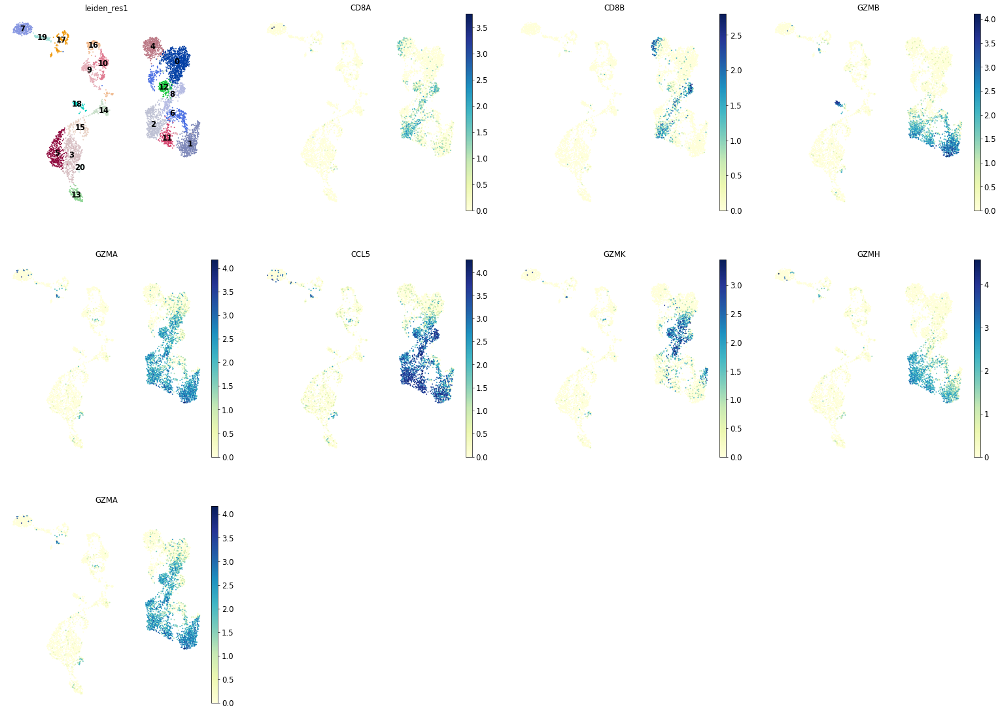

In [55]:
m_genes = marker_genes['CD8+ T']
sc.pl.umap(adata_gex, color=['leiden_res1']+m_genes, legend_loc = 'on data')

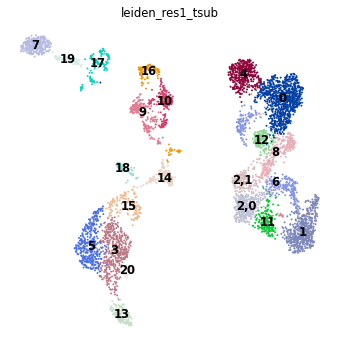

0      867
1      554
3      425
4      396
5      351
2,0    320
6      317
7      286
8      276
9      213
10     210
11     174
12     167
2,1    164
13     137
14     136
15     127
16     120
17     116
18      72
19      57
20      34
Name: leiden_res1_tsub, dtype: int64

In [56]:
res = 0.15
sc.tl.leiden(adata_gex, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)
sc.pl.umap(adata_gex, color=new_key, legend_loc='on data')
adata_gex.obs[new_key].value_counts()

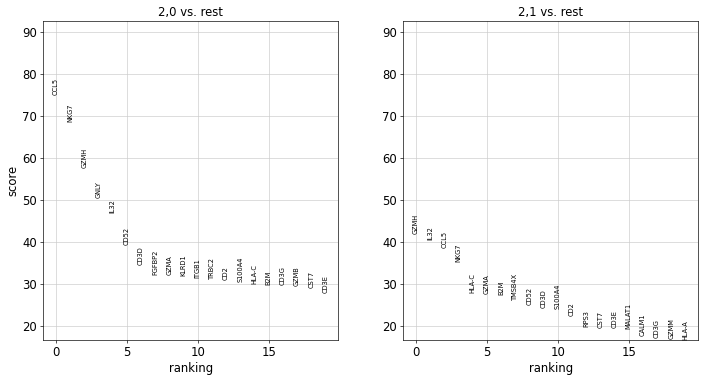

In [57]:
# Find markers of subclusters
num_subclusts = 2
new_groups = [sub_key+','+str(i) for i in range(num_subclusts)]
sc.tl.rank_genes_groups(adata_gex, groupby=new_key, key_added=new_rg_key, groups=new_groups)
sc.pl.rank_genes_groups(adata_gex, key=new_rg_key, groups=new_groups, ncols=3)

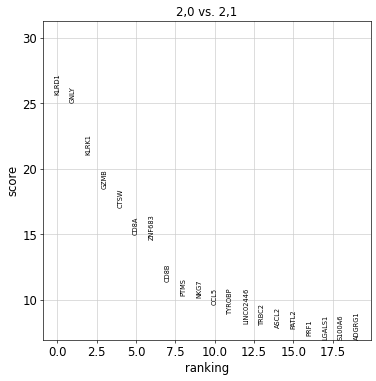

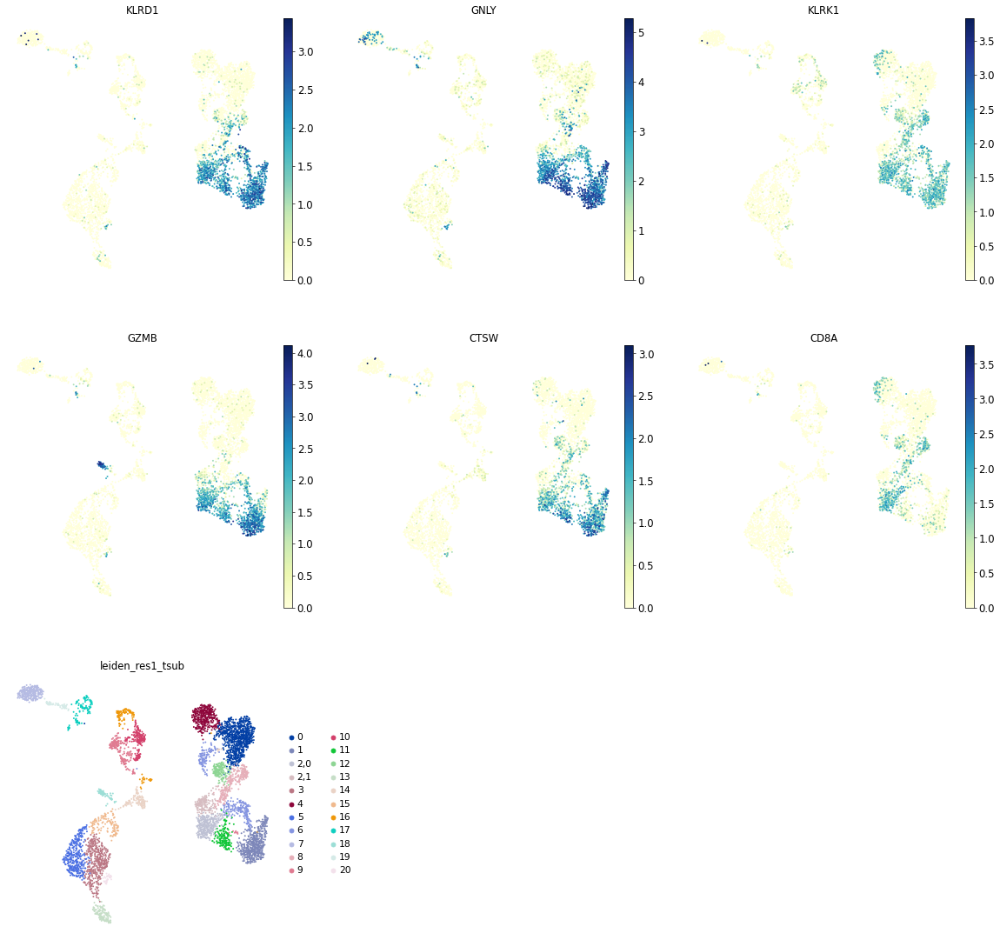

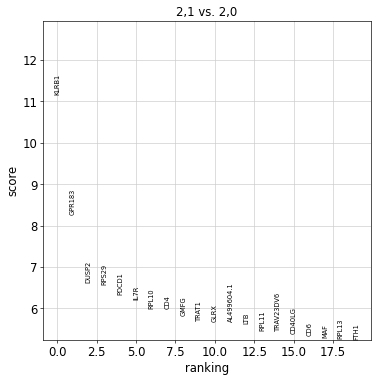

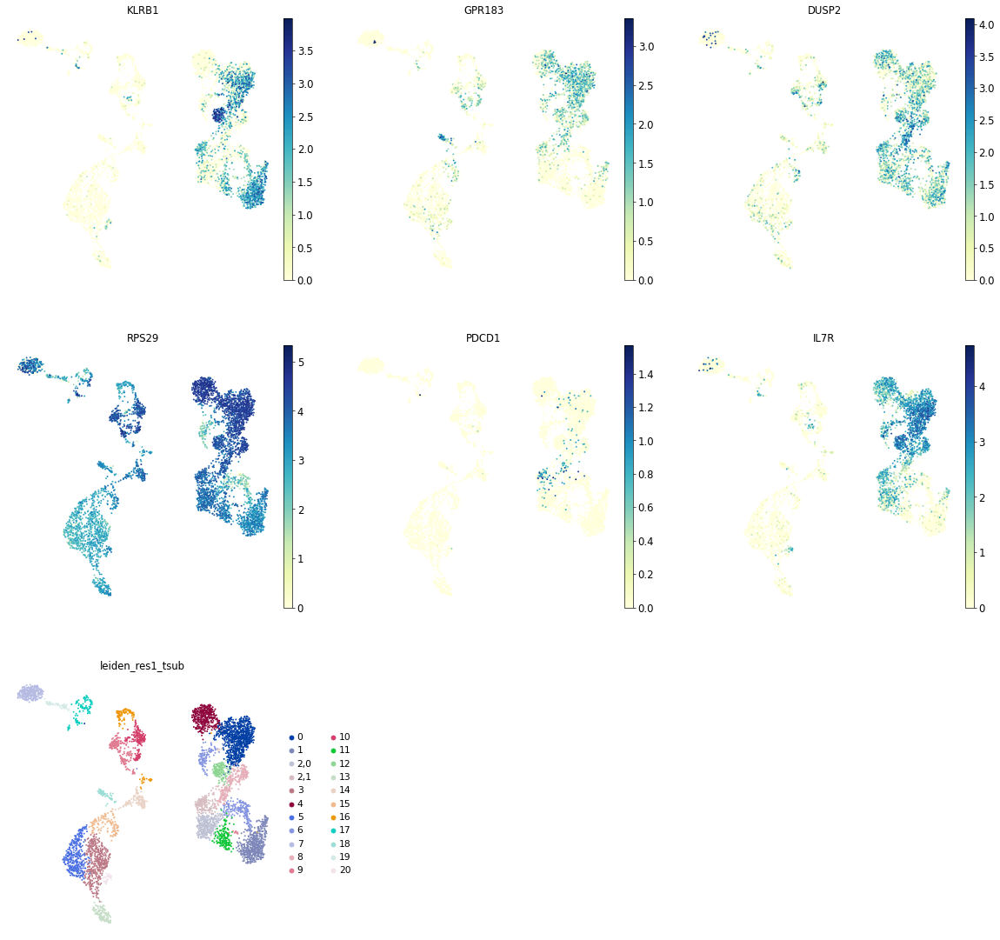

In [58]:
# Optional
# Check quick group comparison
for i in new_groups:
    for j in new_groups:
        if i == j:
            continue

        sc.tl.rank_genes_groups(adata_gex, groupby=new_key, key_added='test_comp', groups=[i], reference=j)
        sc.pl.rank_genes_groups(adata_gex, key='test_comp', groups=[i], ncols=3)
        top_6_genes = list(adata_gex.uns['test_comp']['names'][i][:6])
        sc.pl.umap(adata_gex, color=top_6_genes+[new_key], ncols=3)

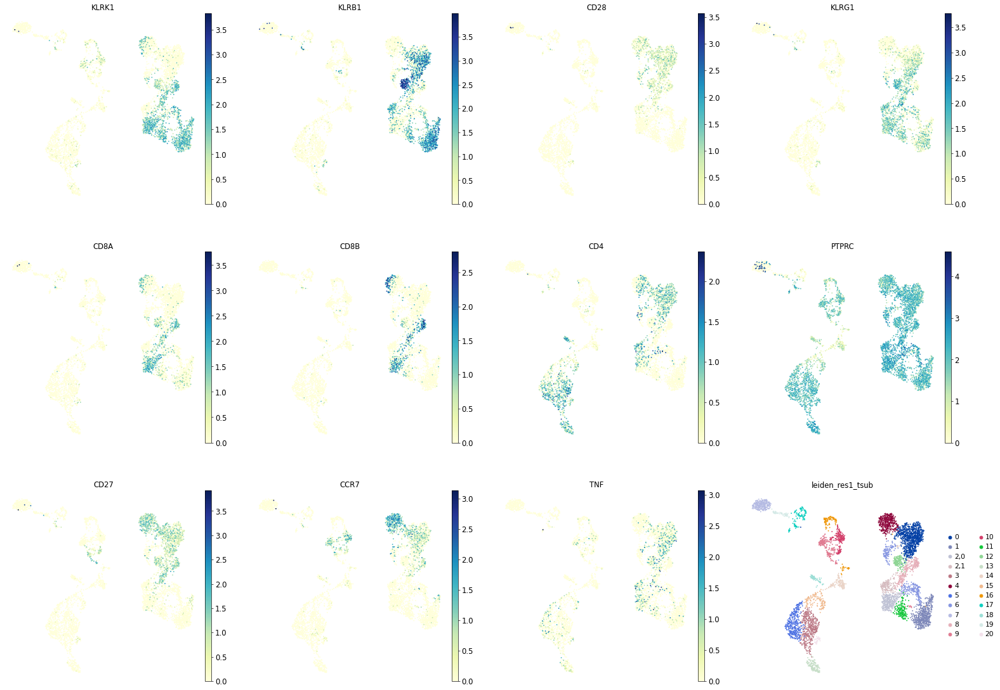

In [59]:
sc.pl.umap(adata_gex, color=['KLRK1', 'KLRB1', 'CD28', 'KLRG1', 'CD8A', 'CD8B', 'CD4', 'PTPRC', 'CD27', 'CCR7', 'TNF']+[new_key], size=20)

#### Summary

- 2,0: Effector CD8+ T # KLRK1, GZMH
- 2,1: Effector CD4+ T # KLRB1 is CD161+


### Cluster 4

In [60]:
orig_key = 'leiden_res1_tsub'
new_key = 'leiden_res1_tsub2'
new_rg_key = 'rg_res1_tsub2'
sub_key = '4'

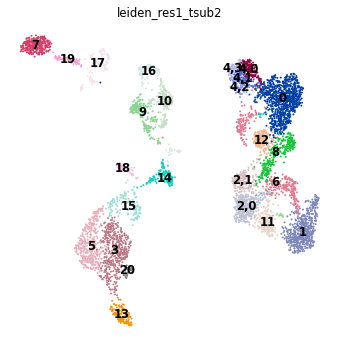

0      867
1      554
3      425
5      351
2,0    320
6      317
7      286
8      276
9      213
10     210
11     174
12     167
4,0    167
2,1    164
13     137
14     136
15     127
16     120
17     116
4,1     94
4,2     74
18      72
4,3     61
19      57
20      34
Name: leiden_res1_tsub2, dtype: int64

In [61]:
res = 0.7
sc.tl.leiden(adata_gex, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)
sc.pl.umap(adata_gex, color=new_key, legend_loc='on data')
adata_gex.obs[new_key].value_counts()

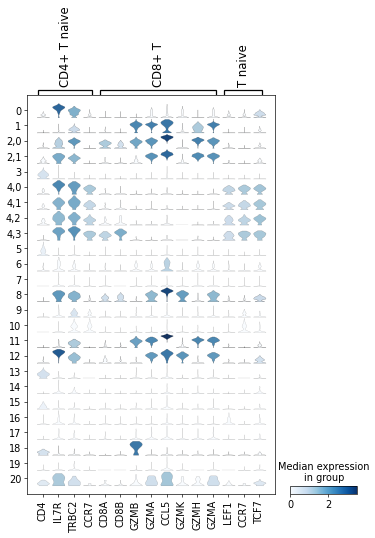

In [62]:
sc.pl.stacked_violin(adata_gex, var_names={a:marker_genes[a] for a in ['CD4+ T naive', 'CD8+ T', 'T naive']}, groupby=new_key)

#### Summary

- 4,0 CD4+ T naive
- 4,1 CD4+ T naive
- 4,2 CD4+ T naive
- 4,3 CD8+ T naive

### Cluster 6

In [63]:
orig_key = 'leiden_res1_tsub2'
new_key = 'leiden_res1_ilcsub'
new_rg_key = 'rg_res1_ilcsub'
sub_key = '6'

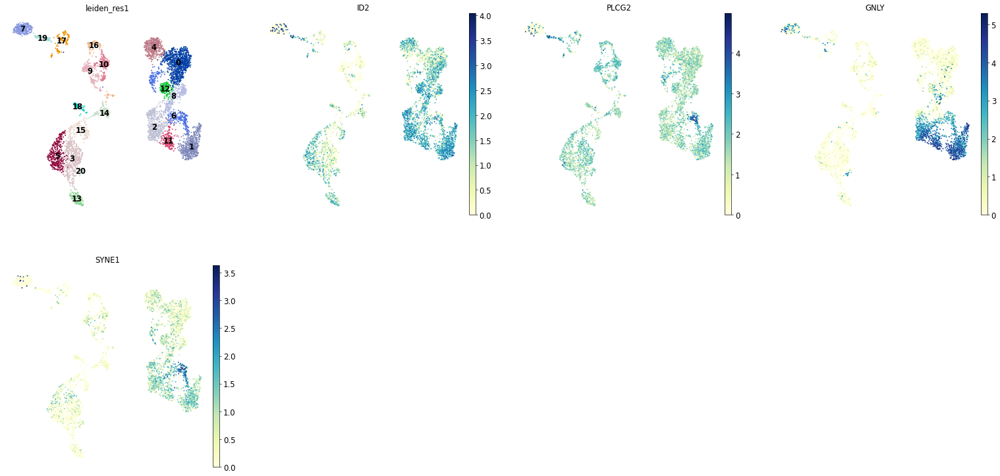

In [64]:
m_genes = marker_genes['ILC']
sc.pl.umap(adata_gex, color=['leiden_res1']+m_genes, legend_loc = 'on data')

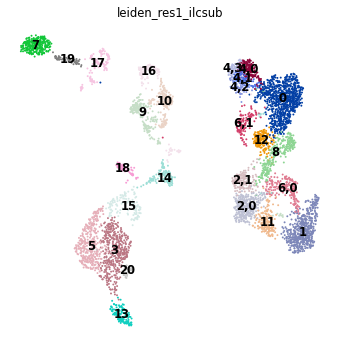

0      867
1      554
3      425
5      351
2,0    320
7      286
8      276
9      213
10     210
6,0    201
11     174
4,0    167
12     167
2,1    164
13     137
14     136
15     127
16     120
6,1    116
17     116
4,1     94
4,2     74
18      72
4,3     61
19      57
20      34
Name: leiden_res1_ilcsub, dtype: int64

In [65]:
res = 0.2
sc.tl.leiden(adata_gex, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)
sc.pl.umap(adata_gex, color=new_key, legend_loc='on data')
adata_gex.obs[new_key].value_counts()

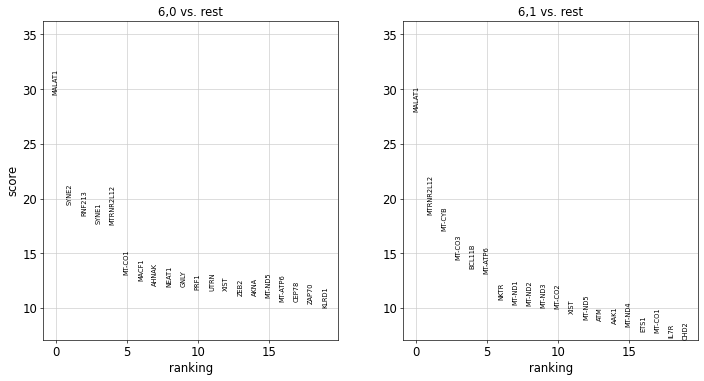

In [66]:
# Find markers of subclusters
num_subclusts = 2
new_groups = [sub_key+','+str(i) for i in range(num_subclusts)]
sc.tl.rank_genes_groups(adata_gex, groupby=new_key, key_added=new_rg_key, groups=new_groups)
sc.pl.rank_genes_groups(adata_gex, key=new_rg_key, groups=new_groups, ncols=3)

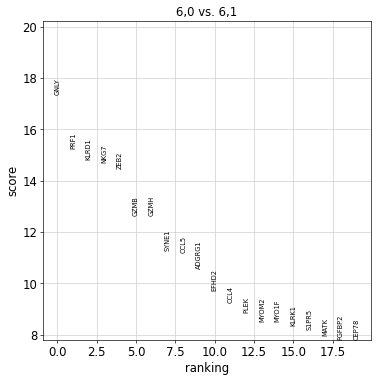

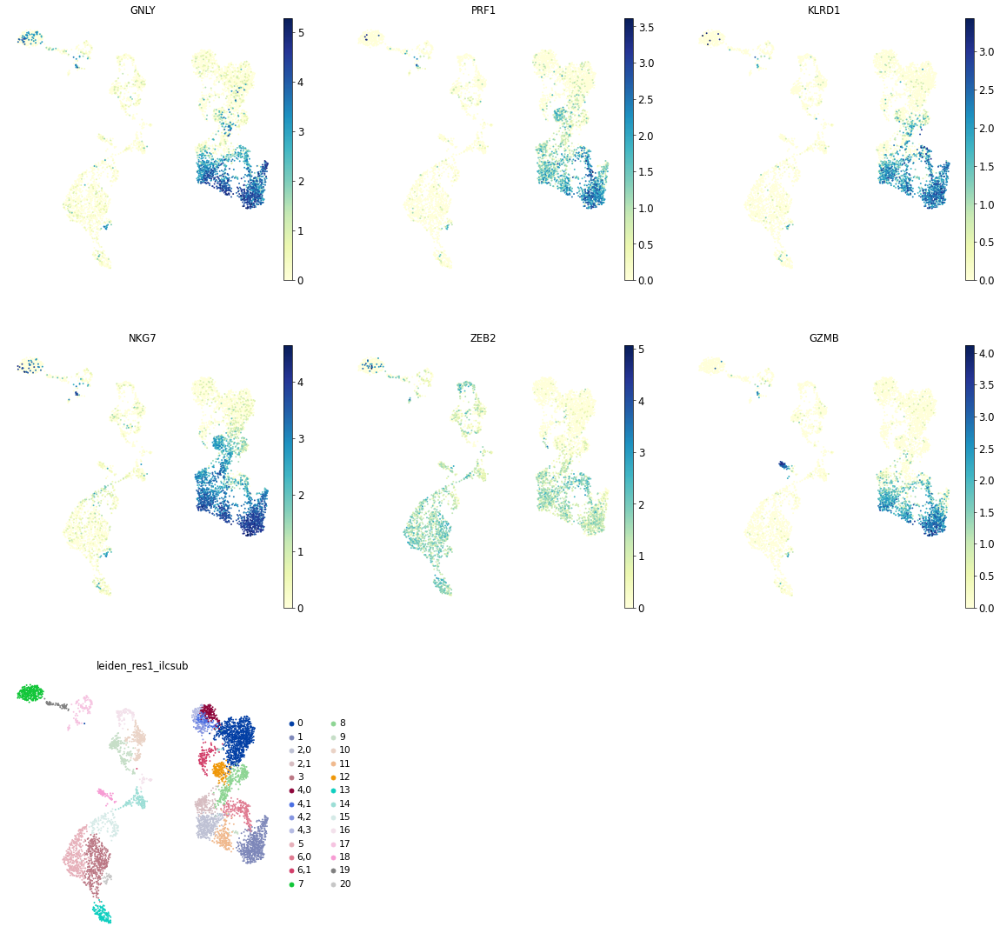

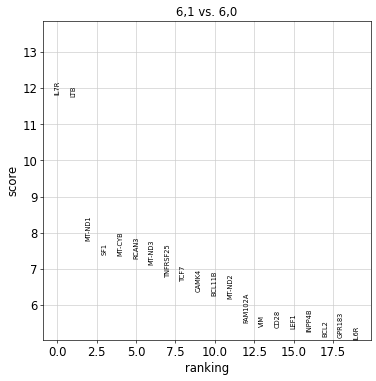

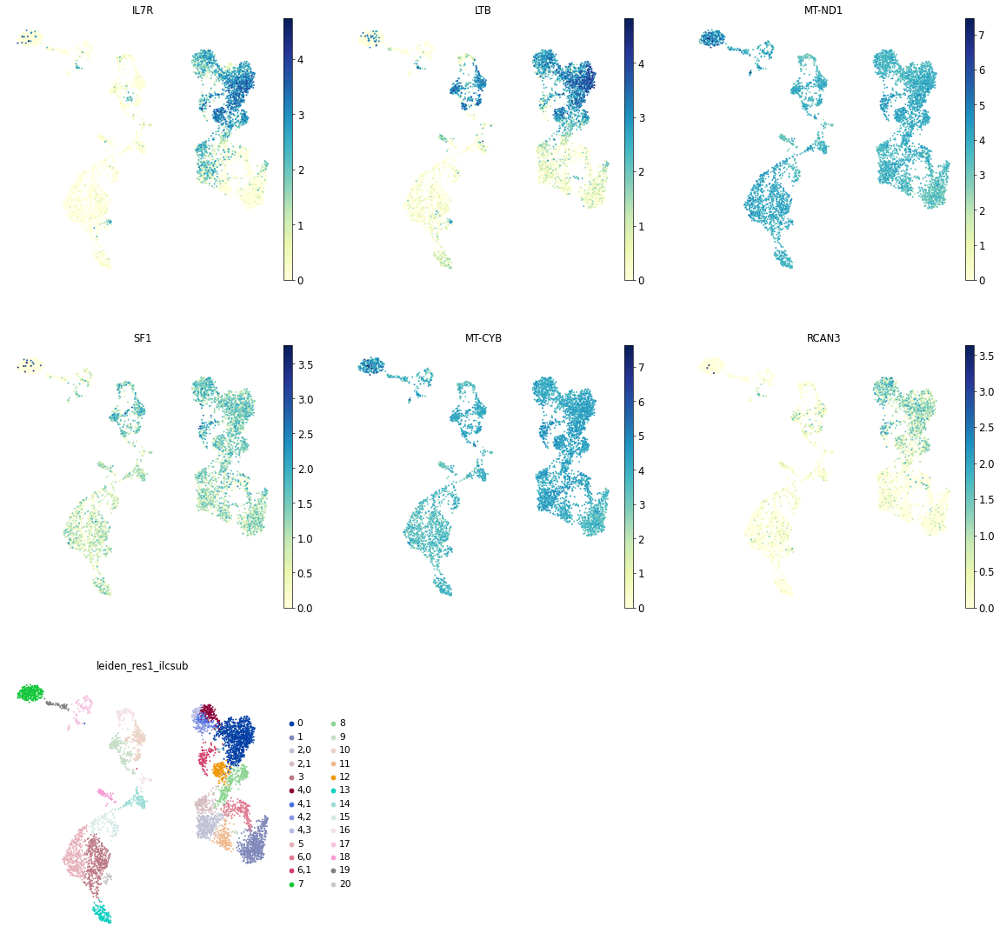

In [67]:
# Optional
# Check quick group comparison
for i in new_groups:
    for j in new_groups:
        if i == j:
            continue

        sc.tl.rank_genes_groups(adata_gex, groupby=new_key, key_added='test_comp', groups=[i], reference=j)
        sc.pl.rank_genes_groups(adata_gex, key='test_comp', groups=[i], ncols=3)
        top_6_genes = list(adata_gex.uns['test_comp']['names'][i][:6])
        sc.pl.umap(adata_gex, color=top_6_genes+[new_key], ncols=3)

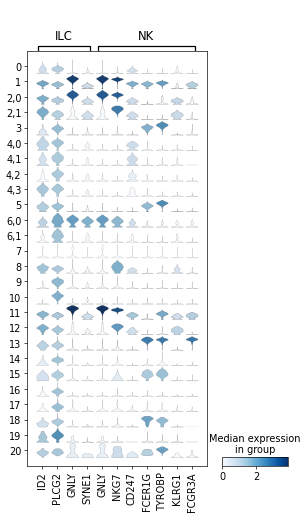

In [68]:
sc.pl.stacked_violin(adata_gex, var_names={a:marker_genes[a] for a in ['ILC', 'NK']}, groupby=new_key)

#### Summary

- 6,0: ILC
- 6,1: doublets/low quality

### Cluster 11

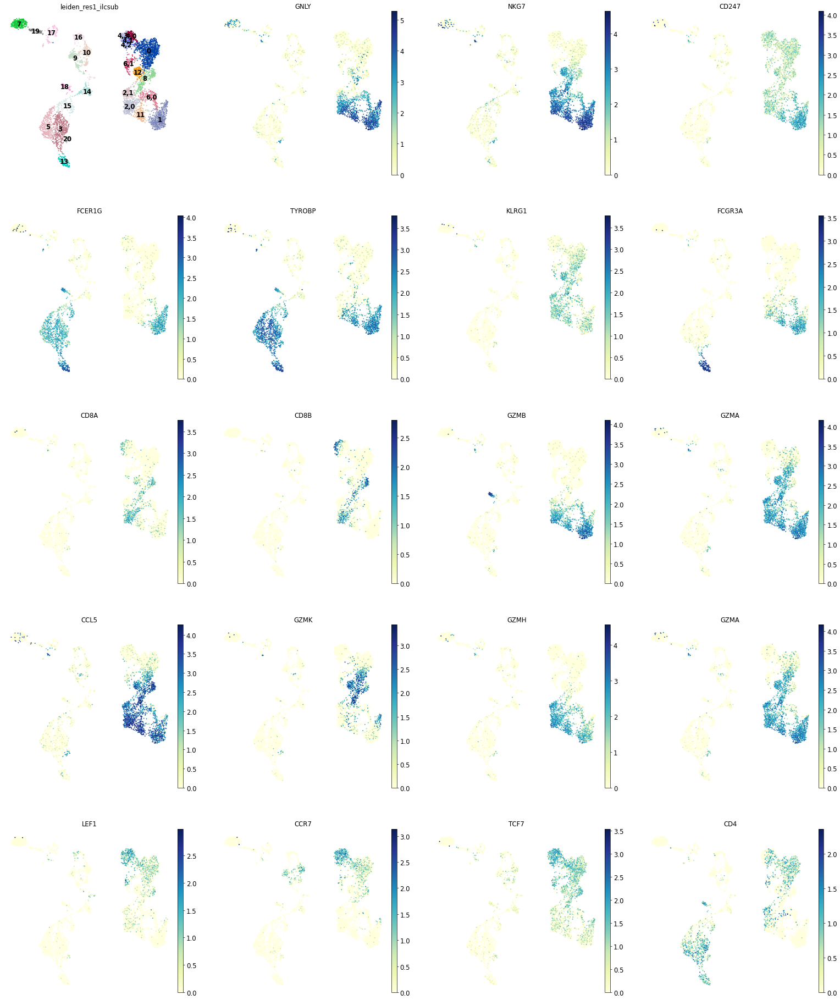

In [69]:
m_genes = marker_genes['NK']+marker_genes['CD8+ T']+marker_genes['T naive']+['CD4']
plot_genes = [g for g in m_genes if g in adata_gex.var_names]
sc.pl.umap(adata_gex, color=[new_key]+plot_genes, legend_loc = 'on data')

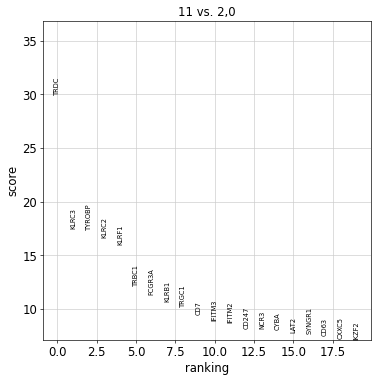

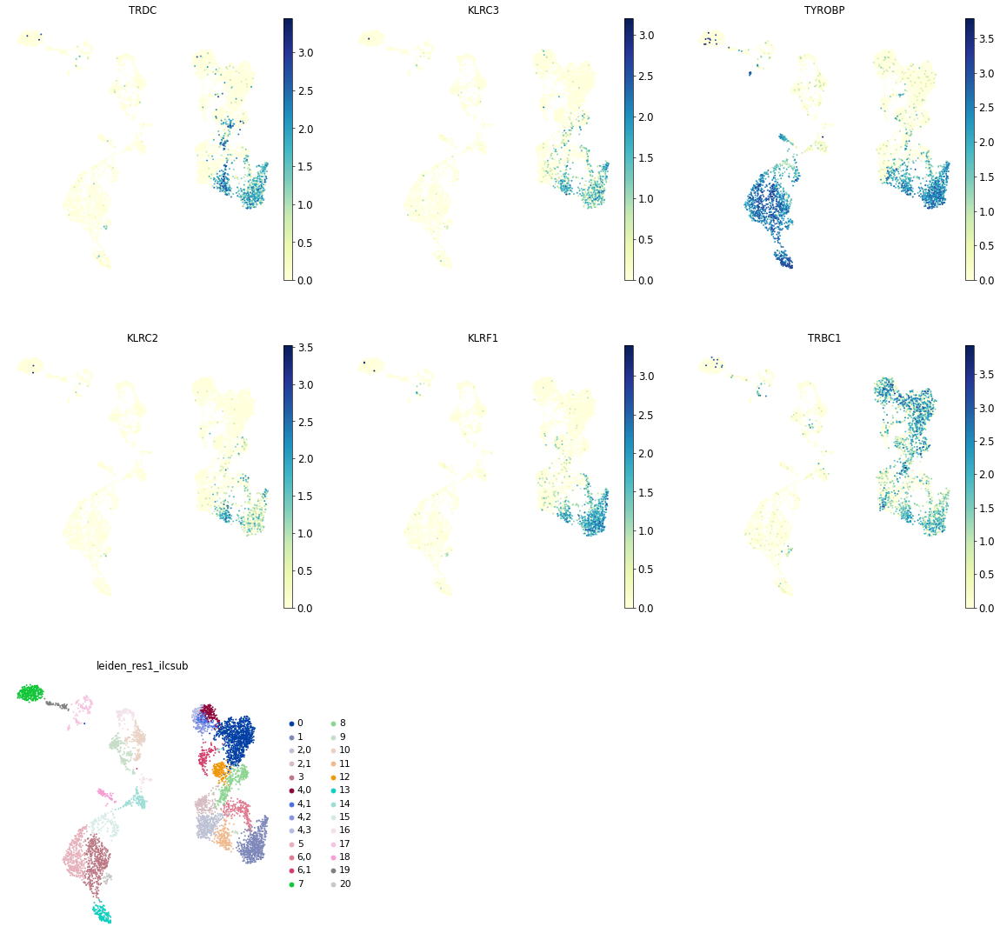

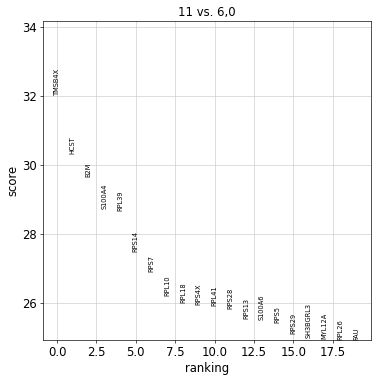

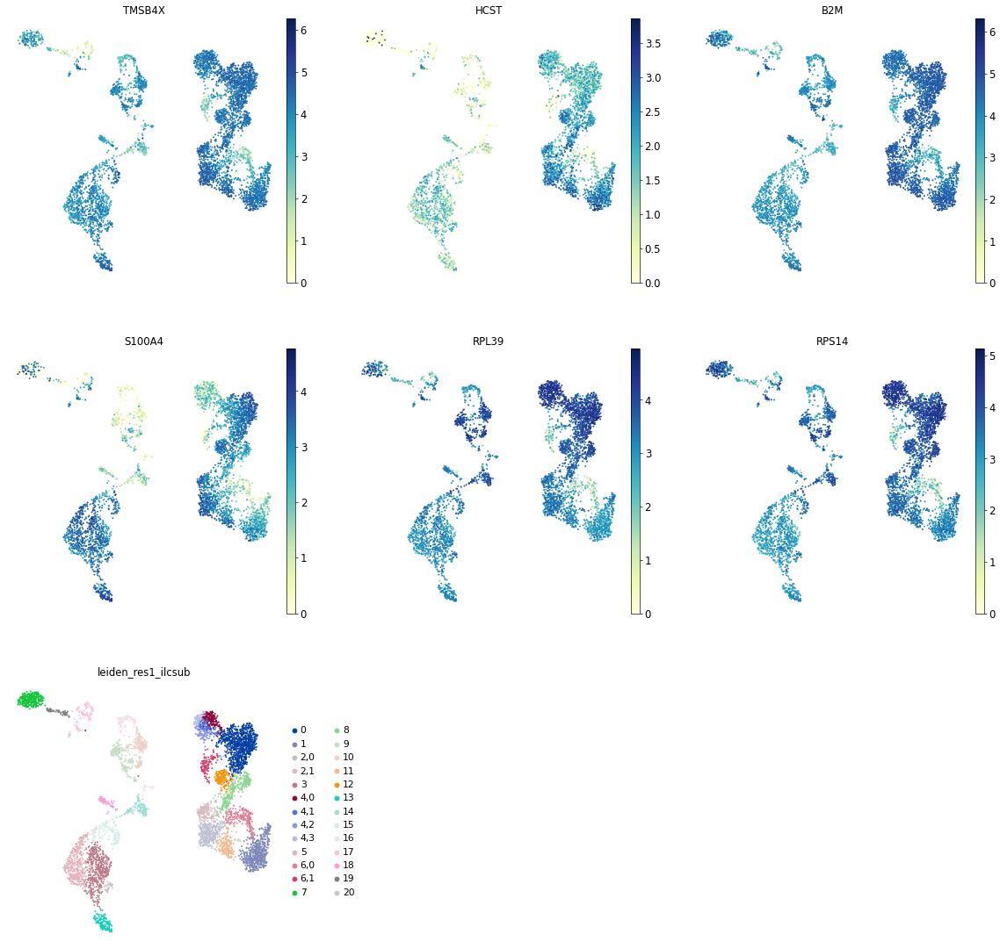

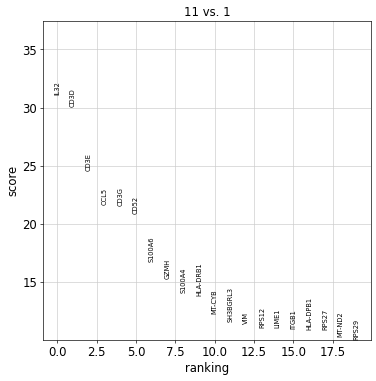

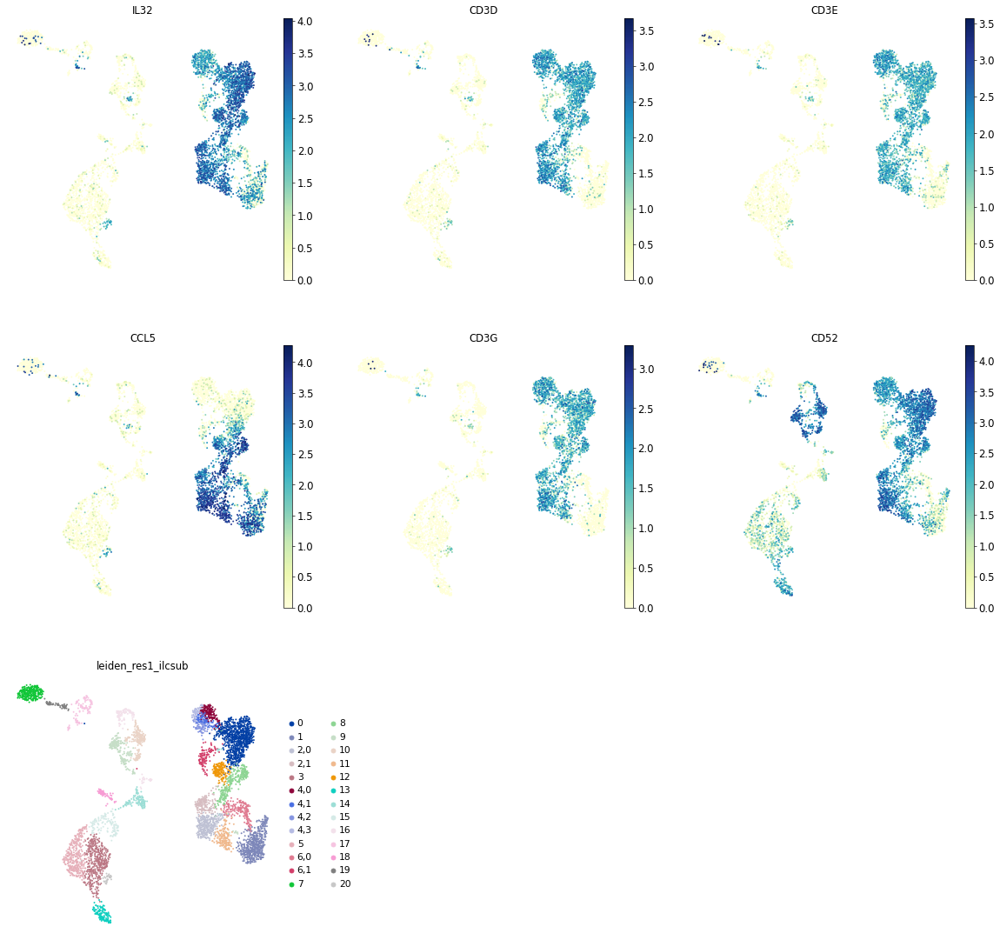

In [70]:
# Compare 11 to neighbouring clusters
sc.tl.rank_genes_groups(adata_gex, groupby=new_key, key_added='test_comp', groups=['11'], reference='2,0')
sc.pl.rank_genes_groups(adata_gex, key='test_comp', groups=['11'], ncols=3)
top_6_genes = list(adata_gex.uns['test_comp']['names']['11'][:6])
sc.pl.umap(adata_gex, color=top_6_genes+[new_key], ncols=3)

sc.tl.rank_genes_groups(adata_gex, groupby=new_key, key_added='test_comp', groups=['11'], reference='6,0')
sc.pl.rank_genes_groups(adata_gex, key='test_comp', groups=['11'], ncols=3)
top_6_genes = list(adata_gex.uns['test_comp']['names']['11'][:6])
sc.pl.umap(adata_gex, color=top_6_genes+[new_key], ncols=3)

sc.tl.rank_genes_groups(adata_gex, groupby=new_key, key_added='test_comp', groups=['11'], reference='1')
sc.pl.rank_genes_groups(adata_gex, key='test_comp', groups=['11'], ncols=3)
top_6_genes = list(adata_gex.uns['test_comp']['names']['11'][:6])
sc.pl.umap(adata_gex, color=top_6_genes+[new_key], ncols=3)

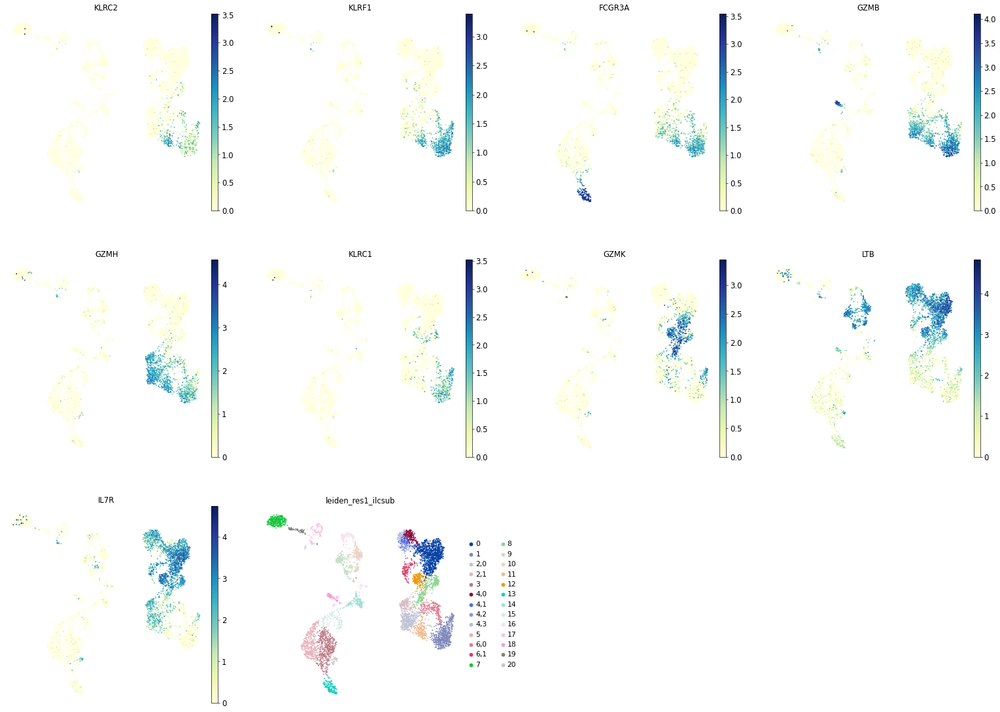

In [71]:
sc.pl.umap(adata_gex, color=['KLRC2', 'KLRF1', 'FCGR3A', 'GZMB', 'GZMH', 'KLRC1', 'GZMK', 'LTB', 'IL7R']+[new_key], size=20)

#### Summary

- 11: TCRVδ1 gdT: 'KLRC2', 'KLRF1', 'FCGR3A', 'GZMB', 'GZMH'

### Cluster 8

In [124]:
orig_key = 'leiden_res1_ilcsub'
new_key = 'leiden_res1_tsub3'
new_rg_key = 'rg_res1_tsub3'
sub_key = '8'

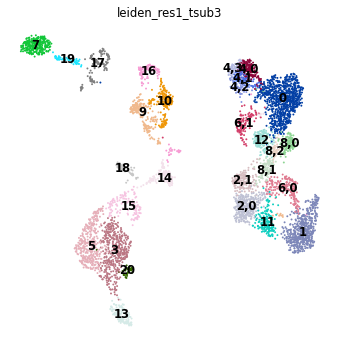

0      867
1      554
3      425
5      351
2,0    320
7      286
9      213
10     210
6,0    201
11     174
4,0    167
12     167
2,1    164
13     137
14     136
15     127
16     120
6,1    116
8,0    116
17     116
8,1    107
4,1     94
4,2     74
18      72
4,3     61
19      57
8,2     53
20      34
Name: leiden_res1_tsub3, dtype: int64

In [126]:
res = 0.3
sc.tl.leiden(adata_gex, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)
sc.pl.umap(adata_gex, color=new_key, legend_loc='on data')
adata_gex.obs[new_key].value_counts()

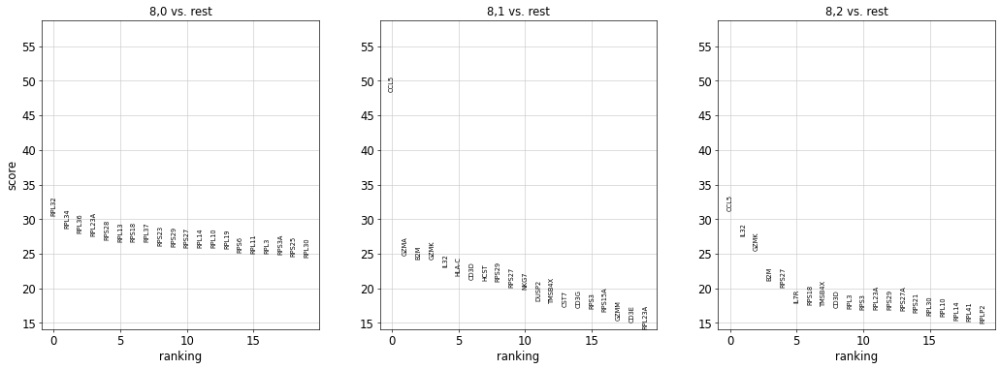

In [127]:
# Find markers of subclusters
num_subclusts = 3
new_groups = [sub_key+','+str(i) for i in range(num_subclusts)]
sc.tl.rank_genes_groups(adata_gex, groupby=new_key, key_added=new_rg_key, groups=new_groups)
sc.pl.rank_genes_groups(adata_gex, key=new_rg_key, groups=new_groups, ncols=3)

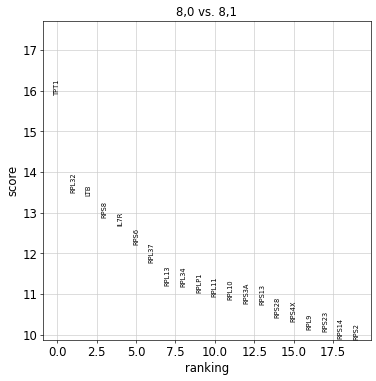

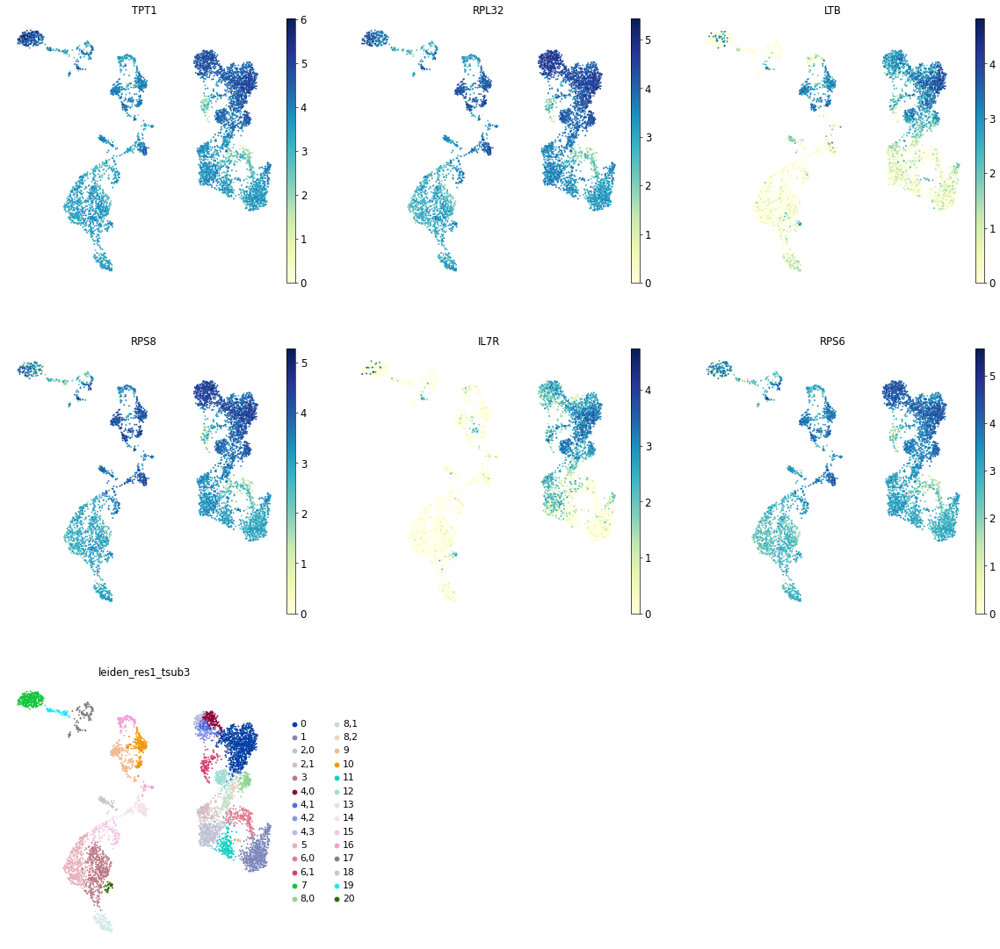

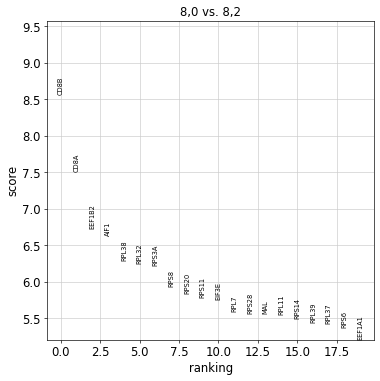

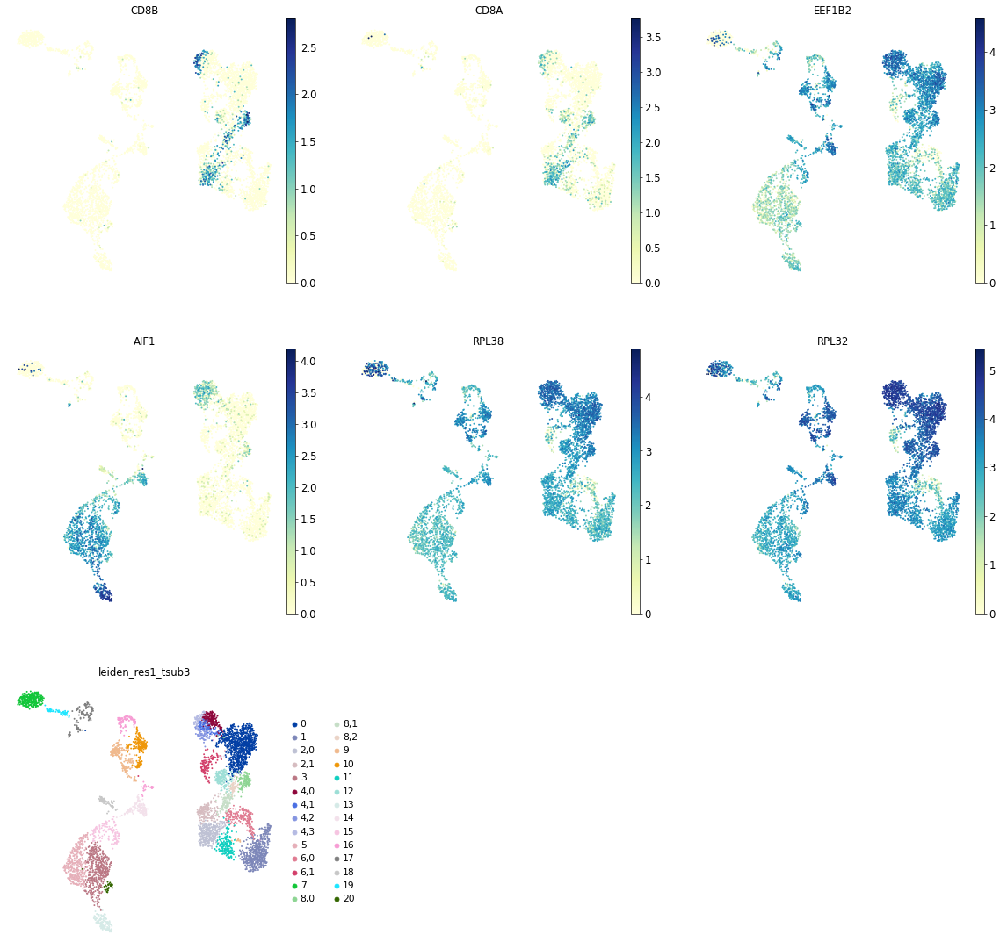

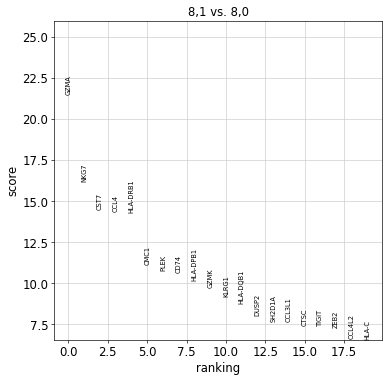

...

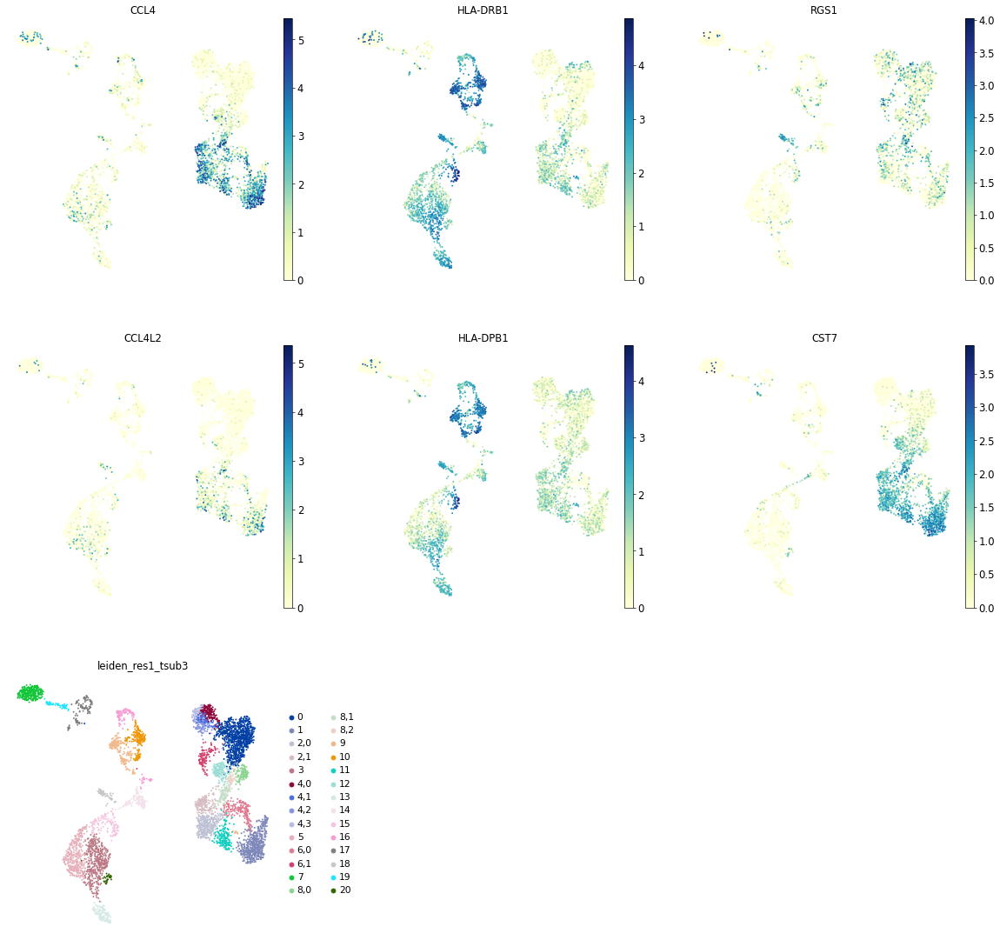

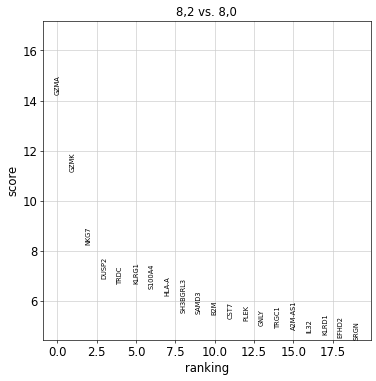

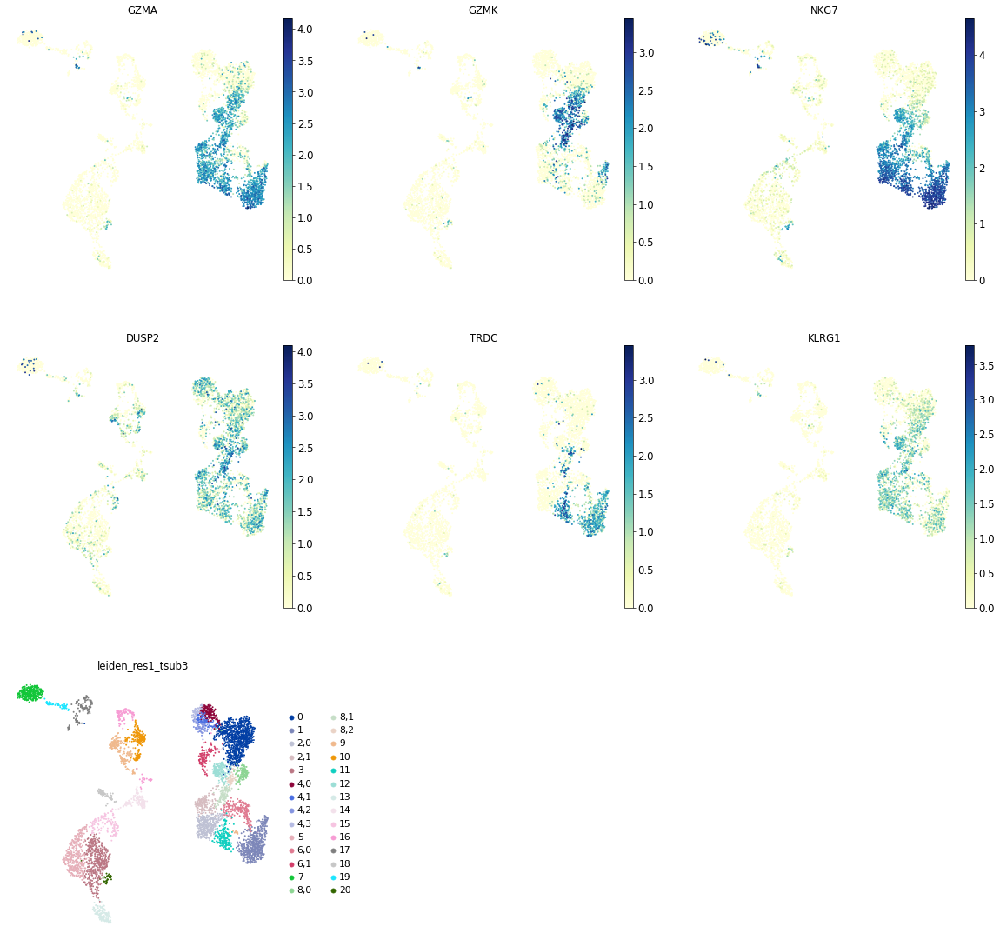

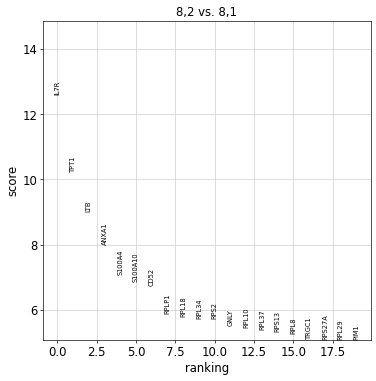

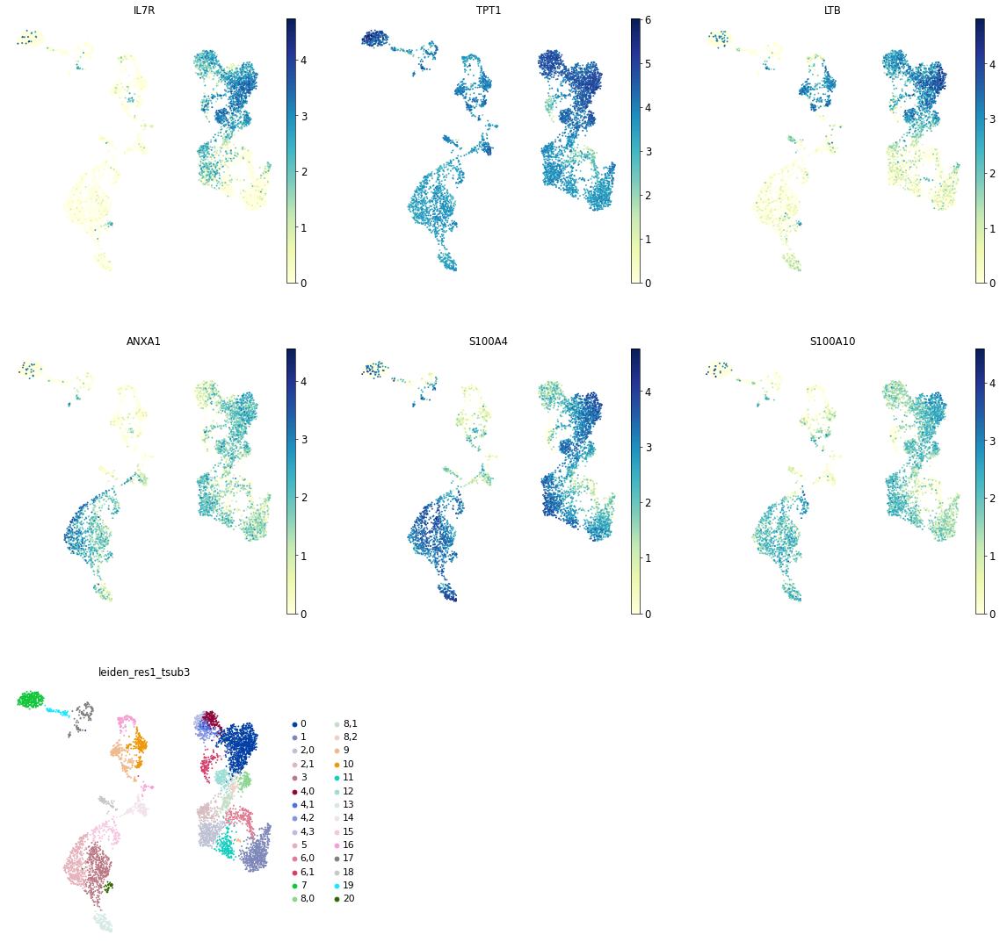

In [128]:
# Optional
# Check quick group comparison
for i in new_groups:
    for j in new_groups:
        if i == j:
            continue

        sc.tl.rank_genes_groups(adata_gex, groupby=new_key, key_added='test_comp', groups=[i], reference=j)
        sc.pl.rank_genes_groups(adata_gex, key='test_comp', groups=[i], ncols=3)
        top_6_genes = list(adata_gex.uns['test_comp']['names'][i][:6])
        sc.pl.umap(adata_gex, color=top_6_genes+[new_key], ncols=3)

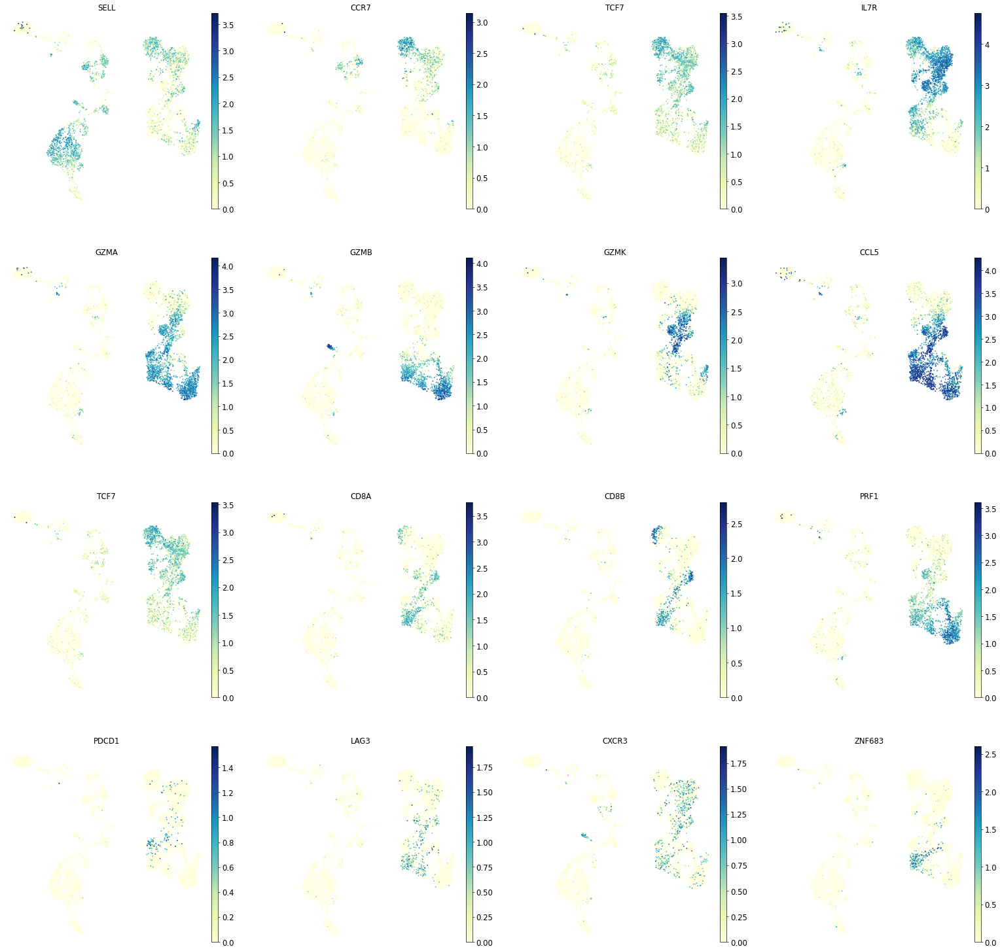

In [151]:
sc.pl.umap(adata_gex, color=['SELL', 'CCR7', 'TCF7', 'IL7R', 'GZMA', 'GZMB','GZMK', 'CCL5', 'TCF7', 'CD8A', 'CD8B', 'PRF1', 'PDCD1', 'LAG3', 'CXCR3', 'ZNF683'], size=20)
#CMC1+ CCL4+ RGS1+ CST7+ GZMA+ CD8+ PDCD1+ TRDC+

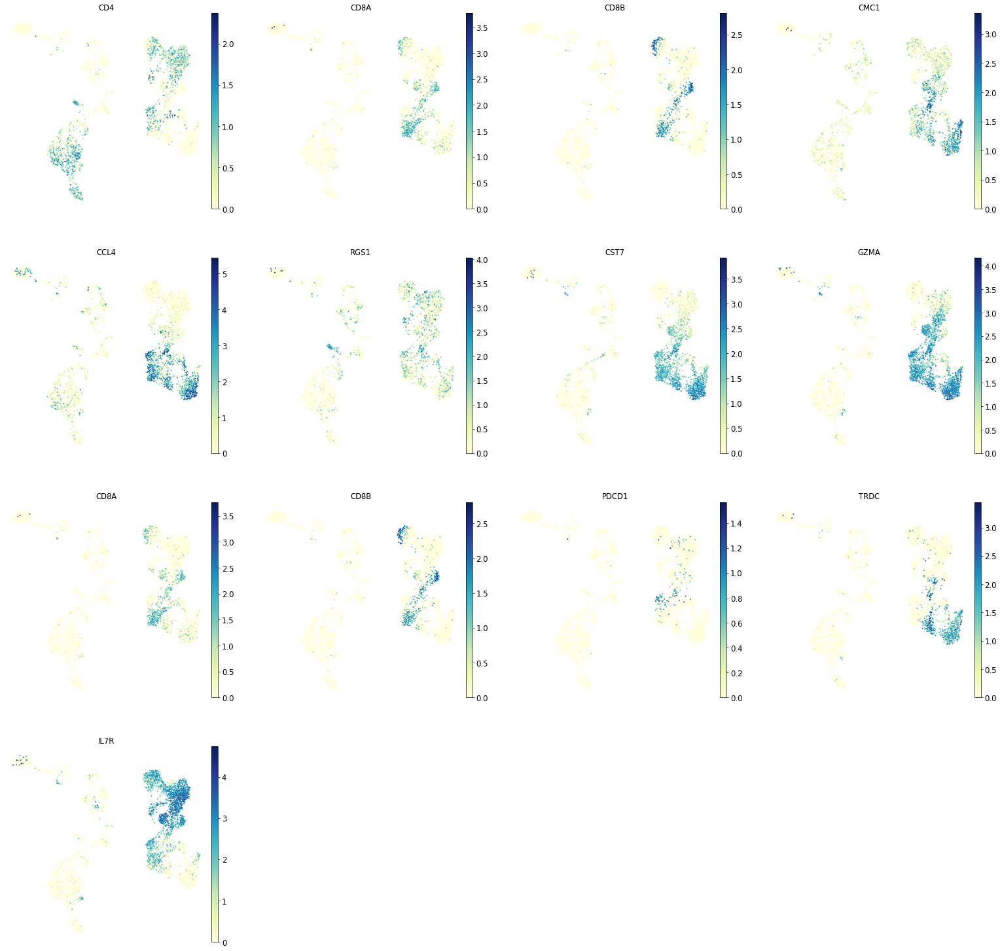

In [156]:
sc.pl.umap(adata_gex, color=['CD4', 'CD8A', 'CD8B', 'CMC1', 'CCL4', 'RGS1', 'CST7', 'GZMA', 'CD8A', 'CD8B', 'PDCD1', 'TRDC', 'IL7R'], size=20)

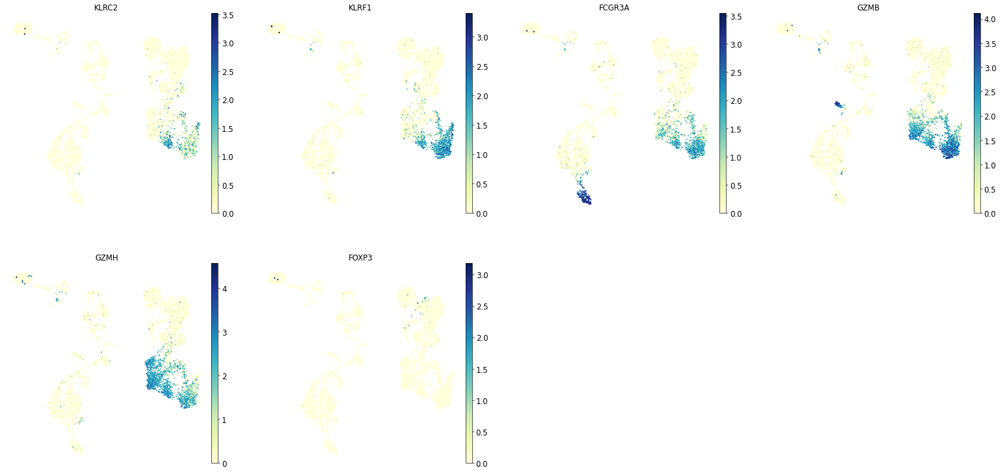

In [210]:
sc.pl.umap(adata_gex, color=['KLRC2', 'KLRF1', 'FCGR3A', 'GZMB', 'GZMH', 'FOXP3'], size=30)

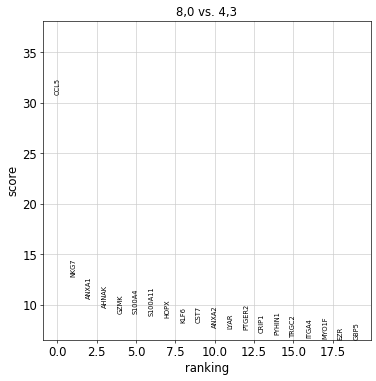

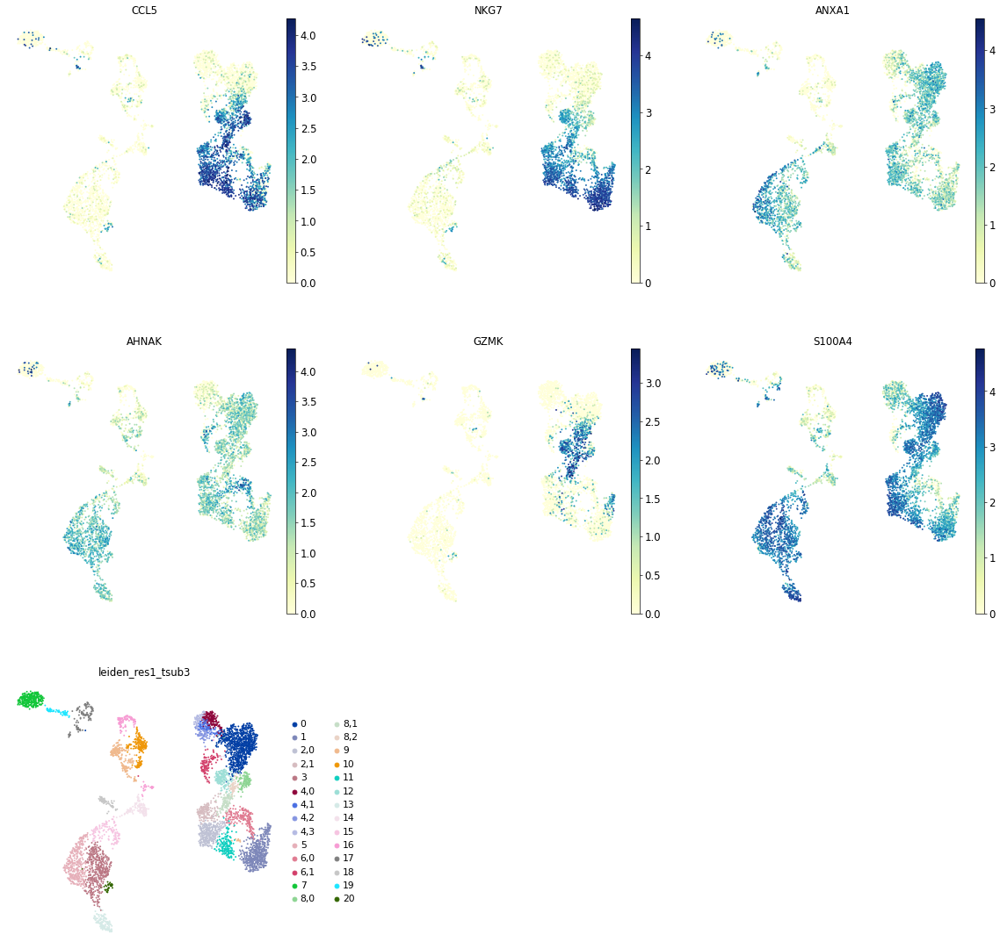

In [136]:
# Compare 8,0 to 4,3
sc.tl.rank_genes_groups(adata_gex, groupby=new_key, key_added='test_comp', groups=['8,0'], reference='4,3')
sc.pl.rank_genes_groups(adata_gex, key='test_comp', groups=['8,0'], ncols=3)
top_6_genes = list(adata_gex.uns['test_comp']['names']['8,0'][:6])
sc.pl.umap(adata_gex, color=top_6_genes+[new_key], ncols=3)

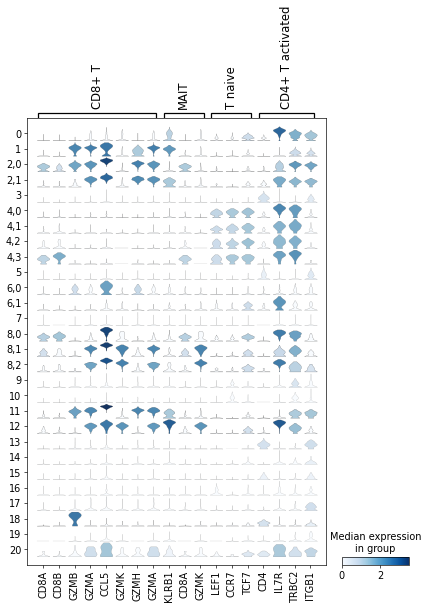

In [130]:
sc.pl.stacked_violin(adata_gex, var_names={a:marker_genes[a] for a in ['CD8+ T', 'MAIT', 'T naive', 'CD4+ T activated']}, groupby=new_key)

#### Summary

- 8,0 CD8+ T early activation
- 8,1 CD8+ T CCL4+ GZMK+ TRDC+
- 8,2 gdT TRDC+ GZMK+ IL7R+

## Monocytes & DCs

### Clusters 3 and 5

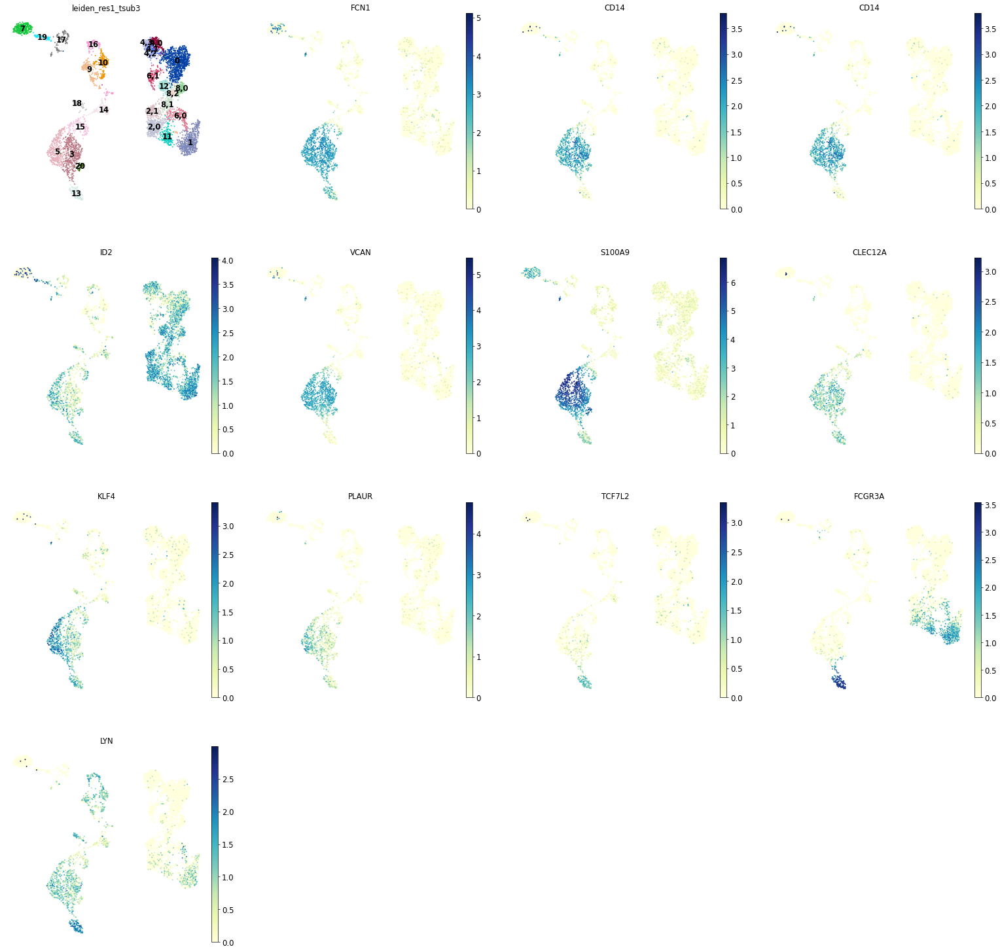

In [157]:
m_genes1 = marker_genes['CD14+ Mono']
m_genes2 = marker_genes['ID2-hi myeloid prog']
m_genes3 = marker_genes['CD16+ Mono']
sc.pl.umap(adata_gex, color=[new_key]+m_genes1+m_genes2+m_genes3, legend_loc = 'on data')

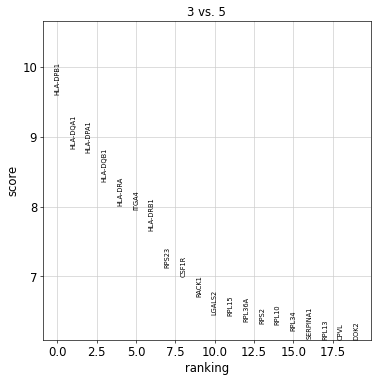

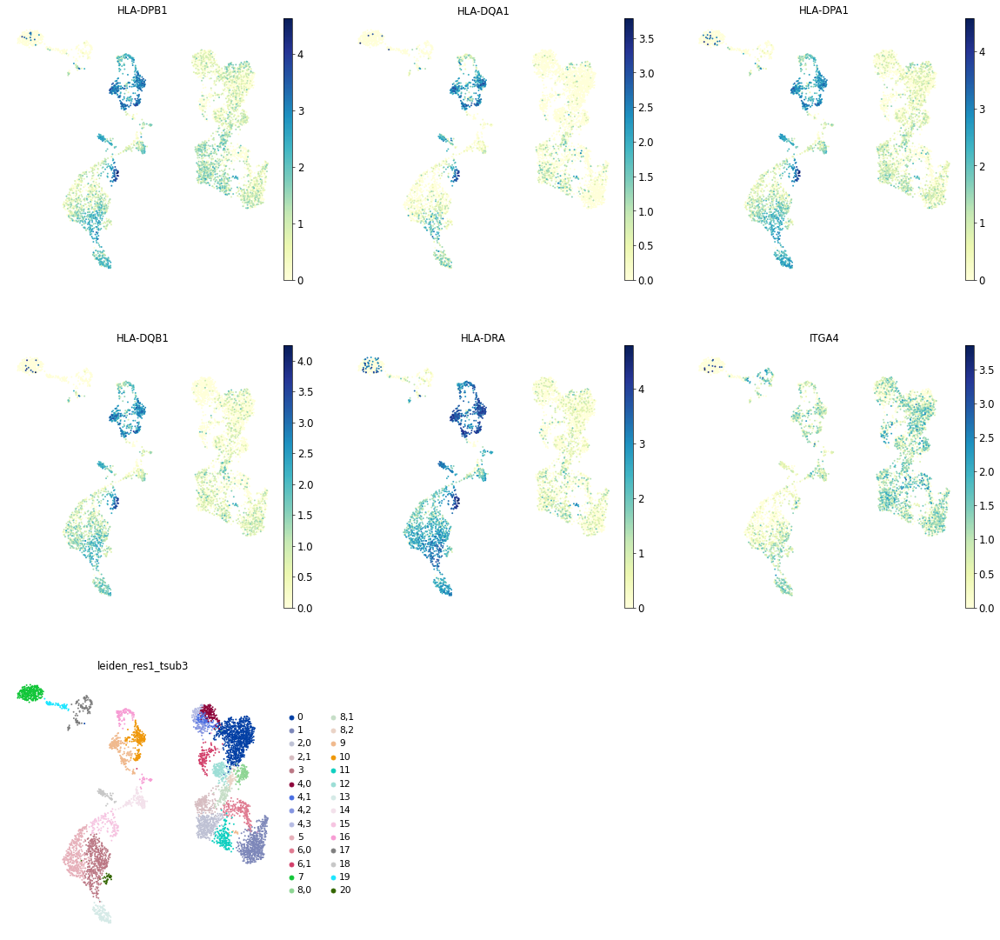

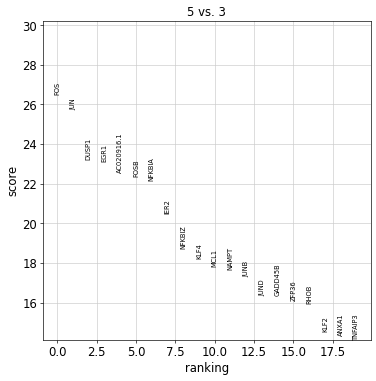

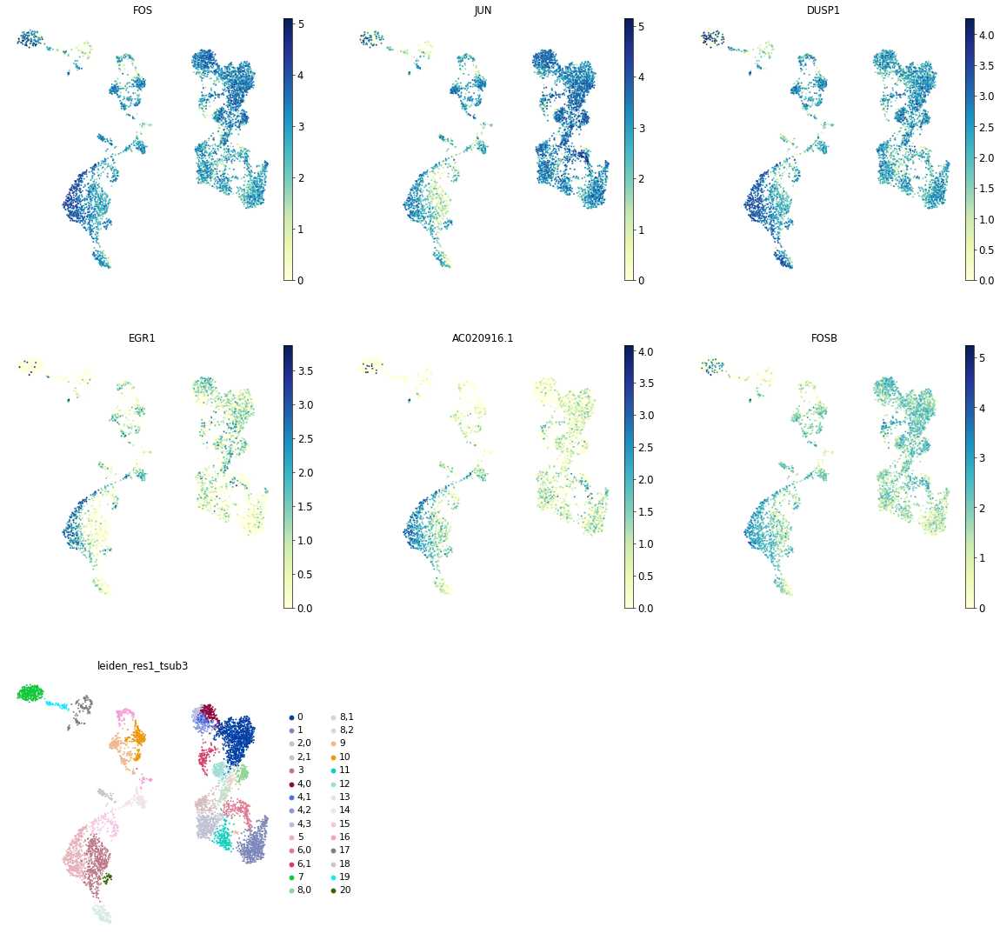

In [158]:
# Compare 3 to 5
sc.tl.rank_genes_groups(adata_gex, groupby=new_key, key_added='test_comp', groups=['3'], reference='5')
sc.pl.rank_genes_groups(adata_gex, key='test_comp', groups=['3'], ncols=3)
top_6_genes = list(adata_gex.uns['test_comp']['names']['3'][:6])
sc.pl.umap(adata_gex, color=top_6_genes+[new_key], ncols=3)

sc.tl.rank_genes_groups(adata_gex, groupby=new_key, key_added='test_comp', groups=['5'], reference='3')
sc.pl.rank_genes_groups(adata_gex, key='test_comp', groups=['5'], ncols=3)
top_6_genes = list(adata_gex.uns['test_comp']['names']['5'][:6])
sc.pl.umap(adata_gex, color=top_6_genes+[new_key], ncols=3)


#### Summary

One is just a stressed version of the other, but we have been calling this ID2-hi myeloid prog, so let's stick with it:
- 3: CD14+ Mono
- 5: ID2-hi myeloid prog

## Erythrocyte lineage

### Cluster 17

In [159]:
orig_key = 'leiden_res1_tsub3'
new_key = 'leiden_res1_erysub'
new_rg_key = 'rg_res1_erysub'
sub_key = '17'

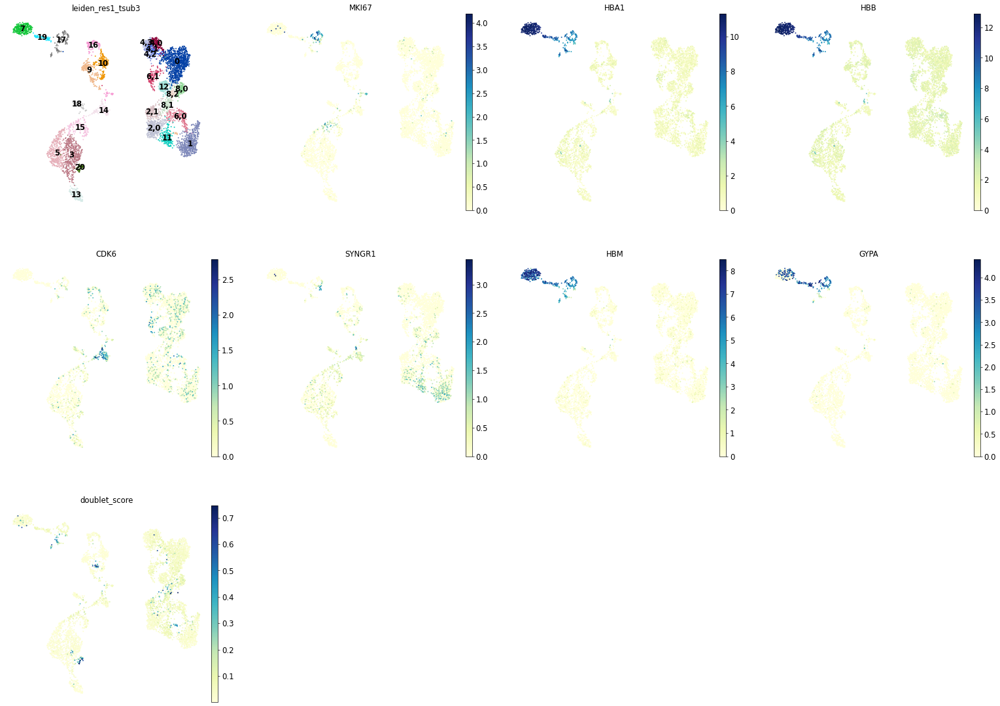

In [160]:
m_genes1 = marker_genes['Erythroblast']+marker_genes['Proerythroblast']
#m_genes2 = marker_genes['cDC2']
sc.pl.umap(adata_gex, color=[orig_key]+m_genes1+['doublet_score'], legend_loc = 'on data')

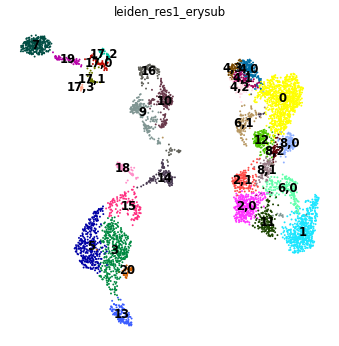

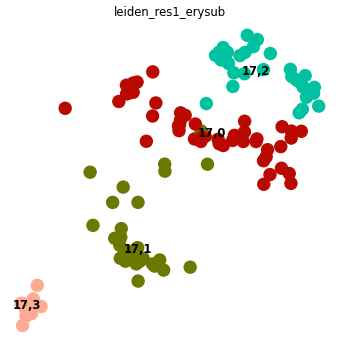

0       867
1       554
3       425
5       351
2,0     320
7       286
9       213
10      210
6,0     201
11      174
4,0     167
12      167
2,1     164
13      137
14      136
15      127
16      120
6,1     116
8,0     116
8,1     107
4,1      94
4,2      74
18       72
4,3      61
19       57
8,2      53
17,0     46
20       34
17,2     30
17,1     30
17,3     10
Name: leiden_res1_erysub, dtype: int64

In [161]:
res = 0.35
sc.tl.leiden(adata_gex, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)
sc.pl.umap(adata_gex, color=new_key, legend_loc='on data')
sc.pl.umap(adata_gex[adata_gex.obs[orig_key].isin([sub_key])], color=new_key, legend_loc='on data')

adata_gex.obs[new_key].value_counts()

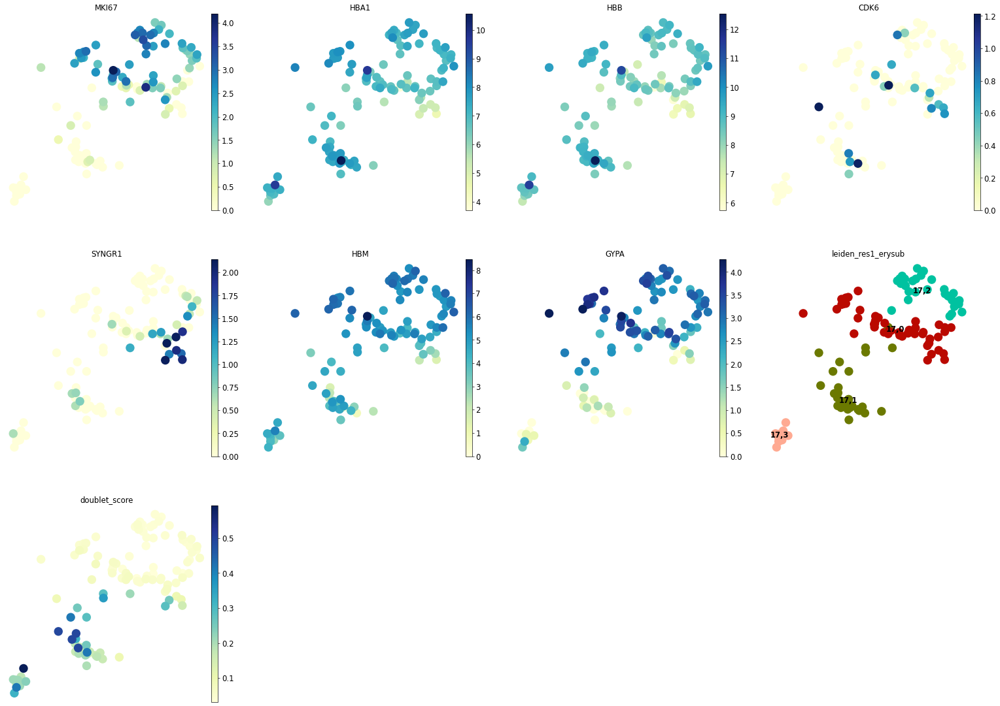

In [162]:
sc.pl.umap(adata_gex[adata_gex.obs[orig_key].isin([sub_key])], color=m_genes1+[new_key, 'doublet_score'], legend_loc='on data')


#### Subcluster 17,0

In [163]:
orig_key = 'leiden_res1_erysub'
new_key = 'leiden_res1_erysub2'
new_rg_key = 'rg_res1_erysub2'
sub_key = '17,0'

Trying to set attribute `.uns` of view, copying.


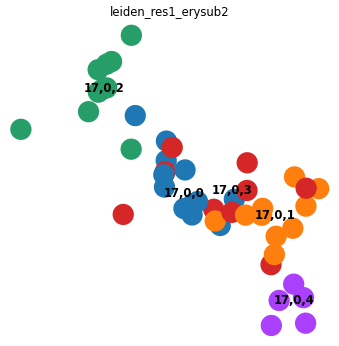

0         867
1         554
3         425
5         351
2,0       320
7         286
9         213
10        210
6,0       201
11        174
4,0       167
12        167
2,1       164
13        137
14        136
15        127
16        120
6,1       116
8,0       116
8,1       107
4,1        94
4,2        74
18         72
4,3        61
19         57
8,2        53
20         34
17,1       30
17,2       30
17,0,0     12
17,0,1     10
17,0,2     10
17,3       10
17,0,3      9
17,0,4      5
Name: leiden_res1_erysub2, dtype: int64

In [164]:
res = 0.9
sc.tl.leiden(adata_gex, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)
#sc.pl.umap(adata_gex, color=new_key, legend_loc='on data')
sc.pl.umap(adata_gex[adata_gex.obs[orig_key].isin([sub_key])], color=new_key, legend_loc='on data')

adata_gex.obs[new_key].value_counts()

Trying to set attribute `.uns` of view, copying.


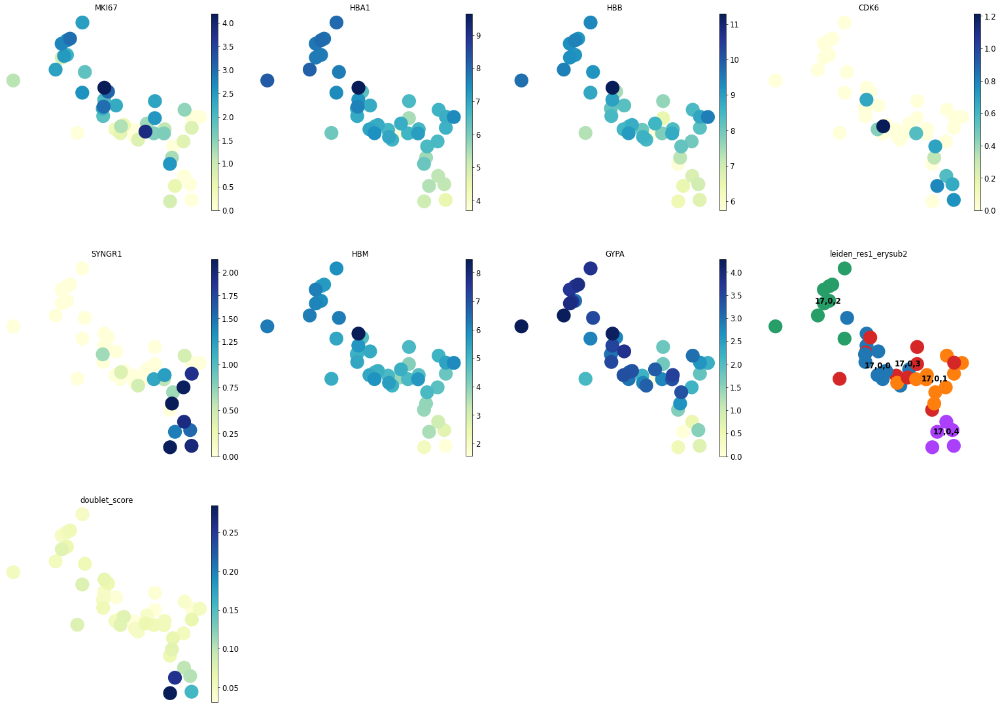

In [165]:
sc.pl.umap(adata_gex[adata_gex.obs[orig_key].isin([sub_key])], color=m_genes1+[new_key, 'doublet_score'], legend_loc='on data')


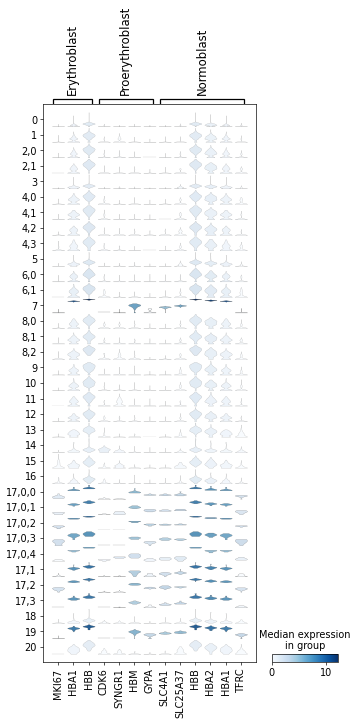

In [166]:
sc.pl.stacked_violin(adata_gex, var_names={a:marker_genes[a] for a in ['Erythroblast', 'Proerythroblast', 'Normoblast']}, groupby=new_key)

#### Summary:
- 17,0,0: Erythroblast
- 17,0,1: Proerythroblast
- 17,0,2: Erythroblast
- 17,0,3: Erythroblast
- 17,0,4: Proerythroblast
- 17,1: doublets
- 17,2: Erythroblast
- 17,3: doublets



## B cells

### Cluster 9

In [167]:
orig_key = 'leiden_res1_erysub2'
new_key = 'leiden_res1_bsub'
new_rg_key = 'rg_res1_bsub'
sub_key = '9'

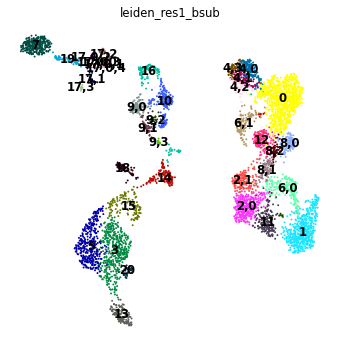

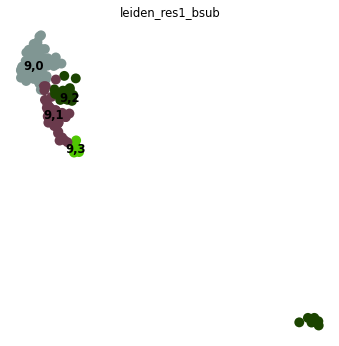

0         867
1         554
3         425
5         351
2,0       320
7         286
10        210
6,0       201
11        174
4,0       167
12        167
2,1       164
13        137
14        136
15        127
16        120
9,0       117
6,1       116
8,0       116
8,1       107
4,1        94
4,2        74
18         72
4,3        61
9,1        59
19         57
8,2        53
20         34
17,1       30
17,2       30
9,2        27
17,0,0     12
17,0,1     10
17,0,2     10
17,3       10
9,3        10
17,0,3      9
17,0,4      5
Name: leiden_res1_bsub, dtype: int64

In [168]:
res = 0.25
sc.tl.leiden(adata_gex, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)
sc.pl.umap(adata_gex, color=new_key, legend_loc='on data')
sc.pl.umap(adata_gex[adata_gex.obs[orig_key].isin([sub_key])], color=new_key, legend_loc='on data')

adata_gex.obs[new_key].value_counts()

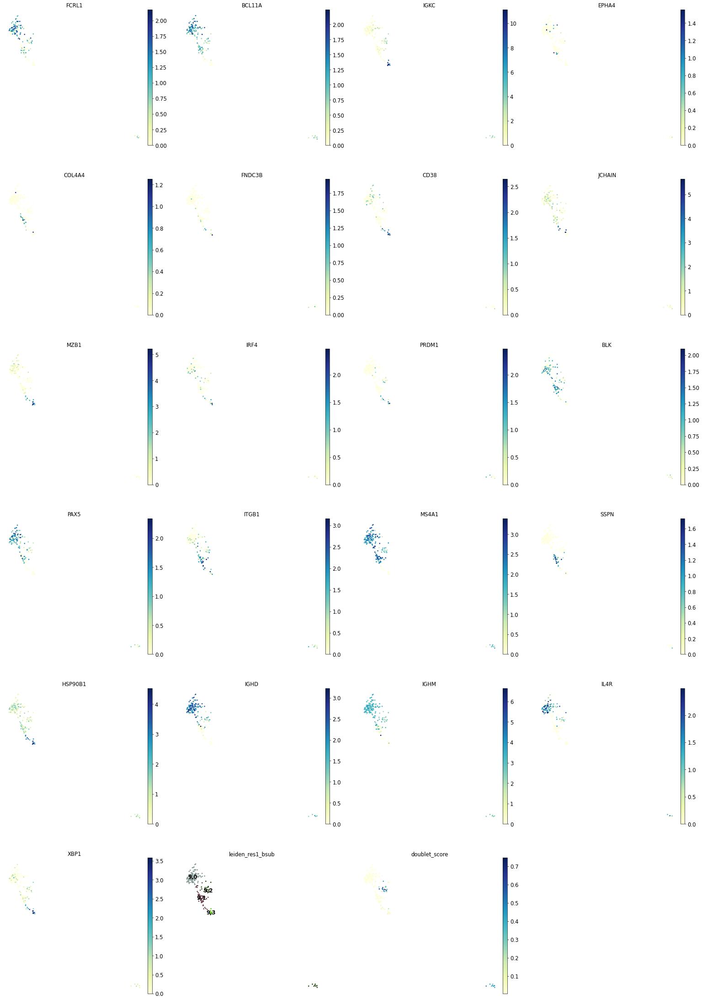

In [169]:
markers_b = marker_genes['Naive CD20+ B - IGKC-']+marker_genes['Plasma cell']+marker_genes['B1 B - IGKC-']
markers_b = [str(b) for b in adata_gex.var_names if str(b) in markers_b]
sc.pl.umap(adata_gex[adata_gex.obs[orig_key].isin([sub_key])], color=markers_b+[new_key, 'doublet_score'], legend_loc='on data', size=40)


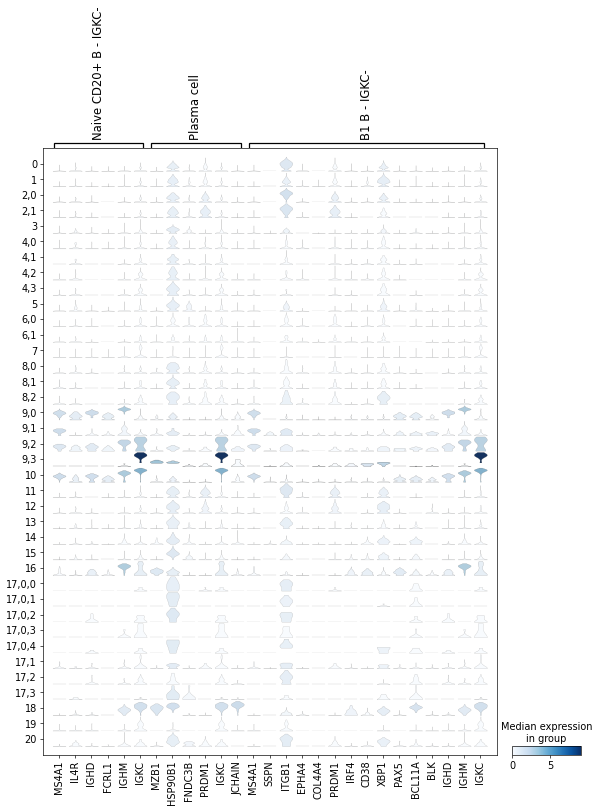

In [170]:
marker_genes_sub = {a:marker_genes[a] for a in ['Naive CD20+ B - IGKC-', 'Plasma cell', 'B1 B - IGKC-']}
marker_genes_to_plot = dict()

for key,val in marker_genes_sub.items():
    if 'ZNF215' in val:
        val.remove('ZNF215')
    marker_genes_to_plot[key] = val

del marker_genes_sub

sc.pl.stacked_violin(adata_gex, var_names=marker_genes_to_plot, groupby=new_key)

#### Summary

- 9,0: Naive CD20+ B - IGKC-
- 9,1: B1 B - IGKC-
- 9,2: doublets
- 9,3: Plasma cell

### Cluster 10

In [171]:
orig_key = 'leiden_res1_bsub'
new_key = 'leiden_res1_bsub2'
new_rg_key = 'rg_res1_bsub2'
sub_key = '10'

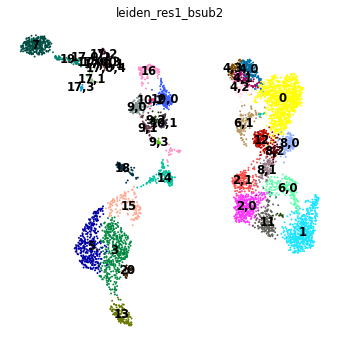

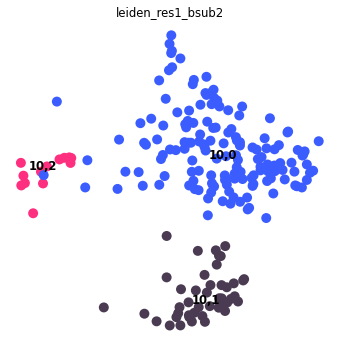

0         867
1         554
3         425
5         351
2,0       320
7         286
6,0       201
11        174
4,0       167
12        167
2,1       164
10,0      153
13        137
14        136
15        127
16        120
9,0       117
8,0       116
6,1       116
8,1       107
4,1        94
4,2        74
18         72
4,3        61
9,1        59
19         57
8,2        53
10,1       44
20         34
17,1       30
17,2       30
9,2        27
10,2       13
17,0,0     12
17,3       10
17,0,2     10
17,0,1     10
9,3        10
17,0,3      9
17,0,4      5
Name: leiden_res1_bsub2, dtype: int64

In [172]:
res = 0.25
sc.tl.leiden(adata_gex, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)
sc.pl.umap(adata_gex, color=new_key, legend_loc='on data')
sc.pl.umap(adata_gex[adata_gex.obs[orig_key].isin([sub_key])], color=new_key, legend_loc='on data')

adata_gex.obs[new_key].value_counts()

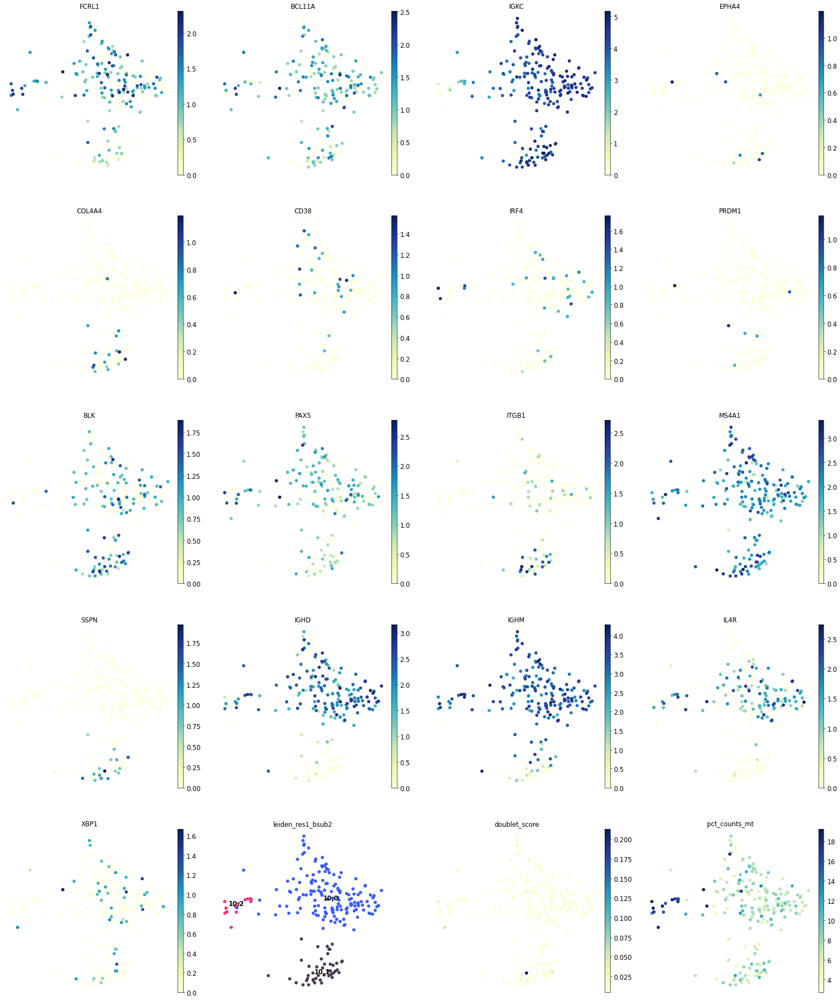

In [173]:
markers_b = marker_genes['Naive CD20+ B - IGKC+']+marker_genes['B1 B - IGKC+']
markers_b = [str(b) for b in adata_gex.var_names if str(b) in markers_b]
sc.pl.umap(adata_gex[adata_gex.obs[orig_key].isin([sub_key])], color=markers_b+[new_key, 'doublet_score', 'pct_counts_mt'], legend_loc='on data', size=200)


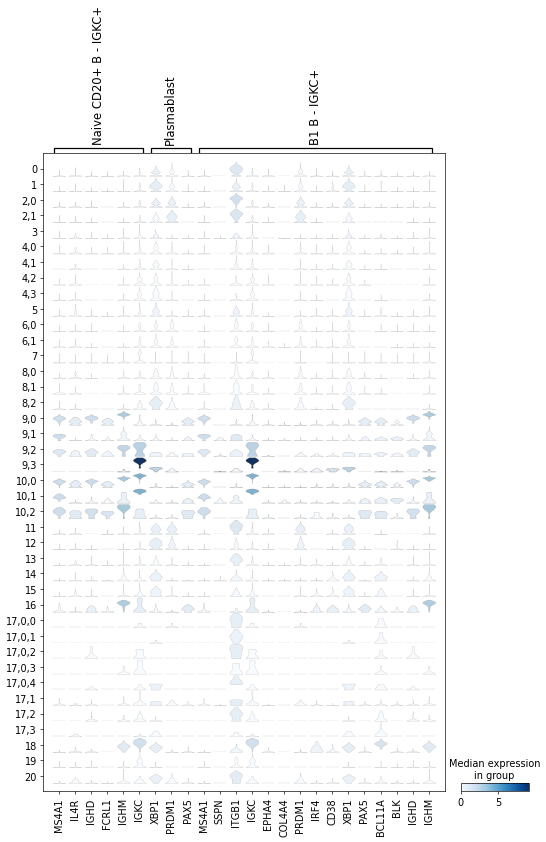

In [174]:
marker_genes_sub = {a:marker_genes[a] for a in ['Naive CD20+ B - IGKC+', 'Plasmablast', 'B1 B - IGKC+']}
marker_genes_to_plot = dict()

for key,val in marker_genes_sub.items():
    if 'ZNF215' in val:
        val.remove('ZNF215')
    marker_genes_to_plot[key] = val

del marker_genes_sub

sc.pl.stacked_violin(adata_gex, var_names=marker_genes_to_plot, groupby=new_key)

#### Summary

- 10,0: Naive CD20+ B - IGKC-
- 10,1: B1 B - IGKC-
- 10,2: low Q B

## Stem and progenitors

### Cluster 14

In [175]:
orig_key = 'leiden_res1_bsub2'
new_key = 'leiden_res1_progsub'
new_rg_key = 'rg_res1_progsub'
sub_key = '14'

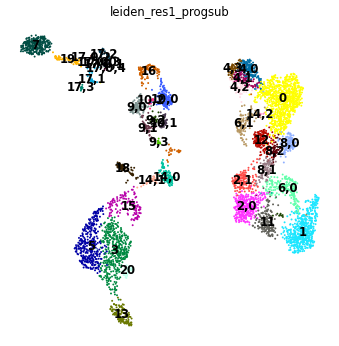

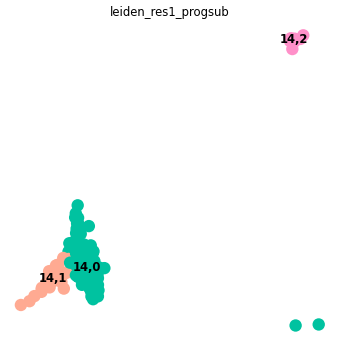

0         867
1         554
3         425
5         351
2,0       320
7         286
6,0       201
11        174
4,0       167
12        167
2,1       164
10,0      153
13        137
15        127
16        120
9,0       117
8,0       116
6,1       116
8,1       107
14,0       96
4,1        94
4,2        74
18         72
4,3        61
9,1        59
19         57
8,2        53
10,1       44
20         34
14,1       32
17,1       30
17,2       30
9,2        27
10,2       13
17,0,0     12
17,0,1     10
17,0,2     10
17,3       10
9,3        10
17,0,3      9
14,2        8
17,0,4      5
Name: leiden_res1_progsub, dtype: int64

In [176]:
res = 0.25
sc.tl.leiden(adata_gex, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)
sc.pl.umap(adata_gex, color=new_key, legend_loc='on data')
sc.pl.umap(adata_gex[adata_gex.obs[orig_key].isin([sub_key])], color=new_key, legend_loc='on data')

adata_gex.obs[new_key].value_counts()

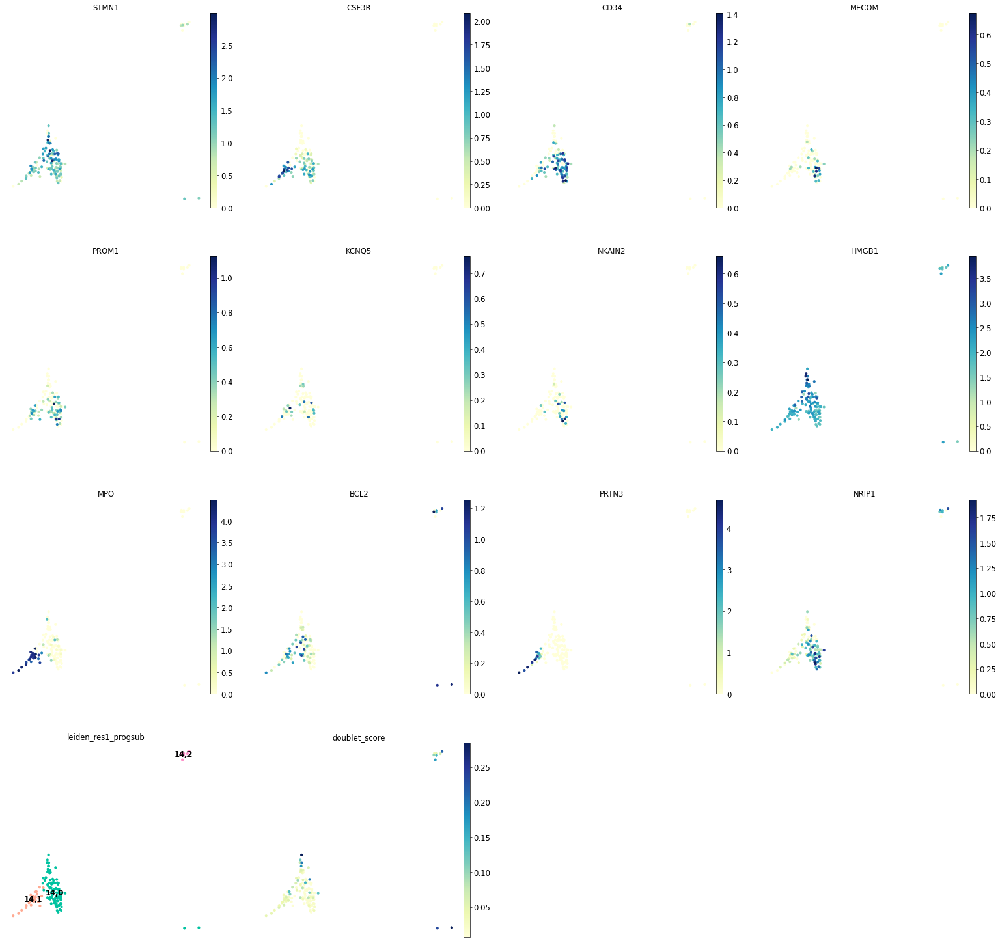

In [177]:
markers_b = marker_genes['HSC']+marker_genes['G/M prog']+marker_genes['HSPC STMN1+']
markers_b = [str(b) for b in adata_gex.var_names if str(b) in markers_b]
sc.pl.umap(adata_gex[adata_gex.obs[orig_key].isin([sub_key])], color=markers_b+[new_key, 'doublet_score'], legend_loc='on data', size=100)


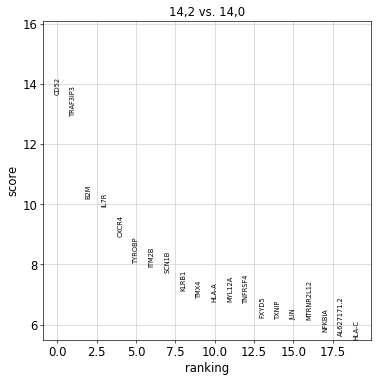

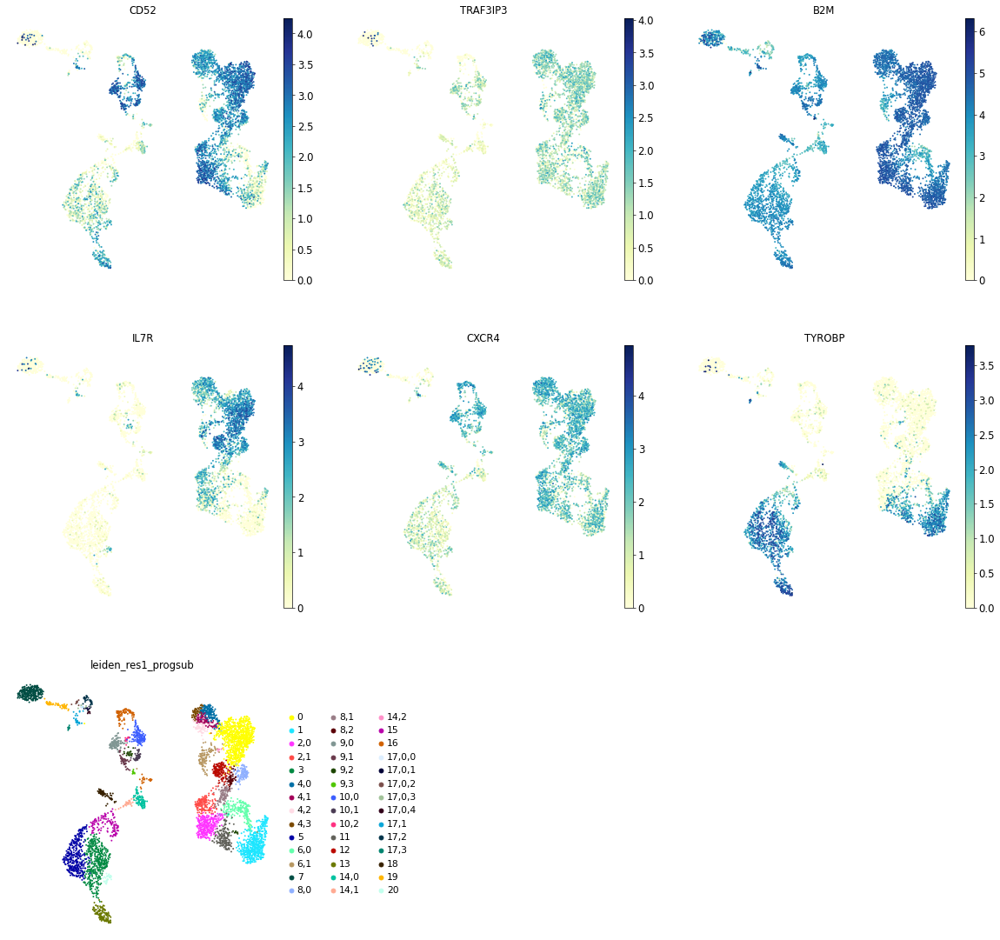

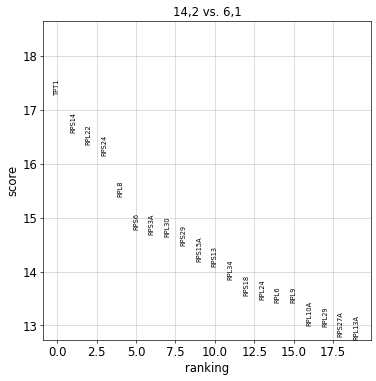

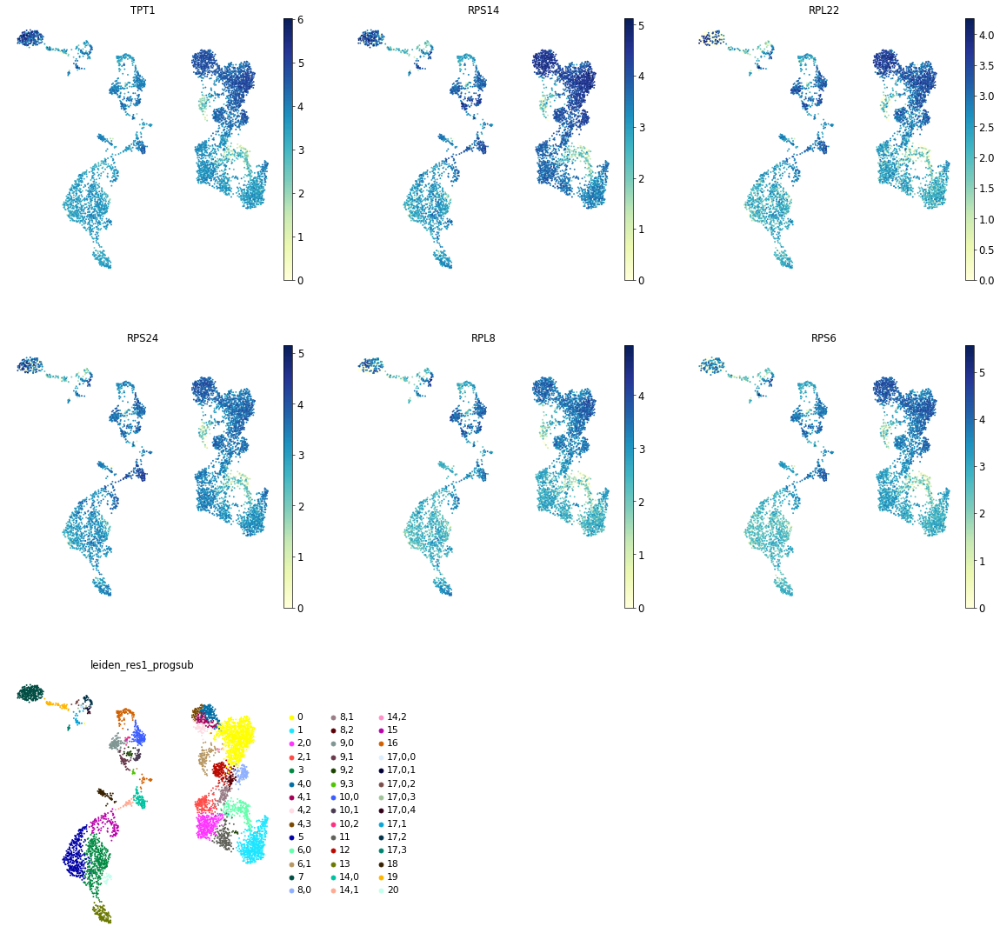

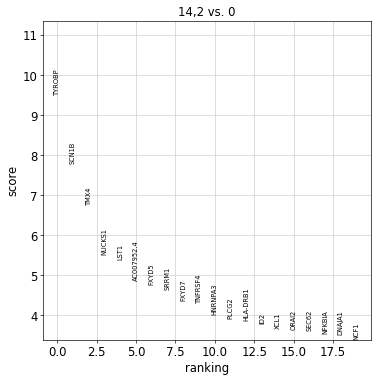

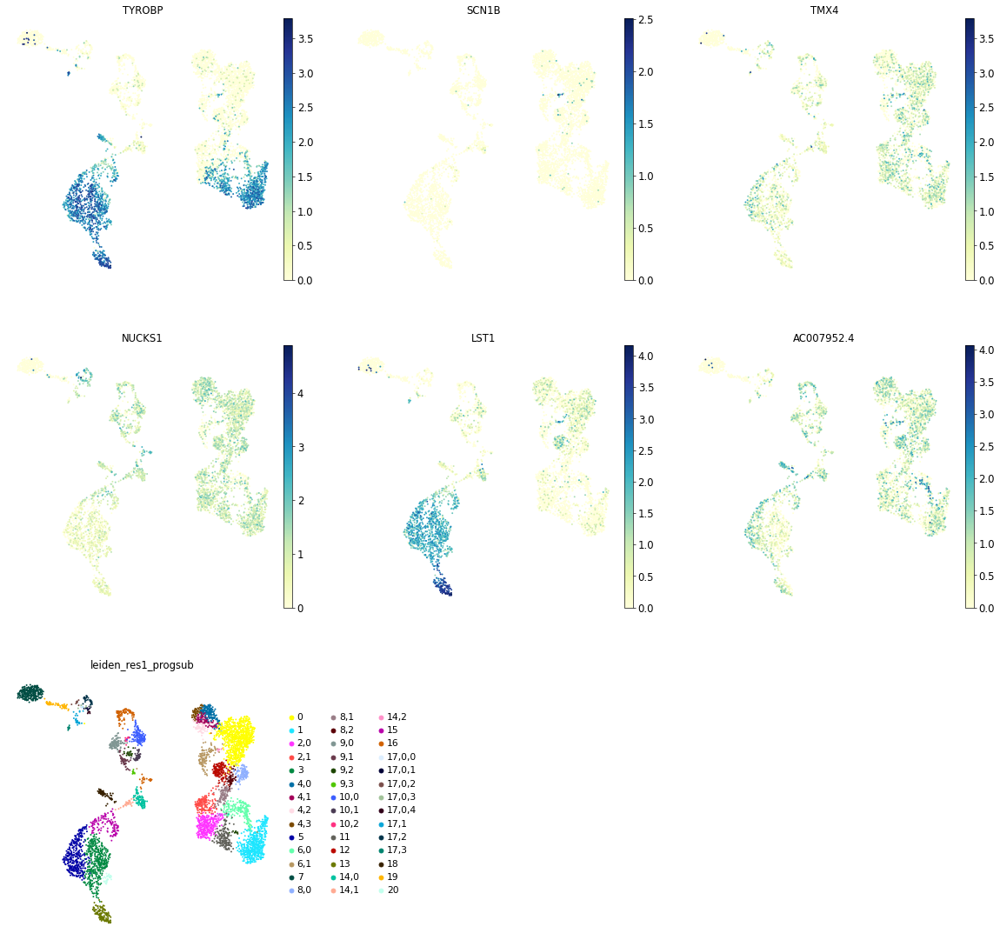

In [178]:
# Compare 14,2 to neighbouring clusters
sc.tl.rank_genes_groups(adata_gex, groupby=new_key, key_added='test_comp', groups=['14,2'], reference='14,0')
sc.pl.rank_genes_groups(adata_gex, key='test_comp', groups=['14,2'], ncols=3)
top_6_genes = list(adata_gex.uns['test_comp']['names']['14,2'][:6])
sc.pl.umap(adata_gex, color=top_6_genes+[new_key], ncols=3)

sc.tl.rank_genes_groups(adata_gex, groupby=new_key, key_added='test_comp', groups=['14,2'], reference='6,1')
sc.pl.rank_genes_groups(adata_gex, key='test_comp', groups=['14,2'], ncols=3)
top_6_genes = list(adata_gex.uns['test_comp']['names']['14,2'][:6])
sc.pl.umap(adata_gex, color=top_6_genes+[new_key], ncols=3)

sc.tl.rank_genes_groups(adata_gex, groupby=new_key, key_added='test_comp', groups=['14,2'], reference='0')
sc.pl.rank_genes_groups(adata_gex, key='test_comp', groups=['14,2'], ncols=3)
top_6_genes = list(adata_gex.uns['test_comp']['names']['14,2'][:6])
sc.pl.umap(adata_gex, color=top_6_genes+[new_key], ncols=3)

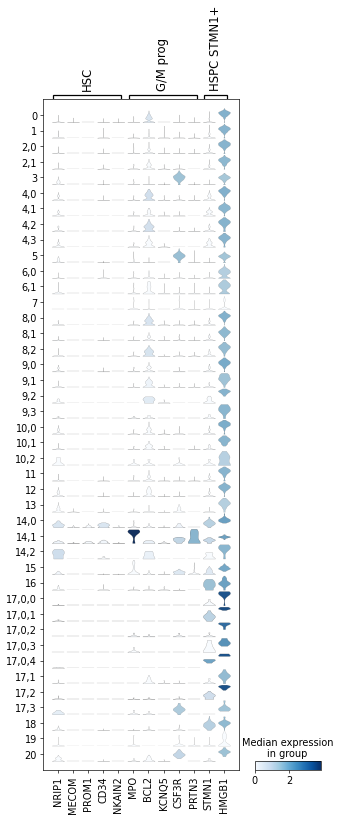

In [179]:
sc.pl.stacked_violin(adata_gex, var_names={a:marker_genes[a] for a in ['HSC', 'G/M prog', 'HSPC STMN1+']}, groupby=new_key)

#### Summary

- 14,0: HSC
- 14,1: G/M prog
- 14,2: low quality/doublet

### Cluster 15

In [180]:
orig_key = 'leiden_res1_progsub'
new_key = 'leiden_res1_progsub2'
new_rg_key = 'rg_res1_progsub2'
sub_key = '15'

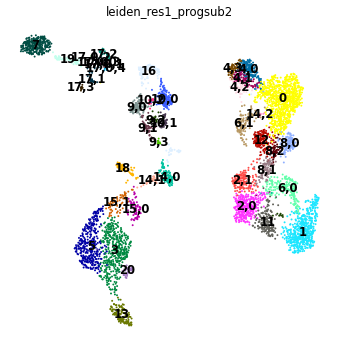

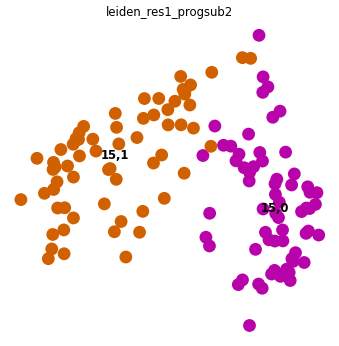

0         867
1         554
3         425
5         351
2,0       320
7         286
6,0       201
11        174
12        167
4,0       167
2,1       164
10,0      153
13        137
16        120
9,0       117
6,1       116
8,0       116
8,1       107
14,0       96
4,1        94
4,2        74
18         72
15,0       64
15,1       63
4,3        61
9,1        59
19         57
8,2        53
10,1       44
20         34
14,1       32
17,1       30
17,2       30
9,2        27
10,2       13
17,0,0     12
17,0,1     10
17,0,2     10
17,3       10
9,3        10
17,0,3      9
14,2        8
17,0,4      5
Name: leiden_res1_progsub2, dtype: int64

In [181]:
res = 0.2
sc.tl.leiden(adata_gex, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)
sc.pl.umap(adata_gex, color=new_key, legend_loc='on data')
sc.pl.umap(adata_gex[adata_gex.obs[orig_key].isin([sub_key])], color=new_key, legend_loc='on data')

adata_gex.obs[new_key].value_counts()

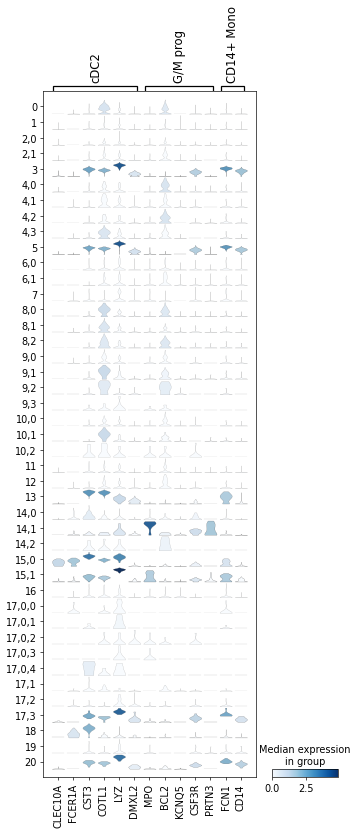

In [182]:
sc.pl.stacked_violin(adata_gex, var_names={a:marker_genes[a] for a in ['cDC2', 'G/M prog', 'CD14+ Mono']}, groupby=new_key)

#### Summary

- 15,0: cDC2
- 15,1: G/M prog

### Cluster 16

In [183]:
orig_key = 'leiden_res1_progsub2'
new_key = 'leiden_res1_progsub3'
new_rg_key = 'rg_res1_progsub3'
sub_key = '16'

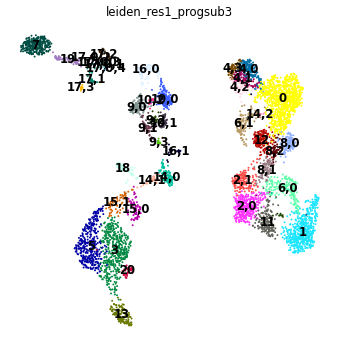

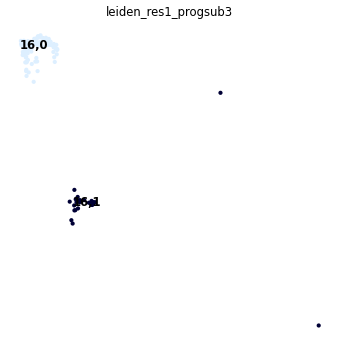

0         867
1         554
3         425
5         351
2,0       320
7         286
6,0       201
11        174
4,0       167
12        167
2,1       164
10,0      153
13        137
9,0       117
6,1       116
8,0       116
8,1       107
14,0       96
4,1        94
16,0       92
4,2        74
18         72
15,0       64
15,1       63
4,3        61
9,1        59
19         57
8,2        53
10,1       44
20         34
14,1       32
17,1       30
17,2       30
16,1       28
9,2        27
10,2       13
17,0,0     12
17,0,1     10
17,0,2     10
17,3       10
9,3        10
17,0,3      9
14,2        8
17,0,4      5
Name: leiden_res1_progsub3, dtype: int64

In [184]:
res = 0.15
sc.tl.leiden(adata_gex, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)
sc.pl.umap(adata_gex, color=new_key, legend_loc='on data')
sc.pl.umap(adata_gex[adata_gex.obs[orig_key].isin([sub_key])], color=new_key, legend_loc='on data', size=100)

adata_gex.obs[new_key].value_counts()

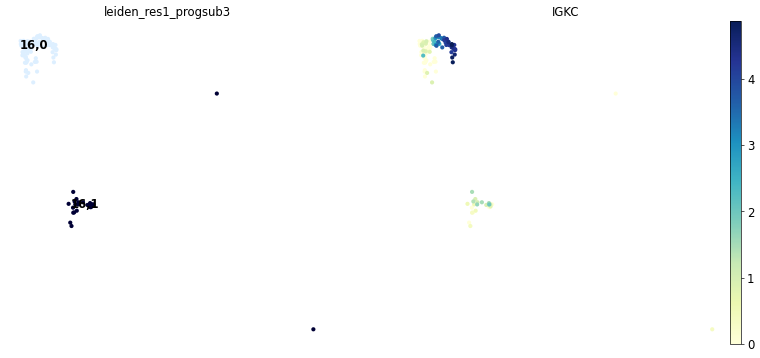

In [185]:
sc.pl.umap(adata_gex[adata_gex.obs[orig_key].isin([sub_key])], color=[new_key, 'IGKC'], legend_loc='on data', size=100)


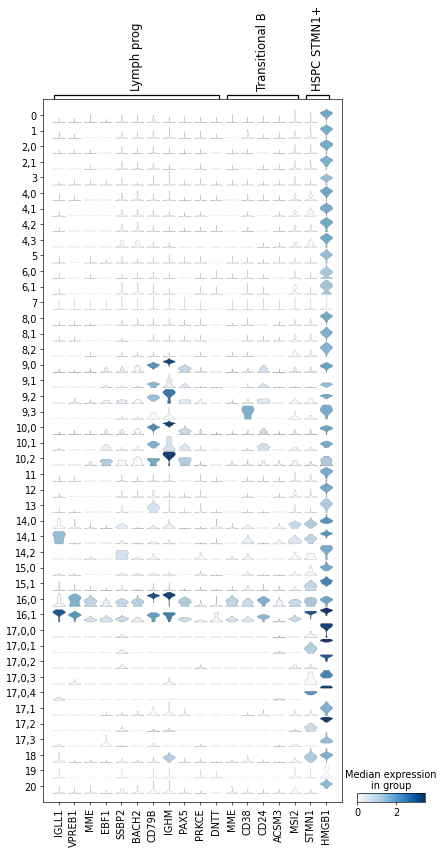

In [186]:
sc.pl.stacked_violin(adata_gex, var_names={a:marker_genes[a] for a in ['Lymph prog', 'Transitional B', 'HSPC STMN1+']}, groupby=new_key)

#### Summary

- 16,0: Transitional B
- 16,1: Lymph prog

## Cluster dictionary

In [190]:
rename_clust_dict = {
    '0': 'CD4+ T activated',
    '1': 'NK',
    '2,0': 'Effector CD8+ T',
    '2,1': 'Effector CD4+ T',
    '3': 'CD14+ Mono',
    '4,0': 'CD4+ T naive',
    '4,1': 'CD4+ T naive',
    '4,2': 'CD4+ T naive',
    '4,3': 'CD8+ T naive',
    '5': 'ID2-hi myeloid prog',
    '6,0': 'ILC',
    '6,1': 'doublets',
    '7': 'Reticulocyte',
    '8': 'CD8+ T GZMK+ CD161+',
    '8,0': 'CD8+ T early activation',
    '8,1': 'CD8+ T CCL4+ GZMK+ TRDC+',
    '8,2': 'gdT TRDC+ GZMK+ IL7R+',
    '9,0': 'Naive CD20+ B - IGKC-',
    '9,1': 'B1 B - IGKC-',
    '9,2': 'doublets',
    '9,3': 'Plasma cell',
    '10,0': 'Naive CD20+ B - IGKC+',
    '10,1': 'B1 B - IGKC+',
    '10,2': 'low Q B',
    '11': 'gdT',
    '12': 'MAIT',
    '13': 'CD16+ Mono',
    '14,0': 'HSC',
    '14,1': 'G/M prog',
    '14,2': 'low quality/doublet',
    '15,0': 'cDC2',
    '15,1': 'G/M prog',
    '16,0': 'Transitional B',
    '16,1': 'Lymph prog',
    '17,0,0': 'Erythroblast',
    '17,0,1': 'Proerythroblast',
    '17,0,2': 'Erythroblast',
    '17,0,3': 'Erythroblast',
    '17,0,4': 'Proerythroblast',
    '17,1': 'doublets',
    '17,2': 'Erythroblast',
    '17,3': 'doublets',
    '18': 'pDC',
    '19': 'Normoblast',
    '20': 'doublets'   
}

# Cluster overview

In [191]:
adata_gex.obs['leiden_final'] = adata_gex.obs[new_key].map(rename_clust_dict)

... storing 'leiden_final' as categorical


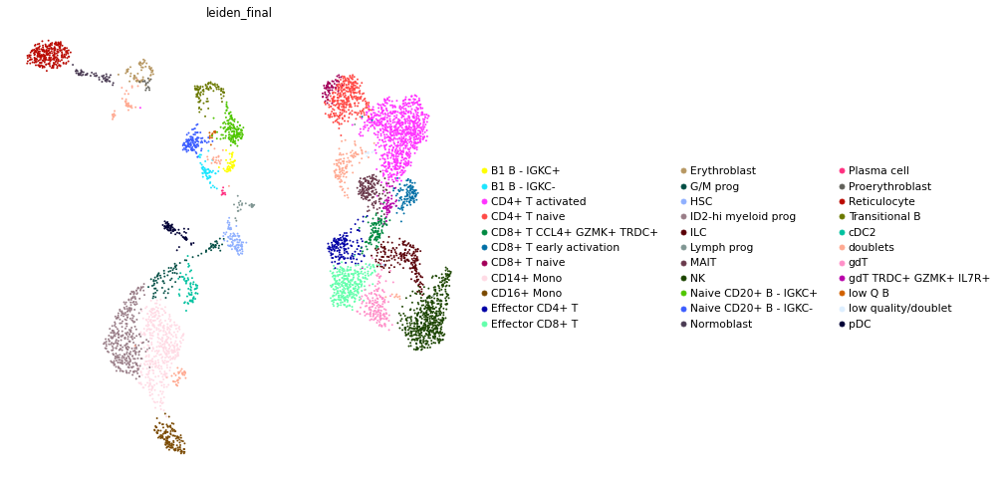

In [192]:
plt.rcParams['figure.figsize'] = (10,10)
sc.pl.umap(adata_gex, color='leiden_final')
plt.rcParams['figure.figsize'] = (7,7)

## Doublet and lowQ filtering

In [193]:
adata_gex

AnnData object with n_obs × n_vars = 5519 × 15508
    obs: 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'n_counts', 'n_genes', 'size_factors', 'S_score', 'G2M_score', 'phase', 'leiden_res0.3', 'leiden_res0.5', 'leiden_res0.8', 'leiden_res1', 'doublet_score', 'predicted_doublet', 'leiden_res1_tsub', 'leiden_res1_tsub2', 'leiden_res1_ilcsub', 'leiden_res1_erysub', 'leiden_res1_erysub2', 'leiden_res1_bsub', 'leiden_res1_bsub2', 'leiden_res1_progsub', 'leiden_res1_progsub2', 'leiden_res1_progsub3', 'leiden_final', 'leiden_res1_tsub3'
    var: 'gene_ids', 'feature_types', 'genome', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersion

In [194]:
adata_gex.obs['leiden_final'].value_counts()

CD4+ T activated            867
NK                          554
CD14+ Mono                  425
ID2-hi myeloid prog         351
CD4+ T naive                335
Effector CD8+ T             320
Reticulocyte                286
doublets                    217
ILC                         201
gdT                         174
MAIT                        167
Effector CD4+ T             164
Naive CD20+ B - IGKC+       153
CD16+ Mono                  137
Naive CD20+ B - IGKC-       117
CD8+ T early activation     116
CD8+ T CCL4+ GZMK+ TRDC+    107
HSC                          96
G/M prog                     95
Transitional B               92
pDC                          72
cDC2                         64
Erythroblast                 61
CD8+ T naive                 61
B1 B - IGKC-                 59
Normoblast                   57
gdT TRDC+ GZMK+ IL7R+        53
B1 B - IGKC+                 44
Lymph prog                   28
Proerythroblast              15
low Q B                      13
Plasma c

In [195]:
(217+13+8)/5519   # lowQ, Doublet, prog lowQ 

0.04312375430331582

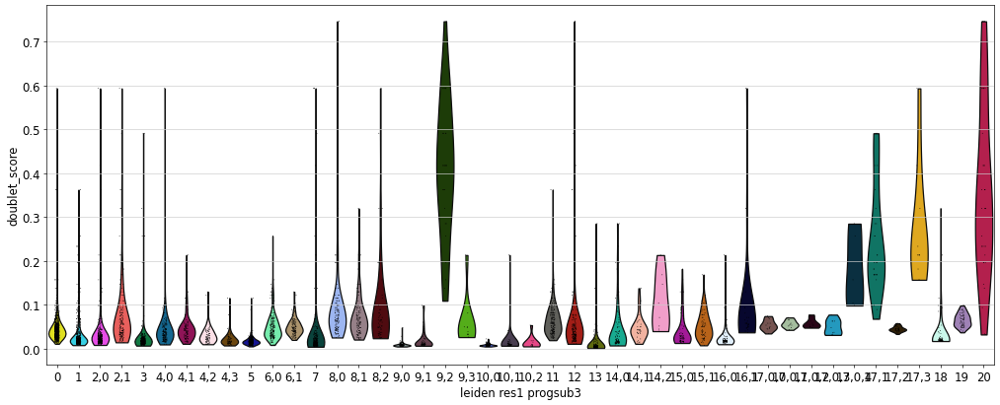

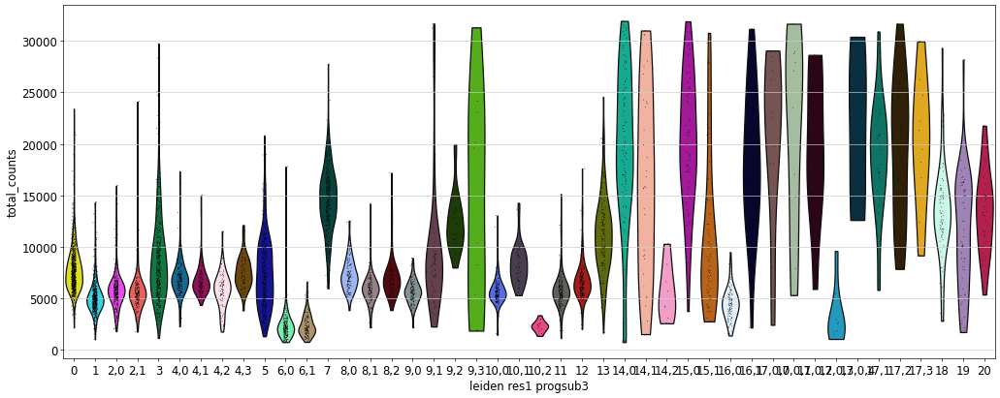

In [196]:
plt.rcParams['figure.figsize']=(16,8)
sc.pl.violin(adata_gex, keys='doublet_score', groupby=new_key)
sc.pl.violin(adata_gex, keys='total_counts', groupby=new_key)
plt.rcParams['figure.figsize']=(8,8)


Doublet clusters: Always lower expression than in their "parent" clusters; all RNA markers!
- B & T: 'CD24', 'CD22', 'ARHGAP24', 'BANK1', 'BACH2', 'AFF3', 'CD247', 'BCL11B', 'INPP4B', 'CAMK4', 'CD3D', 'TRBC2', 'IL7R'
- Erythro+others: 'HBB', 'HBA1', 'ANK1'
- Mono+B: 'PLXDC2', 'ARHGAP26', 'FCN1', 'AFF3', 'EBF1', 'BANK1', 'FCRL1', 'PAX5'
- Mono+T: 'PLXDC2', 'ARHGAP26', 'FCN1', 'BCL11B', 'SKAP1', 'CD247'

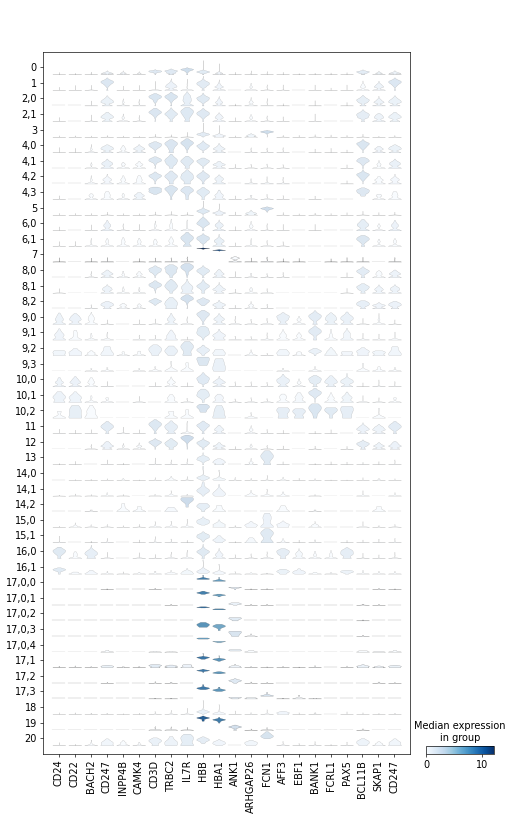

In [197]:
# Check the above markers again to make sure
sc.pl.stacked_violin(adata_gex, var_names=['CD24', 'CD22', 'BACH2', 'CD247', 'INPP4B', 'CAMK4', 'CD3D', 'TRBC2', 'IL7R', 
                                           'HBB', 'HBA1', 'ANK1', 'ARHGAP26', 'FCN1', 'AFF3', 'EBF1', 'BANK1', 'FCRL1', 'PAX5', 
                                           'BCL11B', 'SKAP1', 'CD247'], groupby=new_key)

Indeed the likely doublet clusters have broad expression of all markers, and don't express any marker more highly than any other cell cluster that is not designated as doublet.

In [198]:
adata_gex_filt = adata_gex[~adata_gex.obs['leiden_final'].isin(['low Q B', 'doublets', 'low quality/doublet'])].copy()

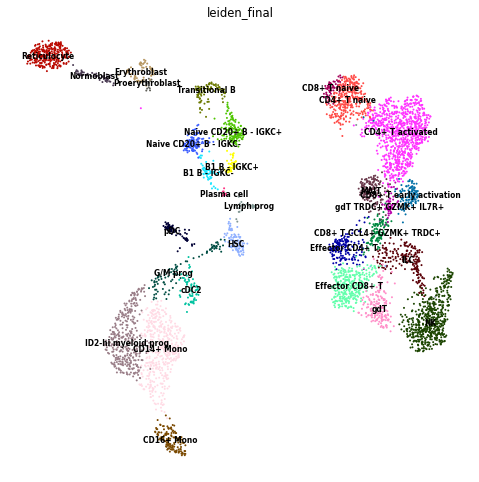

In [199]:
plt.rcParams['figure.figsize'] = (10,10)
sc.pl.umap(adata_gex_filt, color='leiden_final', legend_loc = 'on data', legend_fontsize=9)
plt.rcParams['figure.figsize'] = (7,7)

# Marker overview

In [200]:
marker_genes.keys()

dict_keys(['CD14+ Mono', 'CD16+ Mono', 'ID2-hi myeloid prog', 'cDC1', 'cDC2', 'Reticulocyte', 'Normoblast', 'Erythroblast', 'Proerythroblast', 'NK', 'ILC', 'Lymph prog', 'Naive CD20+ B - IGKC+', 'Naive CD20+ B - IGKC-', 'B1 B - IGKC+', 'B1 B - IGKC-', 'Transitional B', 'Plasma cell', 'Plasmablast', 'CD4+ T activated', 'CD4+ T naive', 'CD8+ T', 'T activation', 'T naive', 'Effector CD4+ T', 'Effector CD8+ T', 'MAIT', 'gdT', 'pDC', 'G/M prog', 'HSC', 'MK/E prog', 'HSPC STMN1+'])

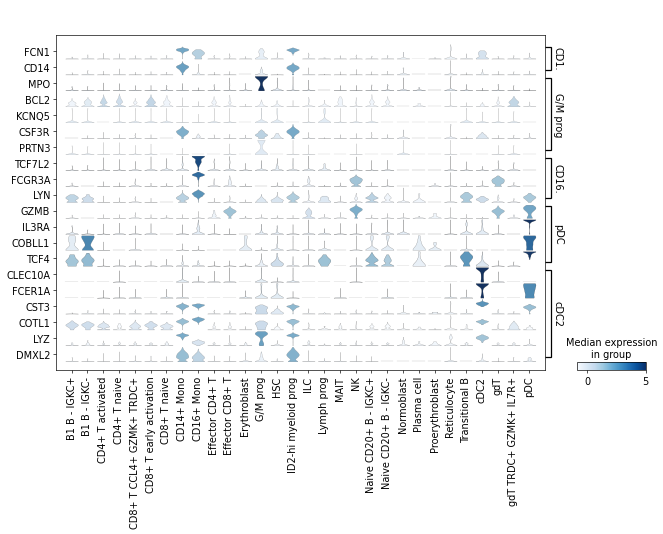

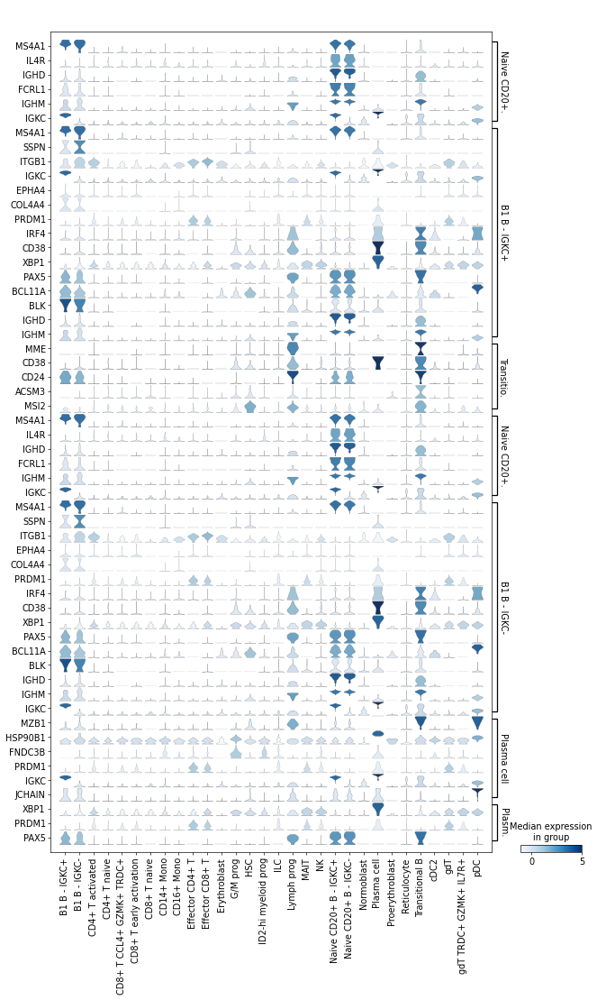

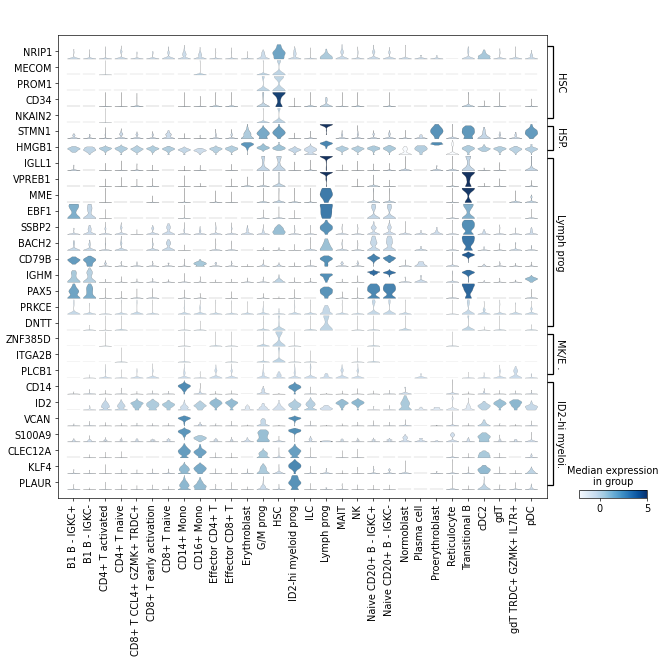

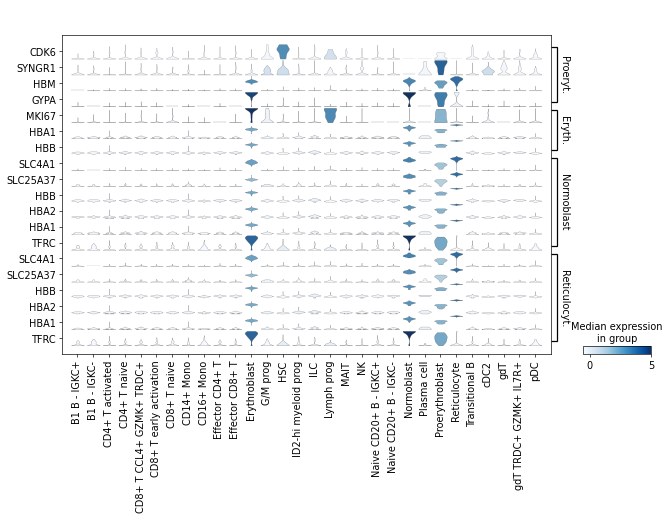

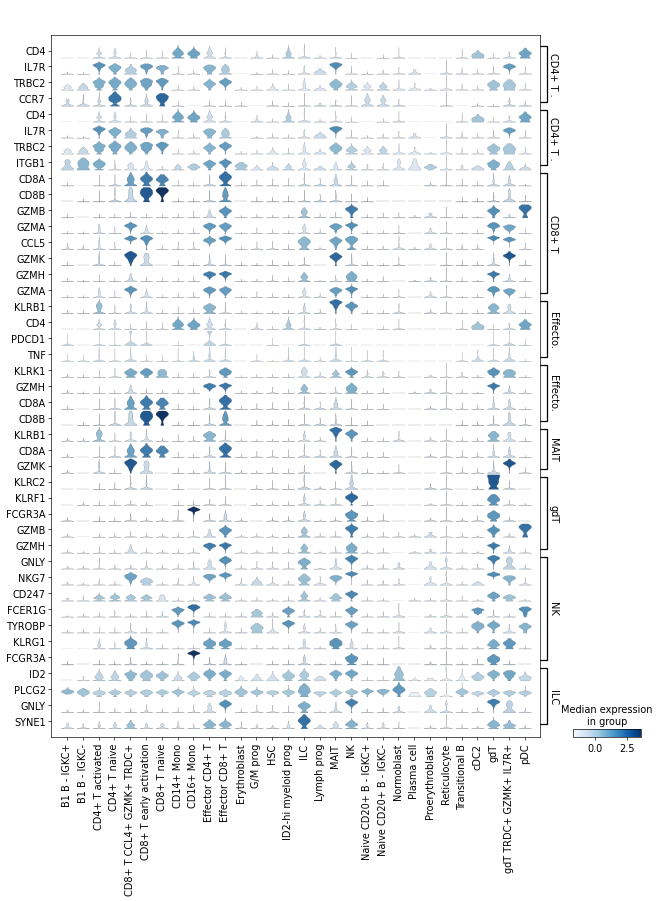

In [201]:
#Overview
adata_plot = adata_gex_filt.copy()
sc.pp.scale(adata_plot, max_value=5)

#Monocytes
sc.pl.stacked_violin(adata_plot, groupby='leiden_final', use_raw=False, swap_axes=True,                     
                     var_names={a:marker_genes[a] for a in ['CD14+ Mono', 'G/M prog', 'CD16+ Mono', 'pDC', 'cDC2']})

#B cells
sc.pl.stacked_violin(adata_plot, groupby='leiden_final', use_raw=False, swap_axes=True,                     
                     var_names={a:marker_genes[a] for a in ['Naive CD20+ B - IGKC+', 'B1 B - IGKC+', 'Transitional B', 'Naive CD20+ B - IGKC-', 'B1 B - IGKC-', 'Plasma cell', 'Plasmablast']})

#Progenitors
sc.pl.stacked_violin(adata_plot, groupby='leiden_final', use_raw=False, swap_axes=True,                     
                     var_names={a:marker_genes[a] for a in ['HSC', 'HSPC STMN1+', 'Lymph prog', 'MK/E prog', 'ID2-hi myeloid prog']})

#Erythropoiesis
sc.pl.stacked_violin(adata_plot, groupby='leiden_final', use_raw=False, swap_axes=True,                     
                     var_names={a:marker_genes[a] for a in ['Proerythroblast', 'Erythroblast','Normoblast', 'Reticulocyte']})

#T & NK cells
sc.pl.stacked_violin(adata_plot, groupby='leiden_final', use_raw=False, swap_axes=True,                     
                     var_names={a:marker_genes[a] for a in ['CD4+ T naive', 'CD4+ T activated', 'CD8+ T', 'Effector CD4+ T', 'Effector CD8+ T', 'MAIT', 'gdT', 'NK', 'ILC']})



# Write output

In [202]:
adata_gex_filt

AnnData object with n_obs × n_vars = 5281 × 15508
    obs: 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'n_counts', 'n_genes', 'size_factors', 'S_score', 'G2M_score', 'phase', 'leiden_res0.3', 'leiden_res0.5', 'leiden_res0.8', 'leiden_res1', 'doublet_score', 'predicted_doublet', 'leiden_res1_tsub', 'leiden_res1_tsub2', 'leiden_res1_ilcsub', 'leiden_res1_erysub', 'leiden_res1_erysub2', 'leiden_res1_bsub', 'leiden_res1_bsub2', 'leiden_res1_progsub', 'leiden_res1_progsub2', 'leiden_res1_progsub3', 'leiden_final', 'leiden_res1_tsub3'
    var: 'gene_ids', 'feature_types', 'genome', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersion

In [203]:
adata_gex_filt_slim = adata_gex_filt.copy()

In [204]:
adata_gex_filt_slim.obs = adata_gex_filt_slim.obs[['n_genes_by_counts', 'total_counts', 'pct_counts_mt', 'size_factors', 'phase', 'leiden_final']]

adata_gex_filt_slim.var = adata_gex_filt_slim.var[['gene_ids', 'feature_types', 'genome', 'n_cells', 'highly_variable']]

adata_gex_filt_slim.uns = {key:val for key,val in adata_gex_filt_slim.uns.items() if key in ['log1p', 'hvg', 'pca', 'neighbors', 'umap']}

In [205]:
adata_gex_filt_slim

AnnData object with n_obs × n_vars = 5281 × 15508
    obs: 'n_genes_by_counts', 'total_counts', 'pct_counts_mt', 'size_factors', 'phase', 'leiden_final'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'highly_variable'
    uns: 'log1p', 'hvg', 'pca', 'neighbors', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'distances', 'connectivities'

In [206]:
adata_gex_filt_slim.write('data/cite/proc_data/s1d2/s1d2_CITE_GEX_unmerged.h5ad')